In [21]:
#load the train data with popular tool pandas
import pandas as pd
import numpy as np
import os 
import matplotlib.pyplot as plt 
%matplotlib inline

#load the stimuli with numpy: 3D arrays
stim = np.load('input_files/stim.npy')

# df stores the response of a given neuron to a specific image (row)
# on a specific day (column)
df = pd.read_csv('input_files/train.csv')
df.index = df.Id#turn the first col to index
df = df.iloc[:,1:]#get rid of first col that is now index
df.head()

,10_1_2018_0_0,10_1_2018_0_1,11_06_18_0_0,11_06_18_0_1,11_07_18_0_0,11_07_18_1_0,11_08_18_0_0,11_08_18_0_1,11_09_18_0_1,9_17_2018_0_0,9_17_2018_0_1,9_20_2018_0_0,9_21_2018_0_0,9_21_2018_0_1,9_26_2018_0_0,9_26_2018_0_1,9_28_2018_0_0,9_28_2018_0_1
Id,,,,,,,,,,,,,,,,,,
50,6.782330,1.414214,5.622356,1.172872,3.835296,9.107331,2.928577,1.002235,0.900420,6.174053,0.500000,3.813243,2.146952,1.668328,1.976085,0.788675,6.557439,1.414214
51,8.124038,1.000000,6.561819,0.477671,2.642316,6.778426,4.691500,0.596407,1.675685,6.269141,0.333333,3.589276,2.924137,2.961930,1.932416,0.166667,6.000000,0.000000
52,8.544004,0.000000,6.707088,0.892229,1.457884,4.877056,3.632468,1.812880,0.728759,6.771823,0.804738,4.632351,2.833196,1.696923,2.354642,0.955342,4.000000,0.000000
53,8.062258,2.000000,6.980861,0.699075,4.991866,9.280055,5.040368,0.181818,2.019465,6.531085,0.166667,4.502757,2.995157,1.199359,3.094110,2.474990,8.944272,0.000000
54,8.306624,1.414214,5.663736,0.284518,3.183899,8.674227,5.017551,0.272727,1.197206,6.007232,0.166667,3.573848,2.647334,1.646386,1.009994,1.288675,6.403124,0.000000


(80, 80, 3)
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


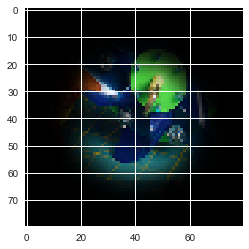

In [22]:
plt.imshow(stim[100])

# each image is an 80 x 80 pixel grid, with a 3rd dimension at each
# pixel for the RGB value.

print(stim[100].shape)
print(stim[100][:,:, 2])

### Variation Day to Day

In the first graph below, each line is a different stimuli/image.
There appears to be a clear trend in the response of the cell
day to day regardless of the stimulus. The second graph plots the average response of the cell to any stimulus on a given day. We will use this trend as part of our analysis by first subtracting out the mean for each day.


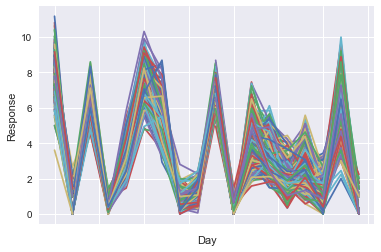

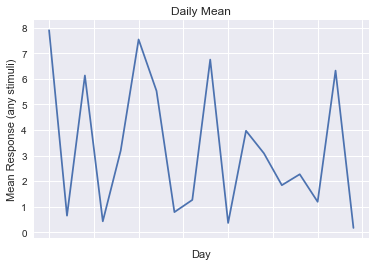

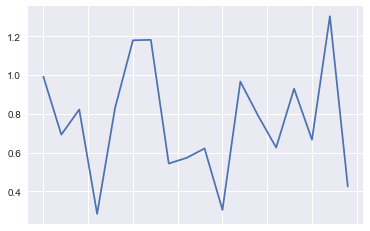

In [23]:
df.transpose().plot(legend=None)
plt.xlabel("Day")
plt.ylabel("Response")
plt.show()

day_mean = df.mean().transpose()
day_mean.plot(legend=None)
plt.xlabel("Day")
plt.ylabel("Mean Response (any stimuli)")
plt.title('Daily Mean')
plt.show()

day_std = df.std().transpose()
day_std.plot(legend=None)
plt.show()

day_max = df.max().transpose()
day_min = df.min().transpose()




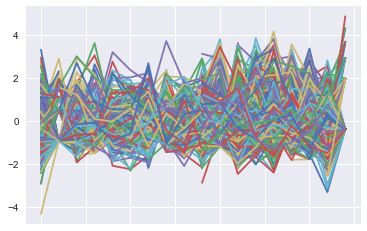

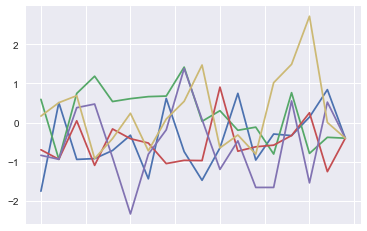

In [24]:
day_corrected_data = df.copy()

for day in day_corrected_data:
    day_corrected_data[day] -= day_mean[day]
    day_corrected_data[day] /= day_std[day]
    #day_corrected_data[day] -= day_min[day]
    #day_corrected_data[day] /= (day_max[day] - day_min[day])
    

day_corrected_data.transpose().plot(legend=None)
plt.show()

day_corrected_data.iloc[10:15].transpose().plot(legend=None)
plt.show()


# for ease of use later
dcd = day_corrected_data


### Scoping out the Stimuli

Next, we will try to see which images tend to evoke strong/weak responses, and which images tend to have lots/little variance day to day, after the daily variations in the activity have been corrected.

------------------------------------------------------------
Low mean responses


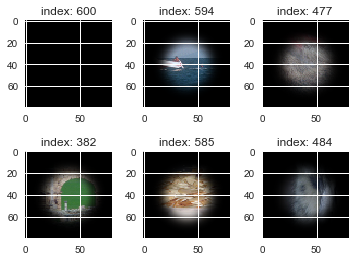

------------------------------------------------------------
High mean responses


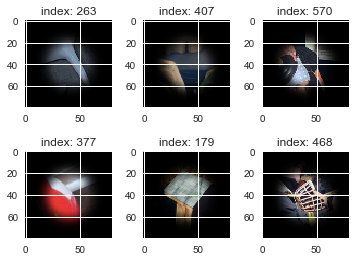

------------------------------------------------------------
Low variance responses


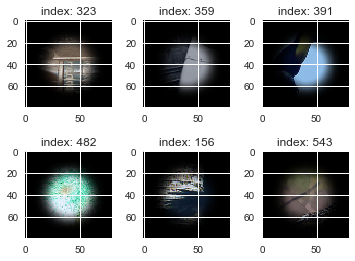

------------------------------------------------------------
High Variance responses


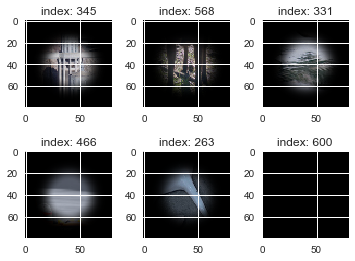

In [25]:
# list from low to high of the mean responses/variance in responses 
# over all days
sorted_means = dcd.mean(axis = 1).sort_values()
sorted_variance = dcd.var(axis = 1).sort_values()


print("-"*60)
print("Low mean responses")
plt.figure()
for i, index in enumerate(sorted_means.index[:6]):
    plt.subplot(2,3,i+1)
    plt.title("index: " + str(index))
    plt.imshow(stim[index])
    
plt.subplots_adjust(hspace=0.5)
plt.show()

print("-"*60)
print("High mean responses")
plt.figure()
for i, index in enumerate(sorted_means.index[-6:]):
    plt.subplot(2,3,i+1)
    plt.title("index: " + str(index))
    plt.imshow(stim[index])
    
plt.subplots_adjust(hspace=0.5)
plt.show()



# Variance analysis

print("-"*60)
print("Low variance responses")
plt.figure()
for i, index in enumerate(sorted_variance.index[:6]):
    plt.subplot(2,3,i+1)
    plt.title("index: " + str(index))
    plt.imshow(stim[index])
    
plt.subplots_adjust(hspace=0.5)
plt.show()

print("-"*60)
print("High Variance responses")
plt.figure()
for i, index in enumerate(sorted_variance.index[-6:]):
    plt.subplot(2,3,i+1)
    plt.title("index: " + str(index))
    plt.imshow(stim[index])
    
plt.subplots_adjust(hspace=0.5)
plt.show()





correlation:  0.9991135558120937
means:  0.09790282763563535  ,  -1.4652639591358443


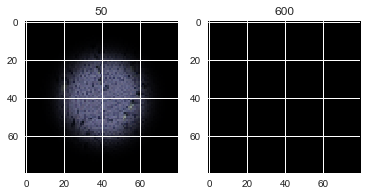

correlation:  0.8721256767129164
means:  -0.13426859887094034  ,  -0.24554805243311684


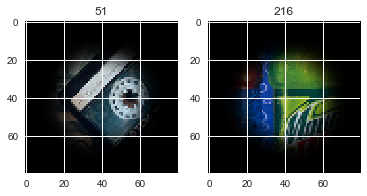

correlation:  0.897980062531252
means:  -0.20802465596677178  ,  -0.19434435931389737


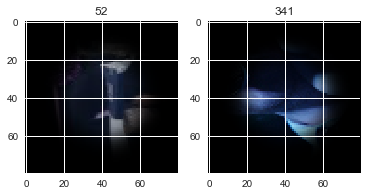

correlation:  0.865789688443246
means:  0.5784372181080357  ,  0.32946148454360996


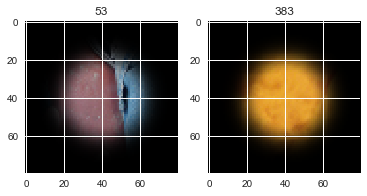

correlation:  0.8704633615361718
means:  -0.26339431584944106  ,  -0.3371151537184192


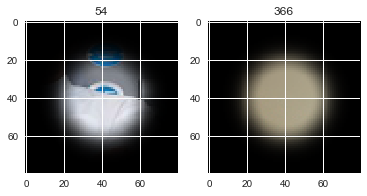

correlation:  0.8653389181207326
means:  -0.4905477114638195  ,  -0.17286565650745941


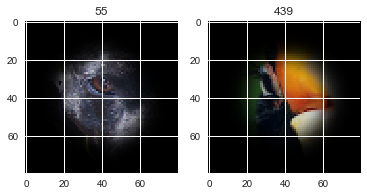

correlation:  0.7489395390698755
means:  -0.16088523623248116  ,  -0.22759543142738525


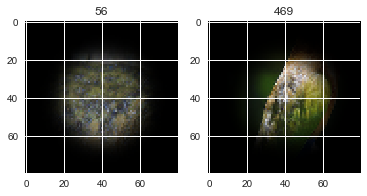

correlation:  0.7575122522359096
means:  0.07663497895688184  ,  -0.00705924533692171


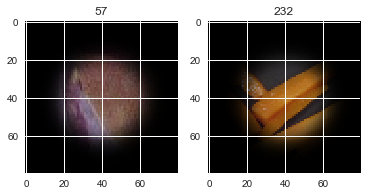

correlation:  0.8557686973111407
means:  0.2824321557377024  ,  0.3755315362497738


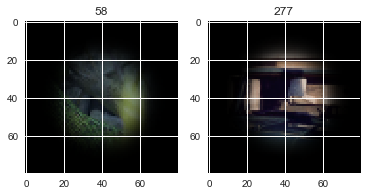

correlation:  0.9839450155256835
means:  -0.23870946017719818  ,  -1.4652639591358443


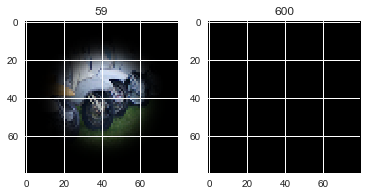

correlation:  0.8002041366234299
means:  -0.44756343667632376  ,  -0.321607873338173


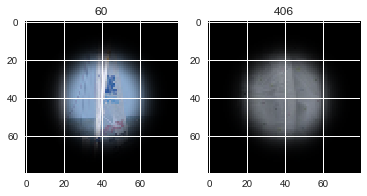

correlation:  0.8332191660057681
means:  0.21725205049041166  ,  -0.15149955474324608


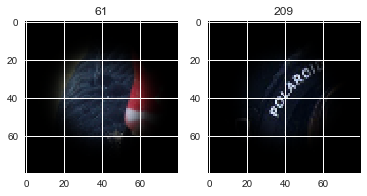

correlation:  0.8170858787861746
means:  -0.5272235073168551  ,  -0.3190890919583182


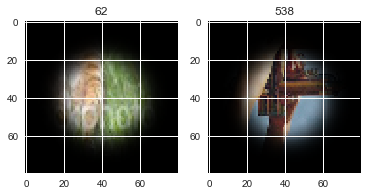

correlation:  0.8836530778288147
means:  -0.5276760867776671  ,  -0.35666178404311427


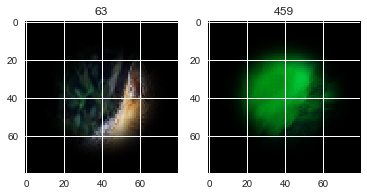

correlation:  0.8363965857167993
means:  0.2617947617512303  ,  -0.0473686557718054


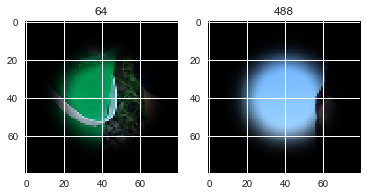

correlation:  0.8812733858257621
means:  -0.06937676227558293  ,  -0.09492505230637956


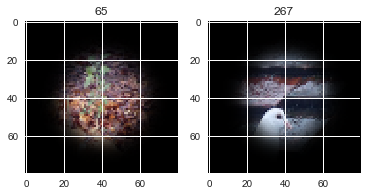

correlation:  0.8961347363024842
means:  -0.16900922623834377  ,  -0.12511121055501886


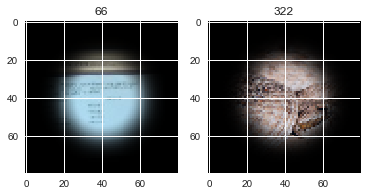

correlation:  0.9316312000391169
means:  0.048428039865389155  ,  -1.4652639591358443


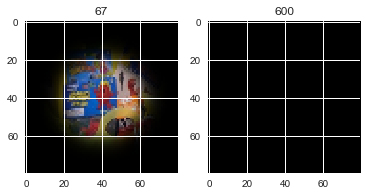

correlation:  0.8673937470422695
means:  0.27139074270477337  ,  -0.046928127596483446


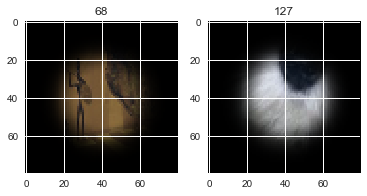

correlation:  0.7861040094195169
means:  0.2845399671663753  ,  -0.3190890919583182


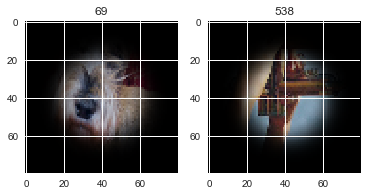

correlation:  0.9812800505558584
means:  0.0763883335290822  ,  -1.4652639591358443


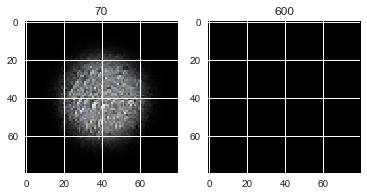

correlation:  0.8126898562742574
means:  0.1600705794431766  ,  -0.1462984059511199


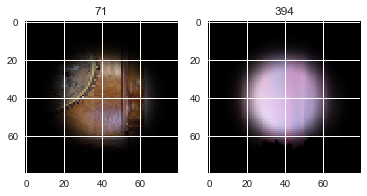

correlation:  0.9112788837839285
means:  -0.2905123846183401  ,  0.32946148454360996


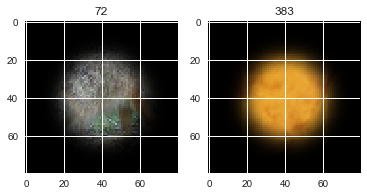

correlation:  0.6922473215174993
means:  -0.3408675241840722  ,  -0.21861548396119554


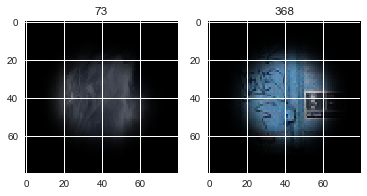

correlation:  0.7836178172462791
means:  -0.12428621723159468  ,  0.3755315362497738


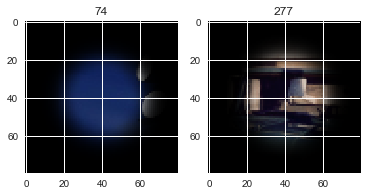

correlation:  0.7465445158808791
means:  -0.2175506514205424  ,  0.4566994589593911


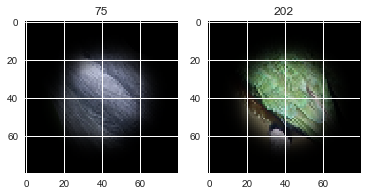

correlation:  0.9105649590408974
means:  0.12362315660638451  ,  0.21418969143672958


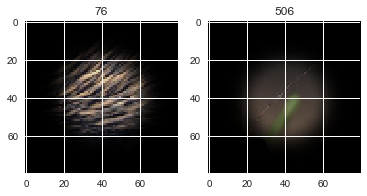

correlation:  0.7660040220622923
means:  -0.03214481773179042  ,  0.2904183480068572


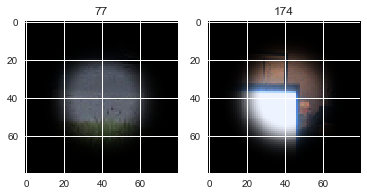

correlation:  0.9207810623214577
means:  0.12846847740135858  ,  0.1248320245914238


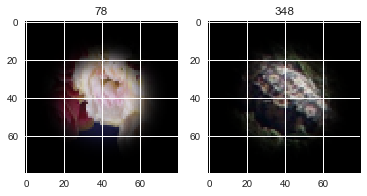

correlation:  0.8296868009968629
means:  0.4350377947716831  ,  -0.21850816530511788


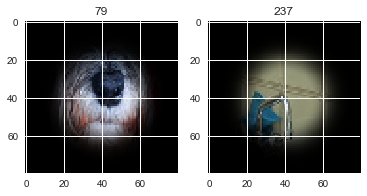

correlation:  0.8819940420266908
means:  -0.1432715032729384  ,  -0.08177987270848573


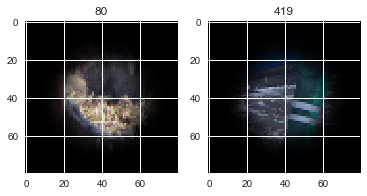

correlation:  0.8287414060645606
means:  0.472712622538051  ,  0.46862260530699945


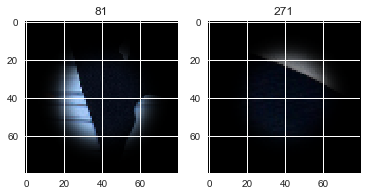

correlation:  0.7934357532718845
means:  0.30817815650290864  ,  -0.35666178404311427


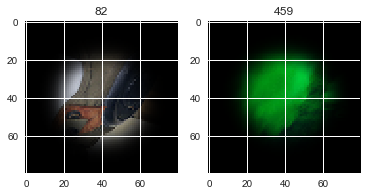

correlation:  0.719149588419915
means:  0.041419216715228746  ,  -0.3190890919583182


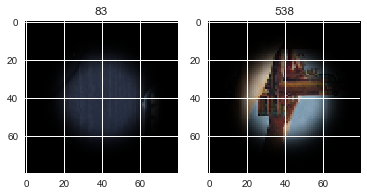

correlation:  0.8345649271210291
means:  0.2635985743841671  ,  0.3742588478190374


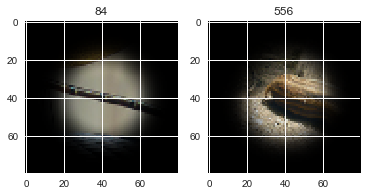

correlation:  0.8784626109431393
means:  -0.3694664665786218  ,  -0.18402515189237054


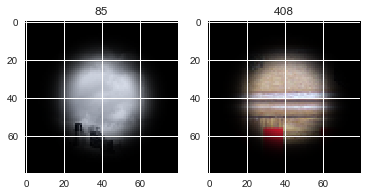

correlation:  0.7026708548375599
means:  -0.03606860508674857  ,  0.21418969143672958


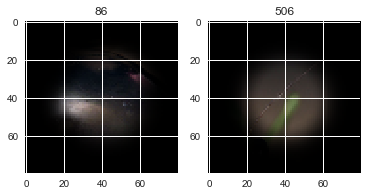

correlation:  0.7850605419900908
means:  -0.34437304437901217  ,  -0.05677662766849905


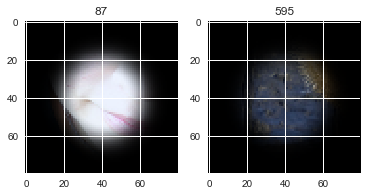

correlation:  0.8782561898137582
means:  0.11198469648363789  ,  -0.13341370742542982


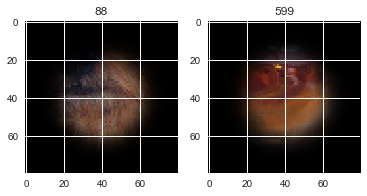

correlation:  0.8772292190414972
means:  0.7311946335856094  ,  0.14449705057328888


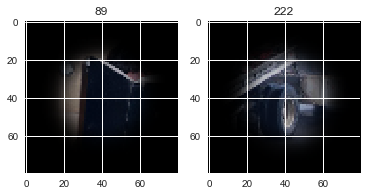

correlation:  0.8056430160725477
means:  0.3070458508490839  ,  -0.3138981778484005


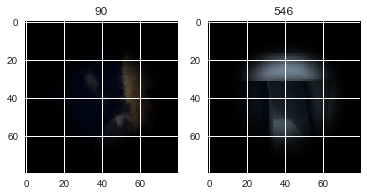

correlation:  0.8829858365626898
means:  -0.17120152916734802  ,  0.4385446042627344


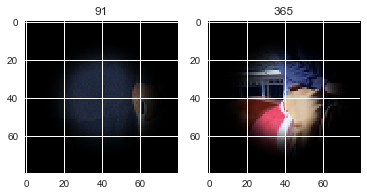

correlation:  0.9168285342830199
means:  0.04374581292212882  ,  -0.42865314863116527


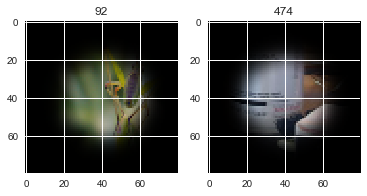

correlation:  0.8684126317041285
means:  0.1952468030564647  ,  -0.00020053852846912463


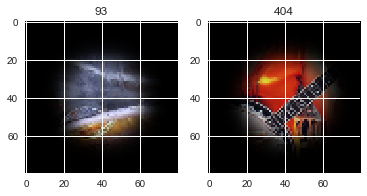

correlation:  0.8985559212452854
means:  -0.2148505608966454  ,  -0.12511121055501886


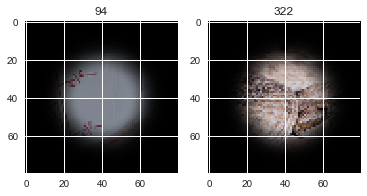

correlation:  0.8307541490623312
means:  -0.29027599478032395  ,  -0.5628038874291211


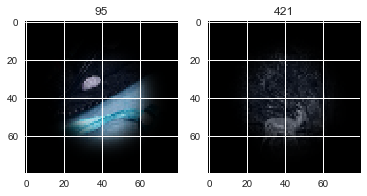

correlation:  0.6768087546151398
means:  0.15770907242137036  ,  1.1085569928351282


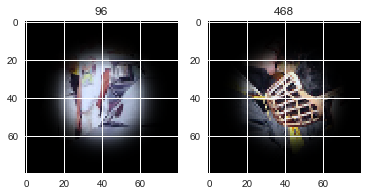

correlation:  0.7582581857395738
means:  0.2221291454193669  ,  0.2848176270883292


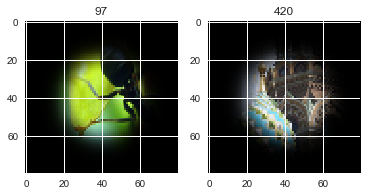

correlation:  0.9030119409656183
means:  -0.12549715786153193  ,  0.798014403869771


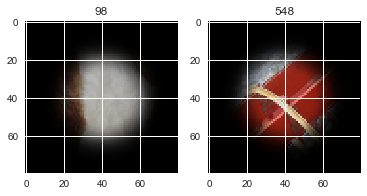

correlation:  0.7642711394433527
means:  0.00613800801382892  ,  -0.17747756041662202


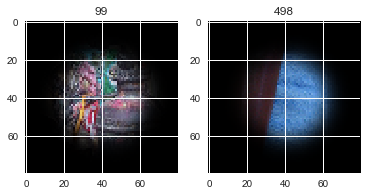

correlation:  0.8976070429806443
means:  -0.008244846712949342  ,  0.20051021523295762


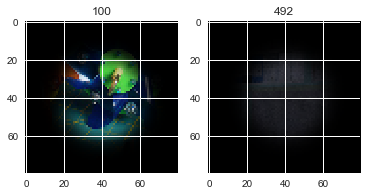

correlation:  0.9010570831064122
means:  -0.13745139668060616  ,  -0.2829175845293425


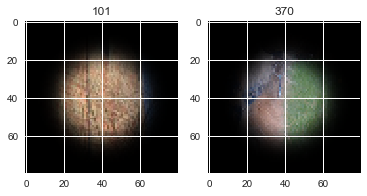

correlation:  0.8198528899183355
means:  -0.13948185406640667  ,  -0.20362350726982487


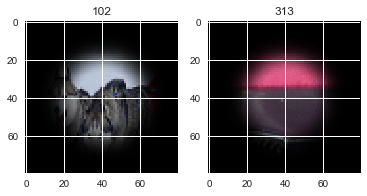

correlation:  0.7689998021593012
means:  0.3501023115855664  ,  -0.3190890919583182


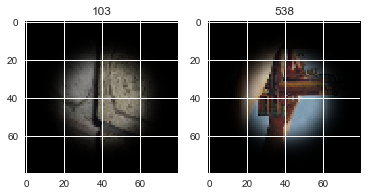

correlation:  0.7335378601849623
means:  -0.16811896688439287  ,  -0.36537828083037655


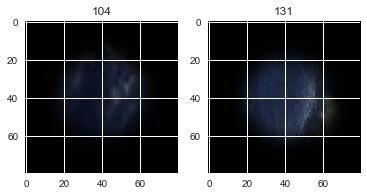

correlation:  0.8958953548182045
means:  -0.09364482857978879  ,  0.22920086589016303


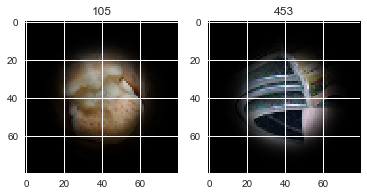

correlation:  0.8261568867565988
means:  -0.2252496622614865  ,  0.45872612782307504


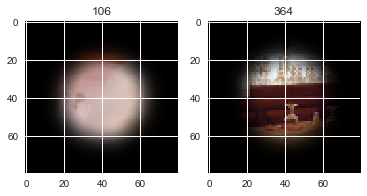

correlation:  0.8383429390416648
means:  -0.10660890014317831  ,  0.07321383051743724


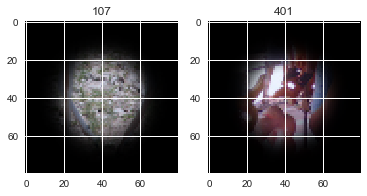

correlation:  0.9069288300787344
means:  -0.21214824538114307  ,  -0.08555546833087865


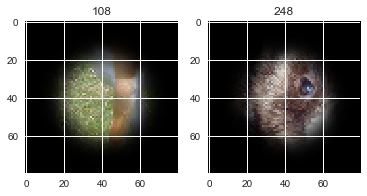

correlation:  0.8641653198826087
means:  0.8170827181141102  ,  -0.36544244068374354


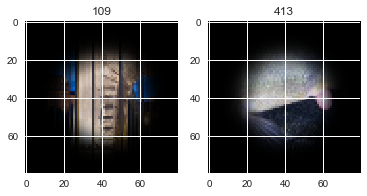

correlation:  0.8808721553898416
means:  0.0045489991908873074  ,  0.14449705057328888


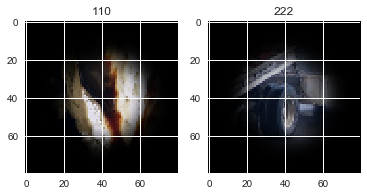

correlation:  0.8226914112332174
means:  0.06987668124782469  ,  0.14649775057844552


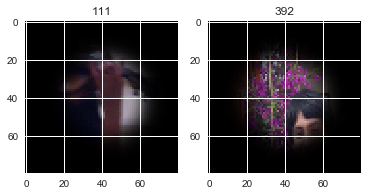

correlation:  0.8314894864387665
means:  0.04747568251088071  ,  0.21191932255972423


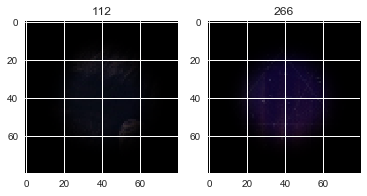

correlation:  0.8942930672063784
means:  -0.27674492459008976  ,  -0.12511121055501886


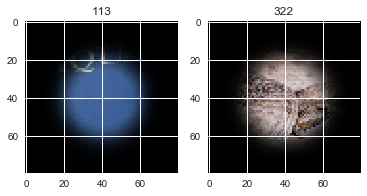

correlation:  0.9414610320578204
means:  -0.45003981277939153  ,  -1.4652639591358443


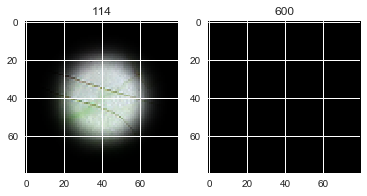

correlation:  0.6953043664477555
means:  0.2974980940699257  ,  -0.24072233574173565


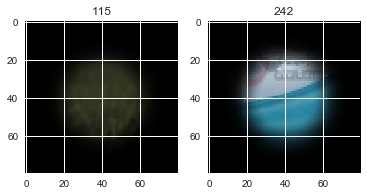

correlation:  0.7735564007009433
means:  -0.20030575110295093  ,  -0.2156404742683371


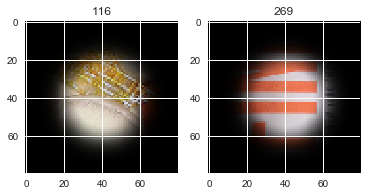

correlation:  0.9121212521208316
means:  -0.278778489149582  ,  -0.21850816530511788


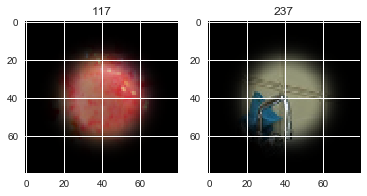

correlation:  0.8418244480264124
means:  0.20904460922562362  ,  0.22920086589016303


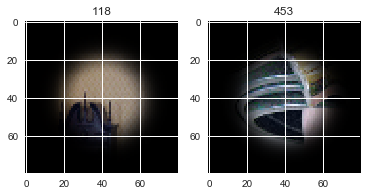

correlation:  0.8214393668902632
means:  -0.5142923818849005  ,  -0.054883501372532346


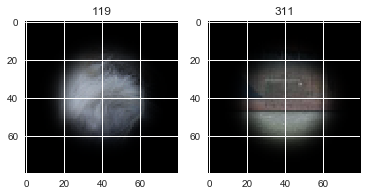

correlation:  0.9554300763919431
means:  0.12280872125211749  ,  -0.08177987270848573


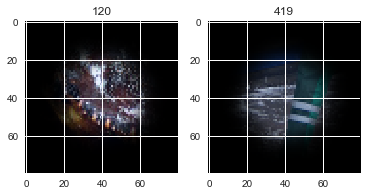

correlation:  0.8873184233028815
means:  -0.48555847033950034  ,  -0.548645778475016


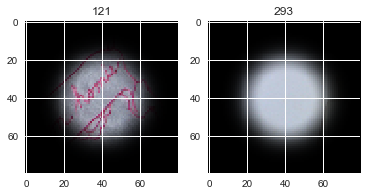

correlation:  0.7500617105388391
means:  0.6272121996233906  ,  0.40652279234326644


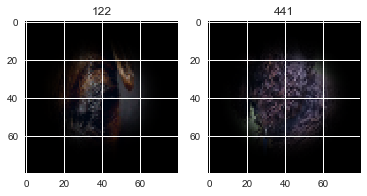

correlation:  0.8851222539829696
means:  0.006868956618054456  ,  -0.09359972294607792


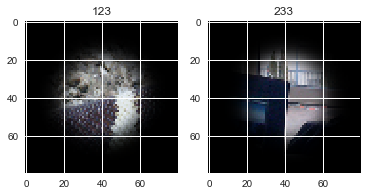

correlation:  0.8566232834693486
means:  0.3420342462938204  ,  0.6826087786561285


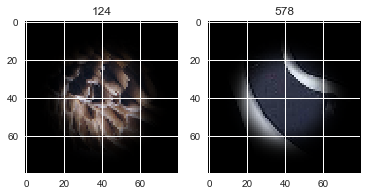

correlation:  0.8735392498784725
means:  -0.3007389421332138  ,  -0.3228741210175776


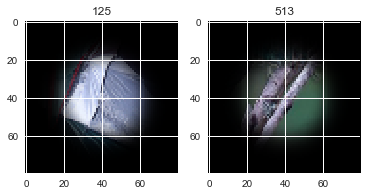

correlation:  0.8160617289855951
means:  0.6541512737942416  ,  0.053936050671690265


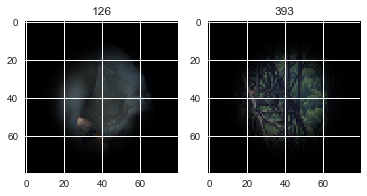

correlation:  0.8673937470422695
means:  -0.046928127596483446  ,  0.27139074270477337


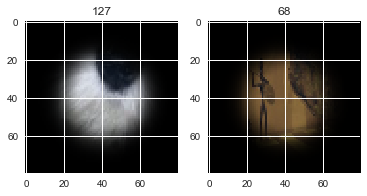

correlation:  0.7446546479874788
means:  -0.00012721275169300106  ,  -0.28280455052350134


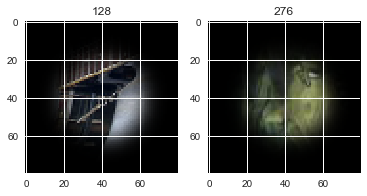

correlation:  0.8629405050896001
means:  -0.3487101215988061  ,  -0.30537901799686984


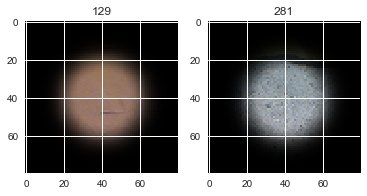

correlation:  0.8399606922256962
means:  -0.24293214606215152  ,  -0.1462984059511199


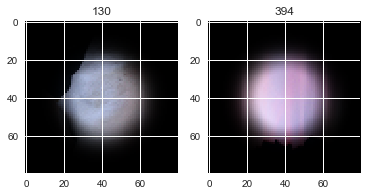

correlation:  0.7945424604275083
means:  -0.36537828083037655  ,  0.2119823745030726


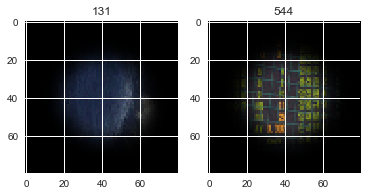

correlation:  0.8591093912579622
means:  0.0003762299825217703  ,  -0.13374714588564407


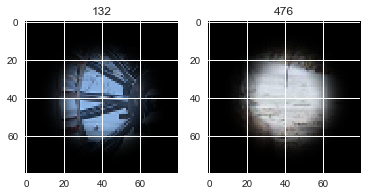

correlation:  0.7820581816357679
means:  -0.3623880241005052  ,  0.3423439243814657


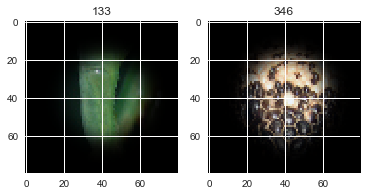

correlation:  0.8133116879670088
means:  0.4224887284672816  ,  -0.17671430346649306


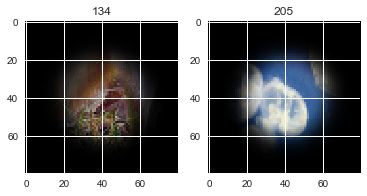

correlation:  0.8407589365530718
means:  0.24573370672026698  ,  -0.28106204801000456


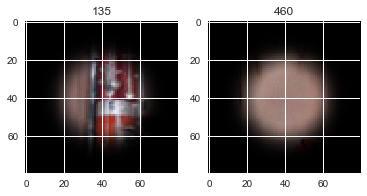

correlation:  0.9587961361246541
means:  0.13115229331727704  ,  0.29681092218870325


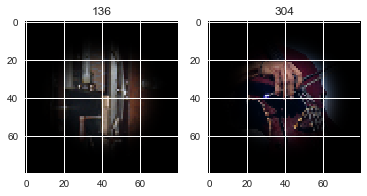

correlation:  0.8422207049313211
means:  -0.2979377816433337  ,  0.32946148454360996


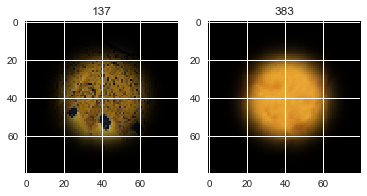

correlation:  0.7957595008280012
means:  0.11199608546375736  ,  0.20195879373901346


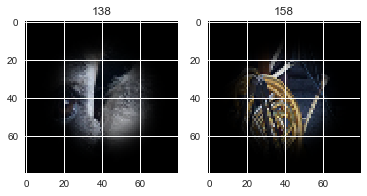

correlation:  0.83364829288481
means:  -0.029451088623819163  ,  -0.10937591312392483


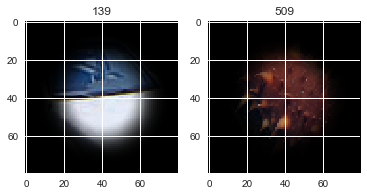

correlation:  0.9887930413289704
means:  0.13978270426038003  ,  -1.4652639591358443


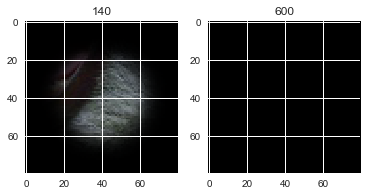

correlation:  0.8436617743757888
means:  0.3195085961760274  ,  0.003285335847043577


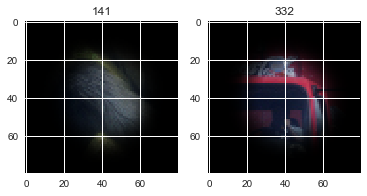

correlation:  0.7874673891113476
means:  -0.15425758456588204  ,  0.30988562594939884


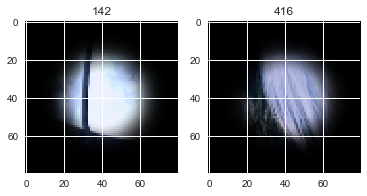

correlation:  0.8931480177089296
means:  -0.2660102201032968  ,  0.15019961310726462


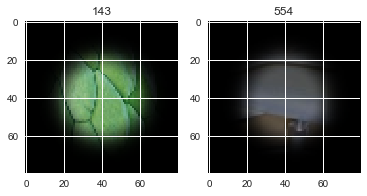

correlation:  0.9387695481412376
means:  -0.5119384574770878  ,  0.32946148454360996


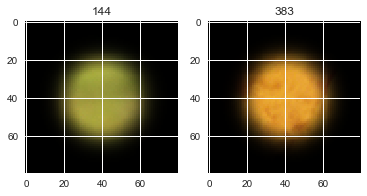

correlation:  0.865562401094783
means:  0.41089106034330647  ,  -1.4652639591358443


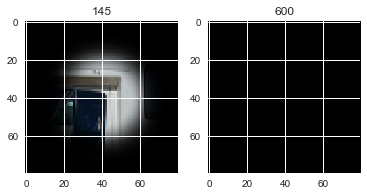

correlation:  0.813542175642293
means:  0.5117295938690969  ,  -1.4652639591358443


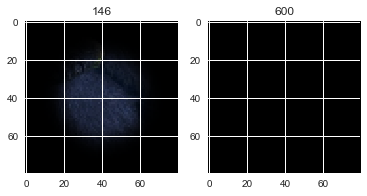

correlation:  0.8540225412698188
means:  -0.08096792232843485  ,  0.17838502020393643


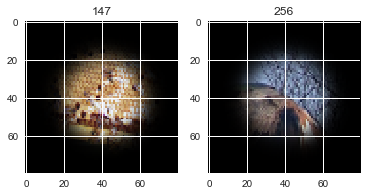

correlation:  0.8414506584599808
means:  -0.3724887209068309  ,  -0.10937591312392483


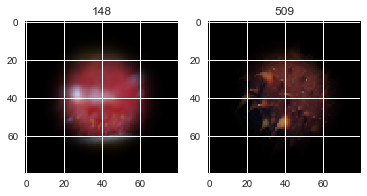

correlation:  0.8195530743771402
means:  -0.028582509983335995  ,  0.42778863624694474


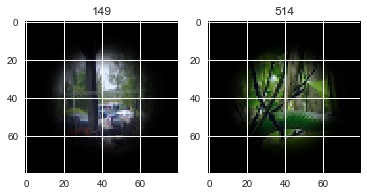

correlation:  0.8873812885601379
means:  0.05345441909615693  ,  -1.4652639591358443


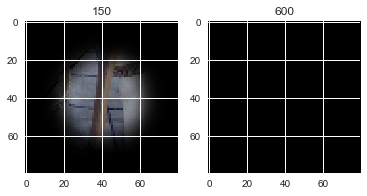

correlation:  0.8688285320882182
means:  -0.018510609956125836  ,  -0.3190890919583182


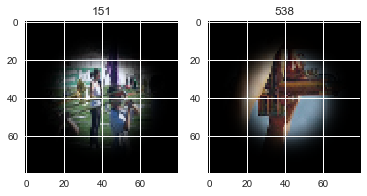

correlation:  0.7742181795550832
means:  -0.15417443486983748  ,  0.05135633855604887


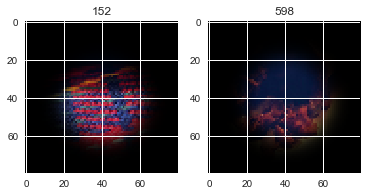

correlation:  0.8699689632711419
means:  -0.31194280837025057  ,  -1.4652639591358443


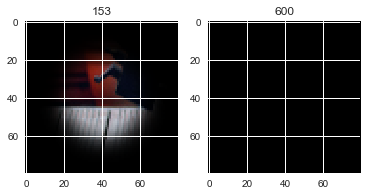

correlation:  0.799522598801675
means:  0.17440602980345252  ,  -0.17286565650745941


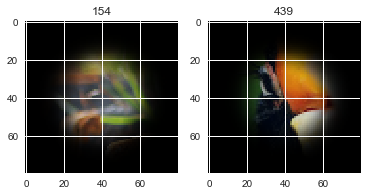

correlation:  0.8491399733570099
means:  0.5419970540058835  ,  -0.607679315442089


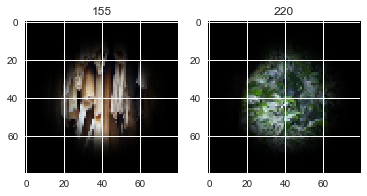

correlation:  0.7882245185736172
means:  -0.3260227659506527  ,  0.22284639926486838


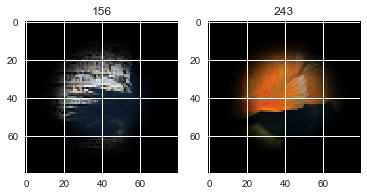

correlation:  0.8226052489162871
means:  0.6570034954240529  ,  0.47350992390901414


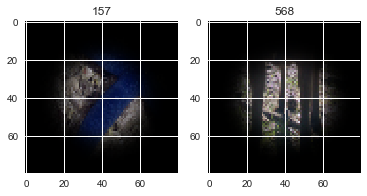

correlation:  0.7978255575049398
means:  0.20195879373901346  ,  -0.44989736967734756


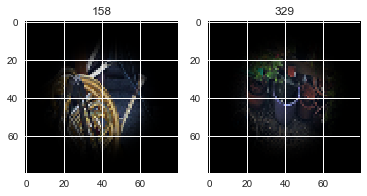

correlation:  0.8568368075654521
means:  -0.4235459260135311  ,  -0.0019677342347108506


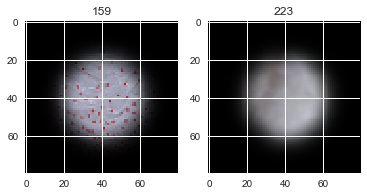

correlation:  0.8614815784981493
means:  -0.19726468090071653  ,  0.1660611955761043


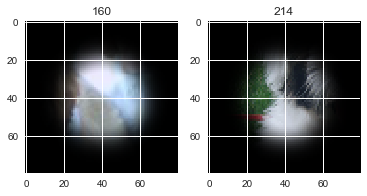

correlation:  0.8796613380367133
means:  -0.15456807316377041  ,  0.15019961310726462


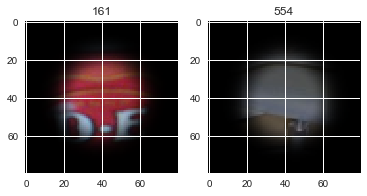

correlation:  0.8661042594881905
means:  -0.10997078800813875  ,  -1.4652639591358443


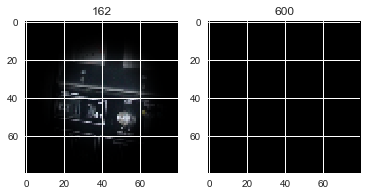

correlation:  0.816909729745626
means:  -0.006046404356143851  ,  -0.4128563184194697


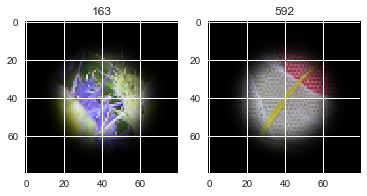

correlation:  0.9310439787027804
means:  -0.094887216398222  ,  0.32946148454360996


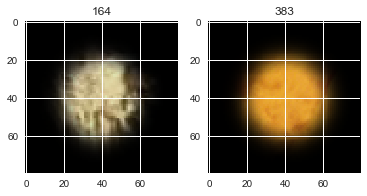

correlation:  0.9285929278074709
means:  -0.28241241911884724  ,  0.024713037780595602


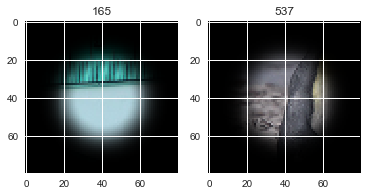

correlation:  0.7968664969728639
means:  0.3452344954328157  ,  0.17542684795662541


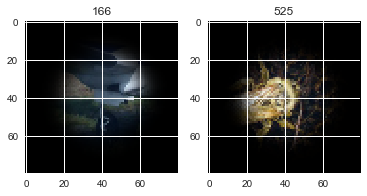

correlation:  0.8649984383393118
means:  -0.1195669000506388  ,  -0.35526438799061794


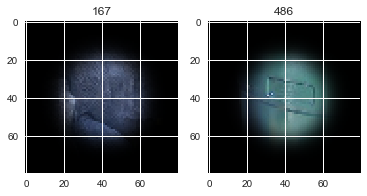

correlation:  0.8669477930793579
means:  -0.02154891935232901  ,  0.15098398771737695


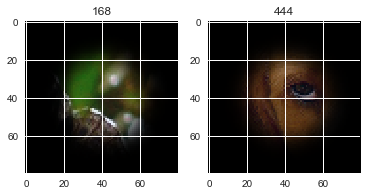

correlation:  0.9761053993158886
means:  0.2912322994712713  ,  -1.4652639591358443


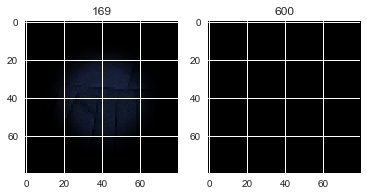

correlation:  0.8306493502664716
means:  0.32402356447910985  ,  0.2798585618935452


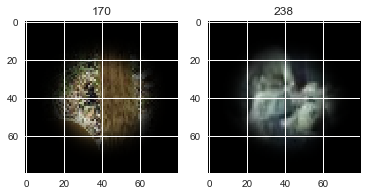

correlation:  0.8007693217435685
means:  0.24477586089881964  ,  0.02511879506625989


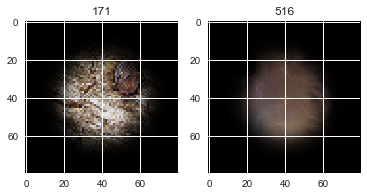

correlation:  0.8356117979958804
means:  -0.22794620997125392  ,  -0.204881179438068


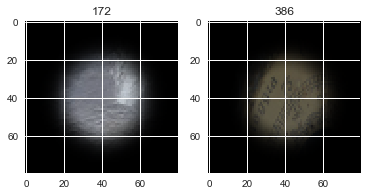

correlation:  0.8429260868199216
means:  -0.019225724600761045  ,  -0.0473686557718054


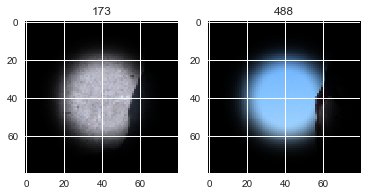

correlation:  0.819402822924138
means:  0.2904183480068572  ,  0.04415965587240464


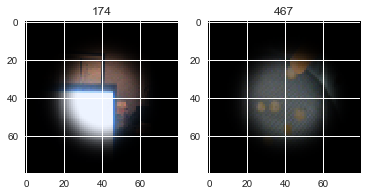

correlation:  0.8004581299968156
means:  -0.17175447361696458  ,  -0.17747756041662202


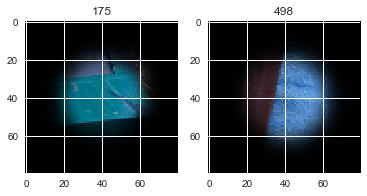

correlation:  0.8726218690858937
means:  0.12374864867420092  ,  -0.17671430346649306


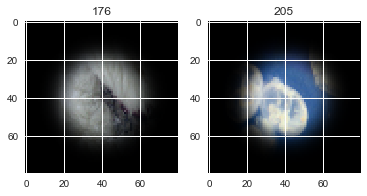

correlation:  0.9183458121598932
means:  -0.27869150754938543  ,  -0.5490275932655944


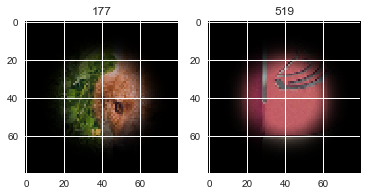

correlation:  0.9520679104858136
means:  -0.37131820083567685  ,  -0.46529195416608665


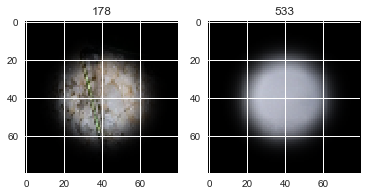

correlation:  0.7551104219286593
means:  1.0757364901796718  ,  0.03145066062417047


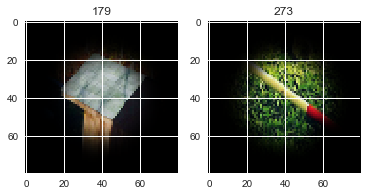

correlation:  0.8030587997296013
means:  0.41418881818683784  ,  0.04391403129246957


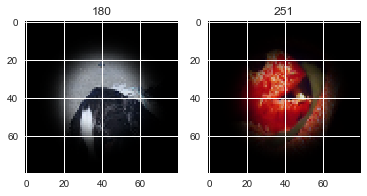

correlation:  0.7840569911148163
means:  -0.3448641218821176  ,  -0.18595662863629894


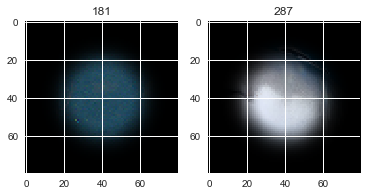

correlation:  0.8507388388754494
means:  -0.311924146646951  ,  -0.4128563184194697


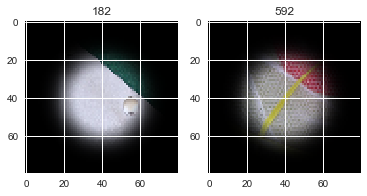

correlation:  0.7639797355364438
means:  0.1584157971972747  ,  -0.32115440990686667


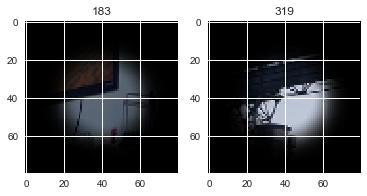

correlation:  0.8265631171907306
means:  -0.19704728199172045  ,  -0.13745139668060616


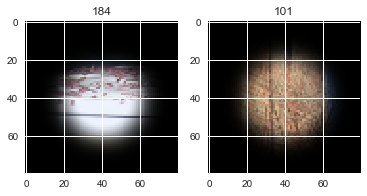

correlation:  0.8386806664478096
means:  0.25812181188102573  ,  -0.29448758717424206


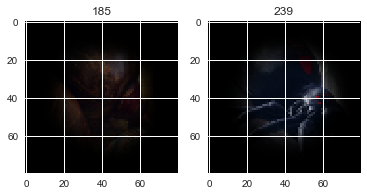

correlation:  0.8768816924060924
means:  0.22201016215001768  ,  -0.22137483530074792


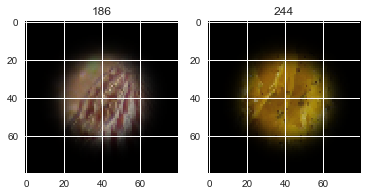

correlation:  0.8458542759826769
means:  -0.1136338521909178  ,  -0.19805722044624077


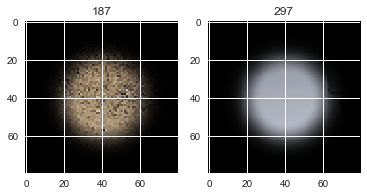

correlation:  0.8513045725746449
means:  0.09353741171596369  ,  0.46862260530699945


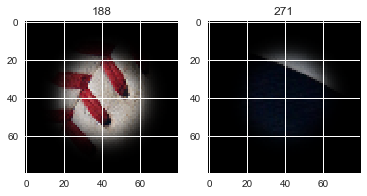

correlation:  0.8542990782138061
means:  0.1746692997602971  ,  -0.4269945715327454


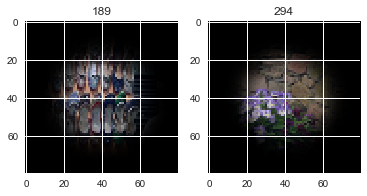

correlation:  0.8836362530892121
means:  -0.05887171950363065  ,  -0.2293109657430742


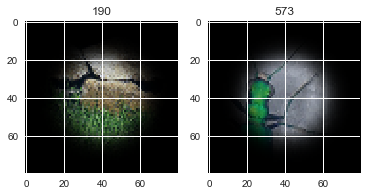

correlation:  0.7825037068910562
means:  0.1717991153349208  ,  0.06715801183990967


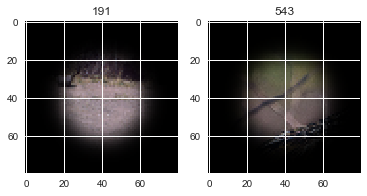

correlation:  0.8248111137143693
means:  0.09022749031819058  ,  -0.17286565650745941


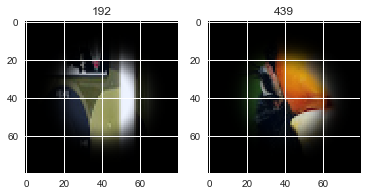

correlation:  0.8739761859498127
means:  -0.32316347566563564  ,  -0.5628038874291211


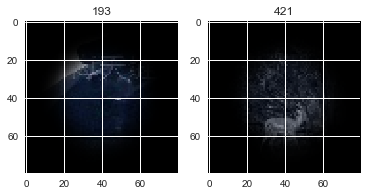

correlation:  0.8200417595665043
means:  0.5841379855603611  ,  0.20051021523295762


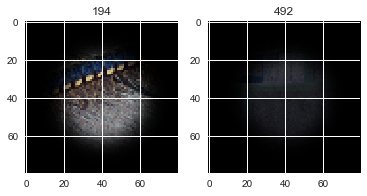

correlation:  0.7953180688407944
means:  -0.23761587825692285  ,  -0.15149955474324608


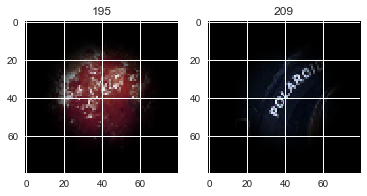

correlation:  0.8862297870775377
means:  0.268754912859123  ,  0.20303576463003445


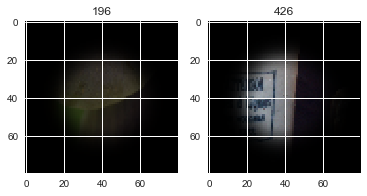

correlation:  0.7895356780349259
means:  0.5903754949457847  ,  0.3137170361166692


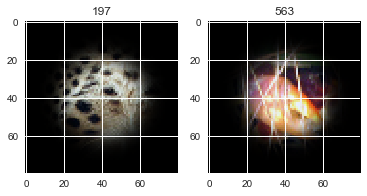

correlation:  0.6853611694037457
means:  0.23681720397025874  ,  -0.04890416897988606


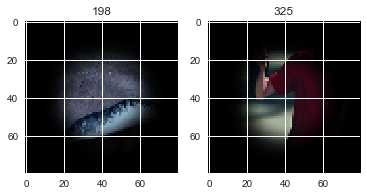

correlation:  0.855563268648908
means:  0.28084310191060285  ,  0.1749262463458826


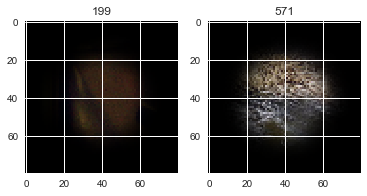

correlation:  0.7660118872014695
means:  0.2958410286915718  ,  0.1392162748667736


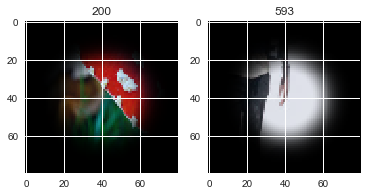

correlation:  0.8407797733631668
means:  -0.15313314564305533  ,  0.17542684795662541


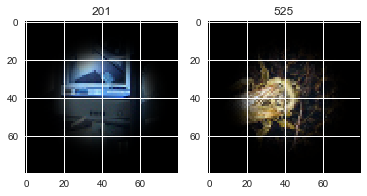

correlation:  0.9449302989227222
means:  0.4566994589593911  ,  0.36326101736422833


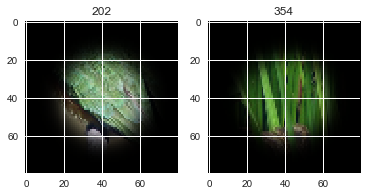

correlation:  0.7668167430985965
means:  0.23122699672513908  ,  -0.053512432008689596


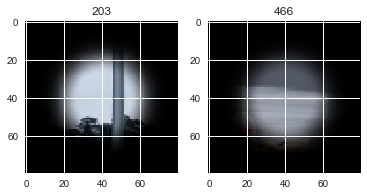

correlation:  0.9127576242681358
means:  -0.11450134992049357  ,  -0.054883501372532346


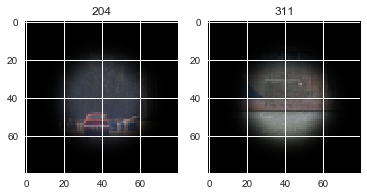

correlation:  0.8726218690858937
means:  -0.17671430346649306  ,  0.12374864867420092


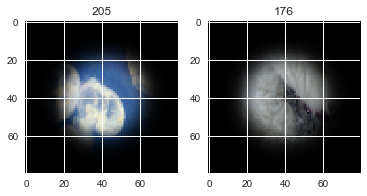

correlation:  0.836815242998594
means:  0.5341480207026437  ,  -0.3405142643750854


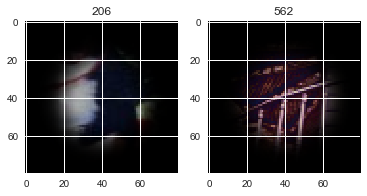

correlation:  0.9872886377430876
means:  0.7476911102788383  ,  -1.4652639591358443


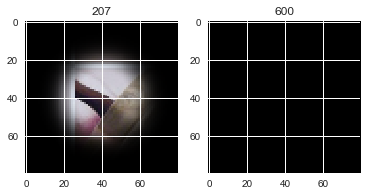

correlation:  0.8909375938832127
means:  -0.22477485742245606  ,  -0.18364033373014868


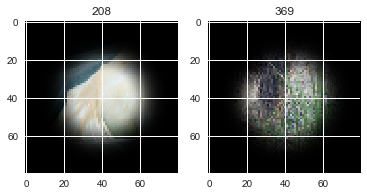

correlation:  0.8332191660057681
means:  -0.15149955474324608  ,  0.21725205049041166


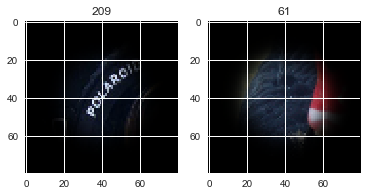

correlation:  0.9101659252525419
means:  -0.2657944655703399  ,  -0.18702260600177986


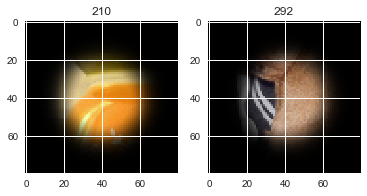

correlation:  0.9118351904569416
means:  0.06882393652659835  ,  -0.30537901799686984


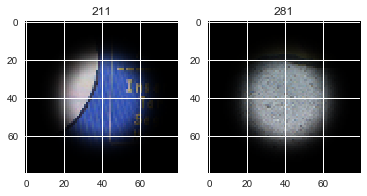

correlation:  0.6562980744000998
means:  0.19786491773828832  ,  -0.07799501091751017


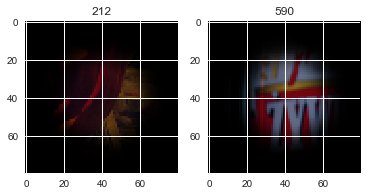

correlation:  0.7653698560894954
means:  0.05958104628759657  ,  -0.29616345293988244


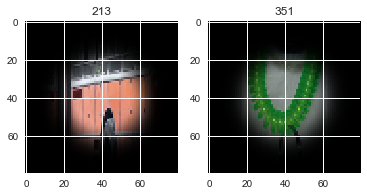

correlation:  0.8614815784981493
means:  0.1660611955761043  ,  -0.19726468090071653


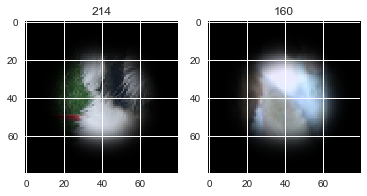

correlation:  0.9452511054323061
means:  0.4049063274690438  ,  -1.4652639591358443


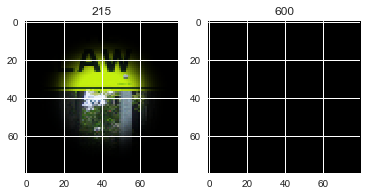

correlation:  0.8721256767129164
means:  -0.24554805243311684  ,  -0.13426859887094034


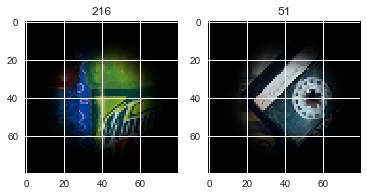

correlation:  0.7823297721887515
means:  0.36309800039551754  ,  0.1392162748667736


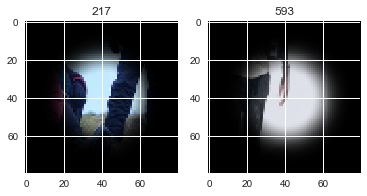

correlation:  0.9305080995816732
means:  -0.16719833746938642  ,  -1.4652639591358443


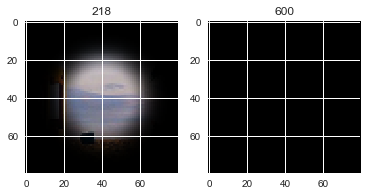

correlation:  0.7556317108814858
means:  0.13637969107654185  ,  -0.23205604426966986


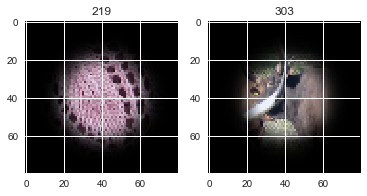

correlation:  0.9056011457687902
means:  -0.607679315442089  ,  -0.19430133791028623


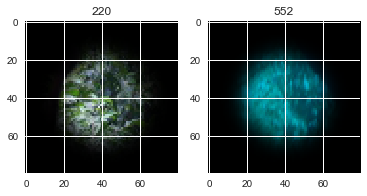

correlation:  0.7689040527976817
means:  -0.4912209855496464  ,  -0.26251807009155664


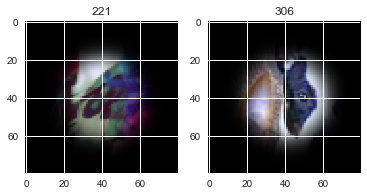

correlation:  0.8808721553898416
means:  0.14449705057328888  ,  0.0045489991908873074


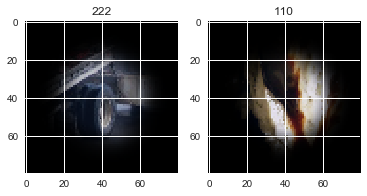

correlation:  0.8568368075654521
means:  -0.0019677342347108506  ,  -0.4235459260135311


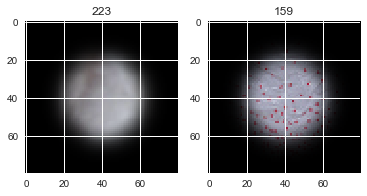

correlation:  0.7841351361596716
means:  -0.6446014672923197  ,  -1.4652639591358443


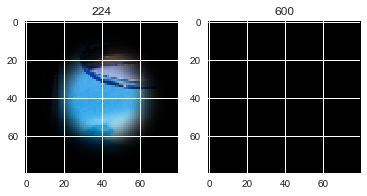

correlation:  0.8546763113153751
means:  0.09806805870472789  ,  0.006868956618054456


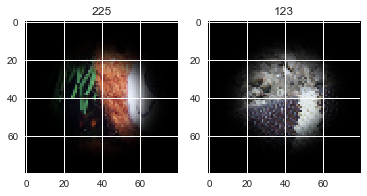

correlation:  0.8832119020519343
means:  -0.22489565565010364  ,  -0.1189120308630097


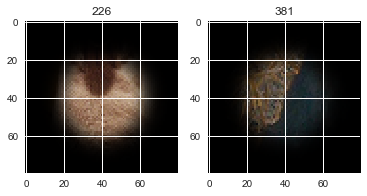

correlation:  0.8423156748618145
means:  -0.0607473201501686  ,  -0.03864947045818726


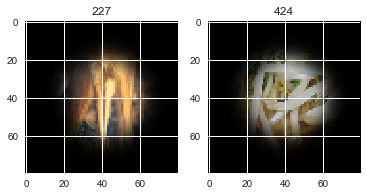

correlation:  0.9243164263522755
means:  0.5700084589939496  ,  0.08936398413575541


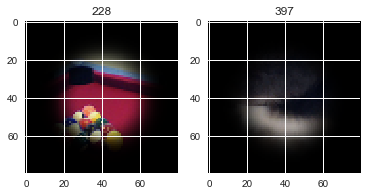

correlation:  0.8755169622041394
means:  0.24444355676520993  ,  -1.4652639591358443


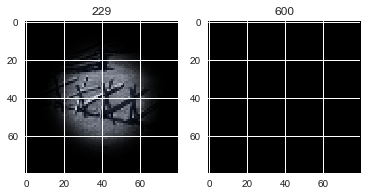

correlation:  0.7909901698173004
means:  0.16322478620586456  ,  0.3742588478190374


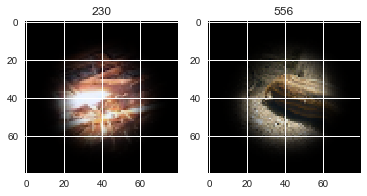

correlation:  0.7587099565233729
means:  0.09744449426158144  ,  0.3882724794840446


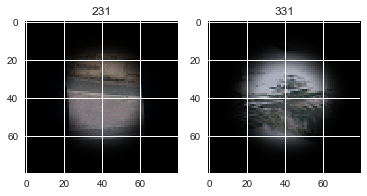

correlation:  0.8181893280084138
means:  -0.00705924533692171  ,  0.04374581292212882


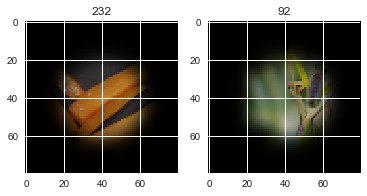

correlation:  0.8851222539829696
means:  -0.09359972294607792  ,  0.006868956618054456


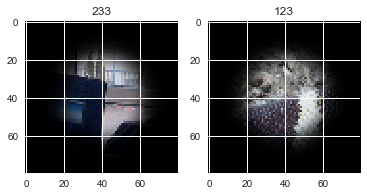

correlation:  0.9444477451439518
means:  0.18191237324382498  ,  -1.4652639591358443


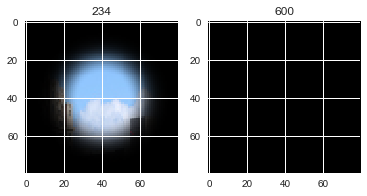

correlation:  0.8191770394964579
means:  -0.11126695325682599  ,  -0.11584481382573077


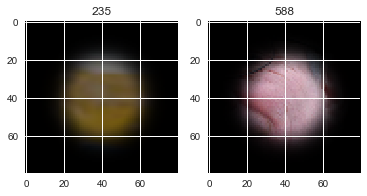

correlation:  0.760613019648088
means:  0.3872589440711629  ,  0.05958104628759657


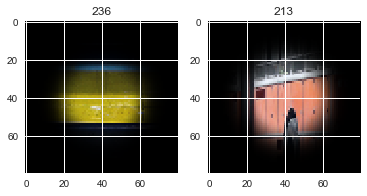

correlation:  0.9773857398260043
means:  -0.21850816530511788  ,  -0.08555546833087865


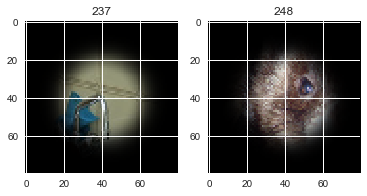

correlation:  0.8306493502664716
means:  0.2798585618935452  ,  0.32402356447910985


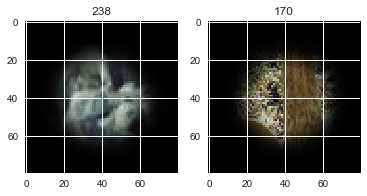

correlation:  0.8643628416969216
means:  -0.29448758717424206  ,  -0.055573302896500525


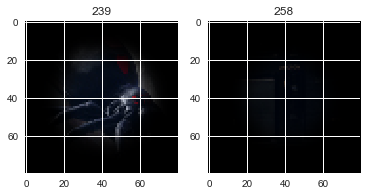

correlation:  0.8890821474341469
means:  0.42112040141598756  ,  0.4566994589593911


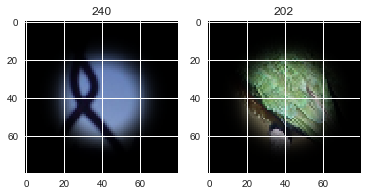

correlation:  0.8830721952013587
means:  0.1626212638523737  ,  0.21191932255972423


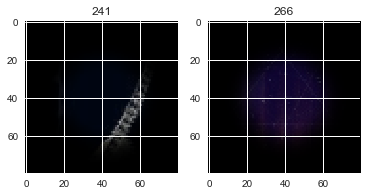

correlation:  0.8951367711315427
means:  -0.24072233574173565  ,  -0.16900922623834377


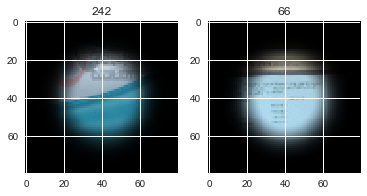

correlation:  0.8423838784662457
means:  0.22284639926486838  ,  -0.15456807316377041


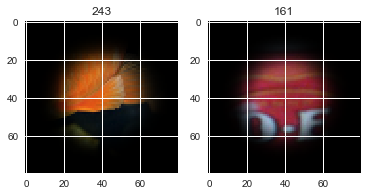

correlation:  0.8769447744685817
means:  -0.22137483530074792  ,  -0.22759543142738525


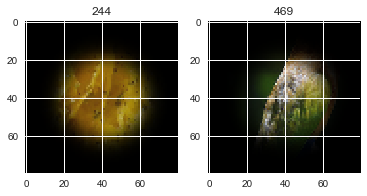

correlation:  0.8866579606165222
means:  0.061733236328723115  ,  -0.20412305442947687


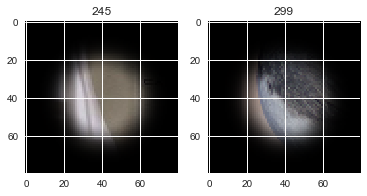

correlation:  0.7873965266967121
means:  -0.3833303677120933  ,  0.300792196868593


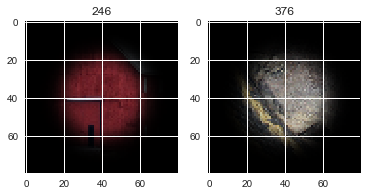

correlation:  0.8701257222882327
means:  0.09527777272457678  ,  0.9323657150459671


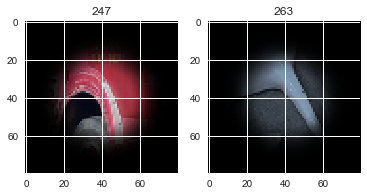

correlation:  0.9773857398260043
means:  -0.08555546833087865  ,  -0.21850816530511788


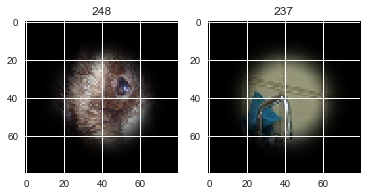

correlation:  0.8642388279579849
means:  -0.2932868032520846  ,  -0.4732293381018309


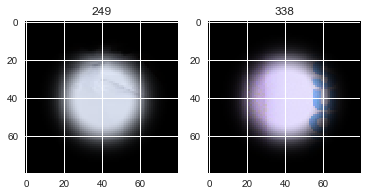

correlation:  0.9727684168606693
means:  -0.06163758076803607  ,  -1.4652639591358443


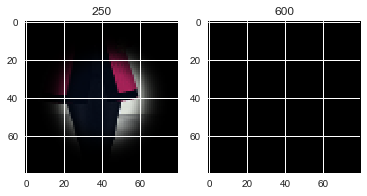

correlation:  0.8030587997296013
means:  0.04391403129246957  ,  0.41418881818683784


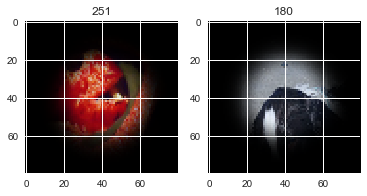

correlation:  0.8409034225455879
means:  -0.24861632641170728  ,  0.17234986355179605


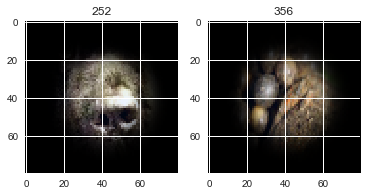

correlation:  0.8552388553397844
means:  0.5704864383134401  ,  0.8912198764065405


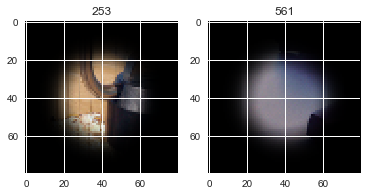

correlation:  0.8867025050933848
means:  -0.04760401837163633  ,  0.32946148454360996


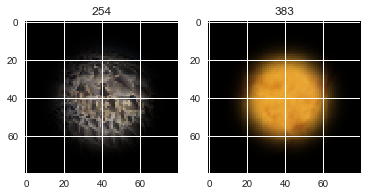

correlation:  0.7993919331324009
means:  -0.019161570332831553  ,  -0.05677662766849905


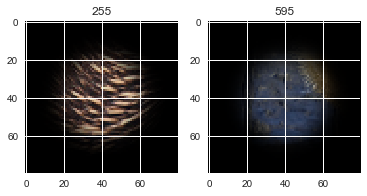

correlation:  0.9319709232971268
means:  0.17838502020393643  ,  0.07752500053947874


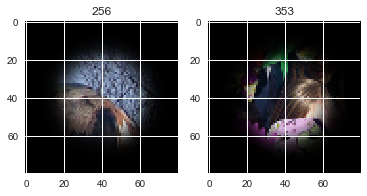

correlation:  0.9500846878596468
means:  0.21316801546147496  ,  0.09123209610212885


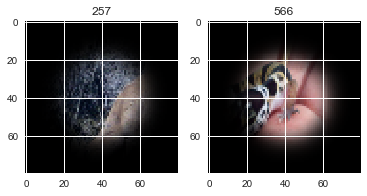

correlation:  0.88908277530827
means:  -0.055573302896500525  ,  -0.3405142643750854


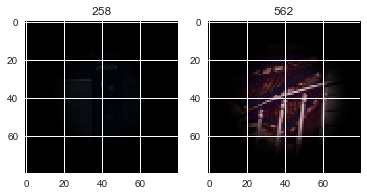

correlation:  0.8021660584322791
means:  0.07384957898246164  ,  -0.20362350726982487


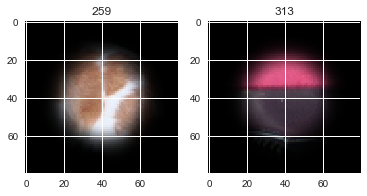

correlation:  0.9391645660767828
means:  0.48345527463080545  ,  -1.4652639591358443


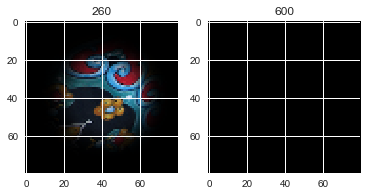

correlation:  0.9511548821985194
means:  0.3729076701043097  ,  0.04727541757152543


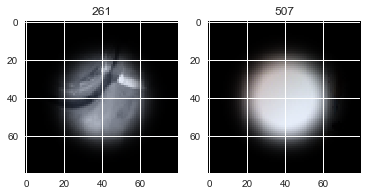

correlation:  0.8020668780636577
means:  0.16658285081265592  ,  0.13593330655445476


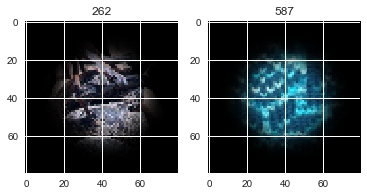

correlation:  0.8701257222882327
means:  0.9323657150459671  ,  0.09527777272457678


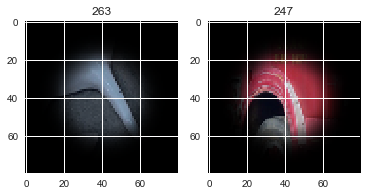

correlation:  0.7942533689322263
means:  -0.6356897310505357  ,  -0.24072233574173565


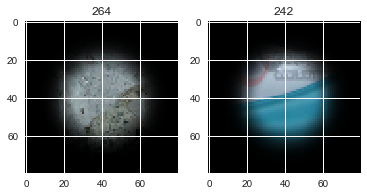

correlation:  0.9004916968373358
means:  -0.14953376963315793  ,  -0.5625802181765039


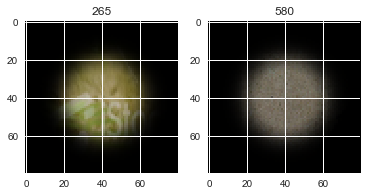

correlation:  0.8830721952013587
means:  0.21191932255972423  ,  0.1626212638523737


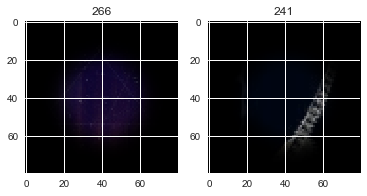

correlation:  0.8812733858257621
means:  -0.09492505230637956  ,  -0.06937676227558293


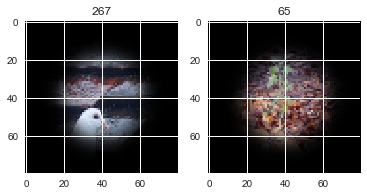

correlation:  0.9426159846934076
means:  -0.4999931019352017  ,  -0.4128563184194697


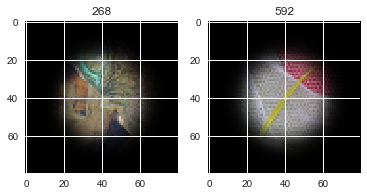

correlation:  0.8611642085016363
means:  -0.2156404742683371  ,  -0.517139508397297


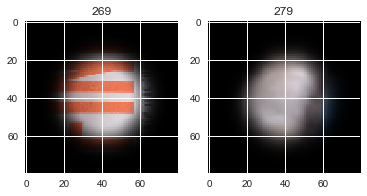

correlation:  0.7985198303436659
means:  -0.48688095256338815  ,  0.0003762299825217703


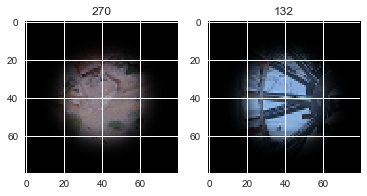

correlation:  0.8513045725746449
means:  0.46862260530699945  ,  0.09353741171596369


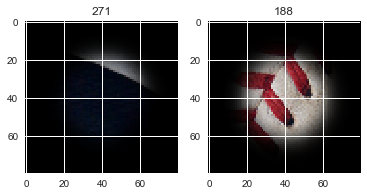

correlation:  0.795011239731894
means:  -0.26677550329284944  ,  0.006868956618054456


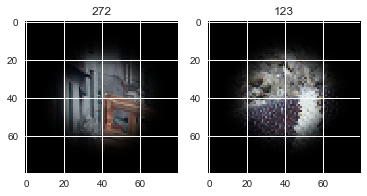

correlation:  0.8590637989531875
means:  0.03145066062417047  ,  0.7311946335856094


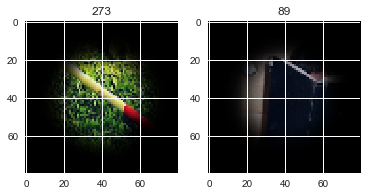

correlation:  0.7767109156107646
means:  0.34306009411848915  ,  0.3802166465364913


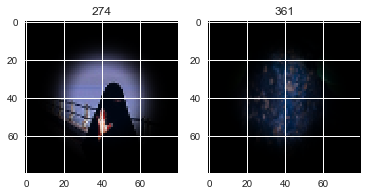

correlation:  0.9235631063278772
means:  -0.23014474561013365  ,  -0.04890416897988606


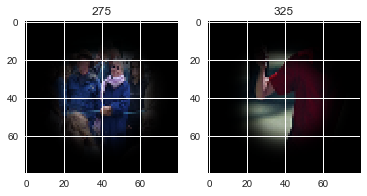

correlation:  0.7722954893248898
means:  -0.28280455052350134  ,  0.06287588059347492


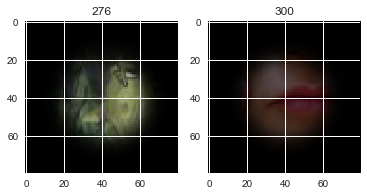

correlation:  0.8557686973111407
means:  0.3755315362497738  ,  0.2824321557377024


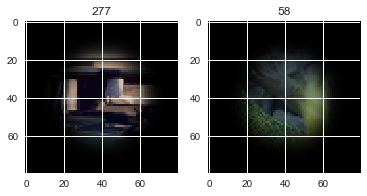

correlation:  0.9007671968705059
means:  -0.15557095683424763  ,  -0.25180705796730607


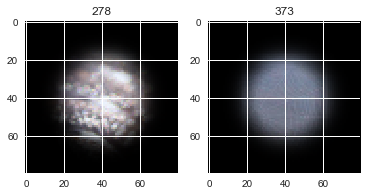

correlation:  0.8846265592780292
means:  -0.517139508397297  ,  0.10336252643920406


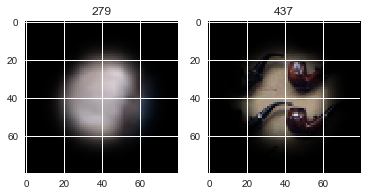

correlation:  0.8301632793532709
means:  -0.14257689716376387  ,  0.0045489991908873074


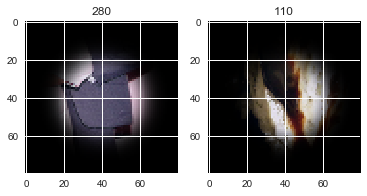

correlation:  0.9118351904569416
means:  -0.30537901799686984  ,  0.06882393652659835


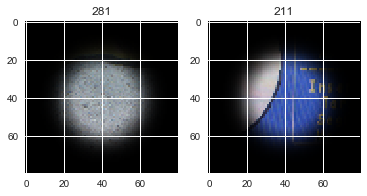

correlation:  0.937810332306747
means:  0.3459989681119048  ,  0.517887223583596


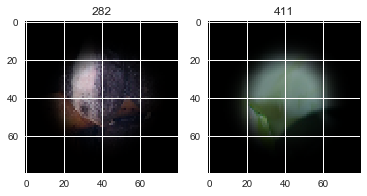

correlation:  0.8717246587184265
means:  -0.42103249437690254  ,  -0.46529195416608665


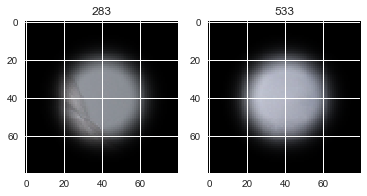

correlation:  0.8398351564757209
means:  -0.3345165920965518  ,  0.10336252643920406


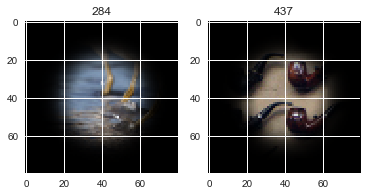

correlation:  0.9261251201558622
means:  -0.4258509475176776  ,  -0.5625802181765039


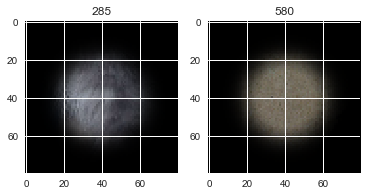

correlation:  0.818203215665331
means:  -0.01292578751739587  ,  0.1749262463458826


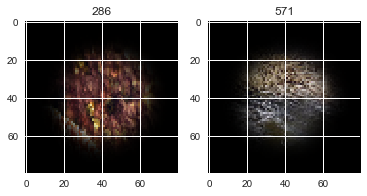

correlation:  0.908694966498317
means:  -0.18595662863629894  ,  -0.21038957029846667


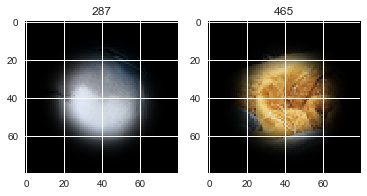

correlation:  0.8930474533469313
means:  -0.08035598284724749  ,  0.5577711696443243


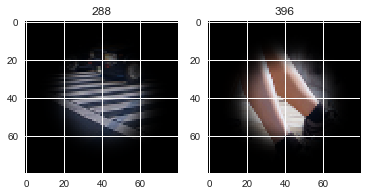

correlation:  0.8921367230900121
means:  -0.33604937177111605  ,  -0.44727471958703635


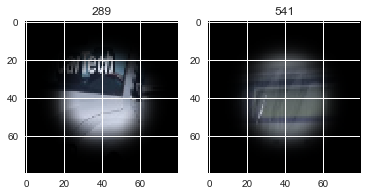

correlation:  0.8369695385176944
means:  -0.3564668575501195  ,  -0.48555847033950034


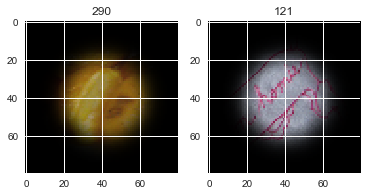

correlation:  0.9981888978361967
means:  0.18997719638891056  ,  -1.4652639591358443


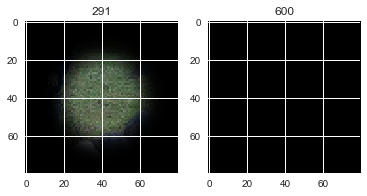

correlation:  0.9101659252525419
means:  -0.18702260600177986  ,  -0.2657944655703399


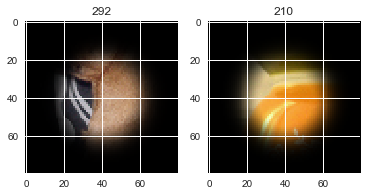

correlation:  0.8873184233028815
means:  -0.548645778475016  ,  -0.48555847033950034


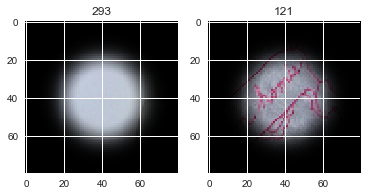

correlation:  0.8617133312294252
means:  -0.4269945715327454  ,  -0.20503389577306477


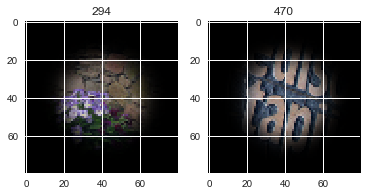

correlation:  0.7944603295520707
means:  0.5188736096103596  ,  0.27067311780831543


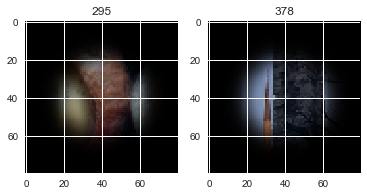

correlation:  0.7983910258190188
means:  0.21397394231894803  ,  -0.18118312895124292


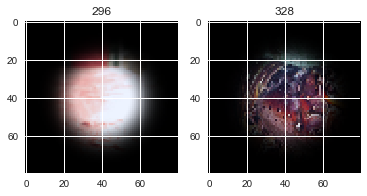

correlation:  0.8823184038617395
means:  -0.19805722044624077  ,  -0.30537901799686984


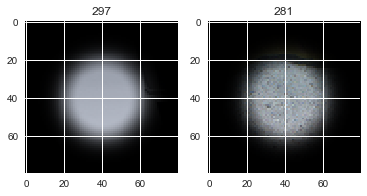

correlation:  0.9014887017986537
means:  -0.31180675203057046  ,  -0.28241241911884724


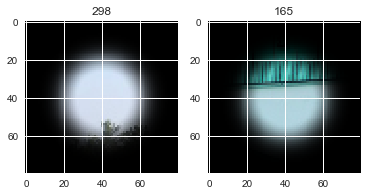

correlation:  0.8866579606165222
means:  -0.20412305442947687  ,  0.061733236328723115


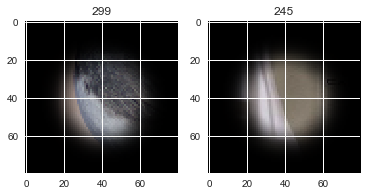

correlation:  0.7909623011936231
means:  0.06287588059347492  ,  0.28084310191060285


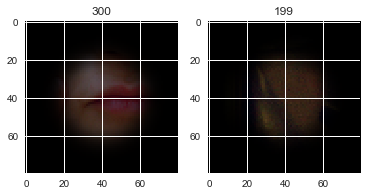

correlation:  0.858325621695329
means:  0.005562768323611719  ,  -0.046632046351766814


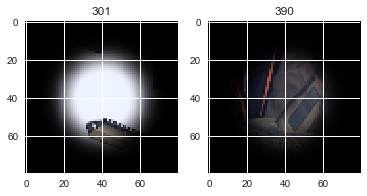

correlation:  0.8754304576895451
means:  0.20299823935638822  ,  -0.023353142362042792


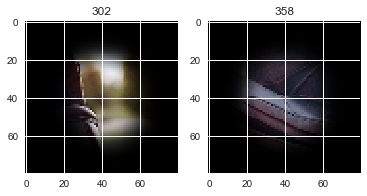

correlation:  0.8512880023948737
means:  -0.23205604426966986  ,  -0.3435376979258626


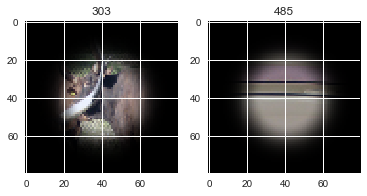

correlation:  0.9587961361246541
means:  0.29681092218870325  ,  0.13115229331727704


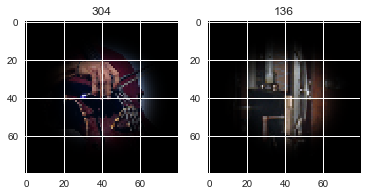

correlation:  0.673727991038811
means:  0.473400874378734  ,  0.16016110188436922


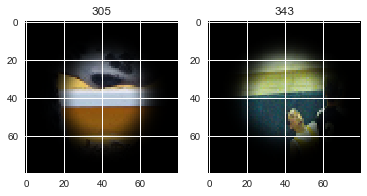

correlation:  0.7862907150718057
means:  -0.26251807009155664  ,  -0.09022574580806664


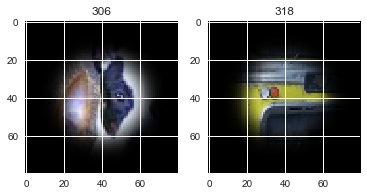

correlation:  0.717417965913387
means:  -0.2501018671411857  ,  -0.00848630972381635


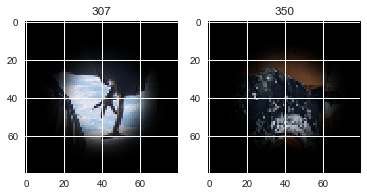

correlation:  0.8516178200432815
means:  0.012947724607270233  ,  0.04822459664623588


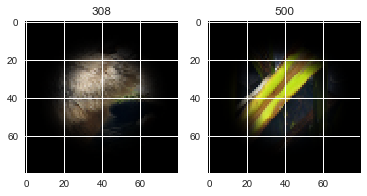

correlation:  0.7569176903153869
means:  0.5990266237852448  ,  -0.36537828083037655


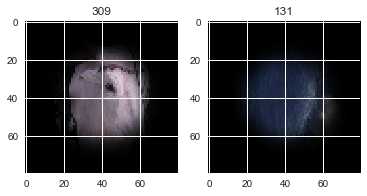

correlation:  0.7823408030959629
means:  -0.21701046822277037  ,  -0.23014474561013365


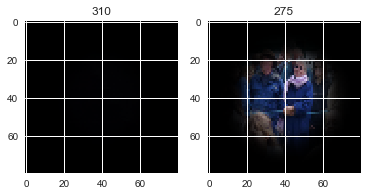

correlation:  0.9127576242681358
means:  -0.054883501372532346  ,  -0.11450134992049357


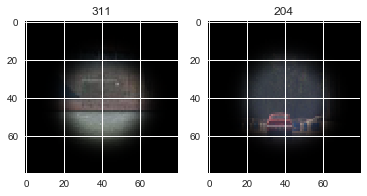

correlation:  0.771970966027107
means:  0.025245873174154984  ,  -0.15425758456588204


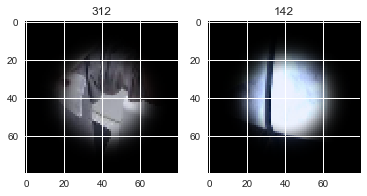

correlation:  0.8198528899183355
means:  -0.20362350726982487  ,  -0.13948185406640667


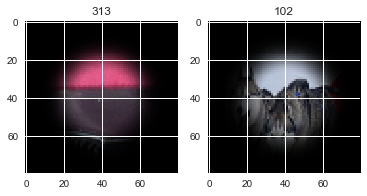

correlation:  0.8523750701868373
means:  -0.23346224189049478  ,  -0.3177598959475037


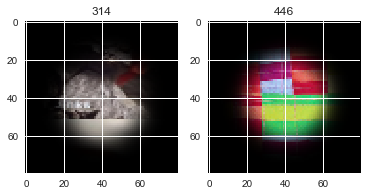

correlation:  0.8184668655816014
means:  -0.45680547468531446  ,  0.3420342462938204


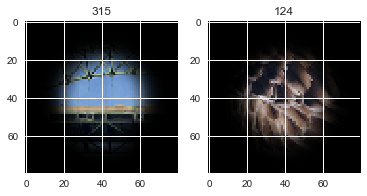

correlation:  0.7812141078738948
means:  -0.17023127368316662  ,  -0.22759543142738525


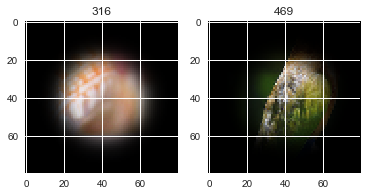

correlation:  0.84475035741057
means:  -0.24631484670485204  ,  -0.08555546833087865


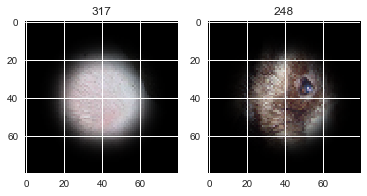

correlation:  0.8215980486247003
means:  -0.09022574580806664  ,  -0.21996764686855205


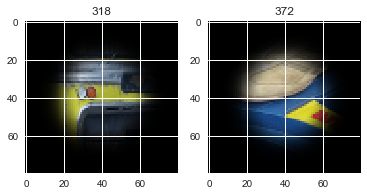

correlation:  0.9495510418579038
means:  -0.32115440990686667  ,  -1.4652639591358443


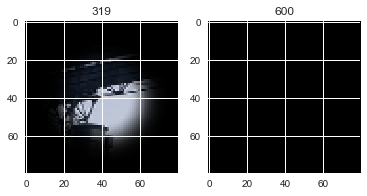

correlation:  0.8008566495163435
means:  0.20573251735579817  ,  0.16016110188436922


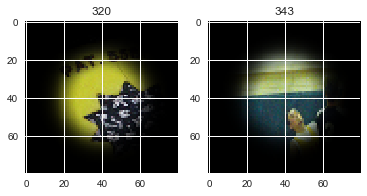

correlation:  0.9569696500807898
means:  0.33994792123101714  ,  0.4886866504271384


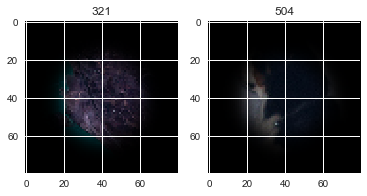

correlation:  0.913129086496946
means:  -0.12511121055501886  ,  -0.4732293381018309


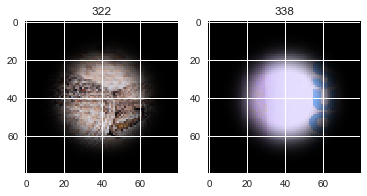

correlation:  0.7469021424400817
means:  0.08754166882415361  ,  0.9745456262467417


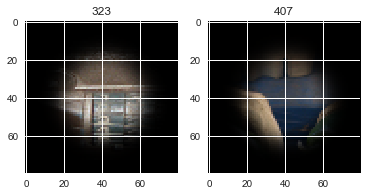

correlation:  0.7572159194480156
means:  -0.20216226039263405  ,  -0.163333911457193


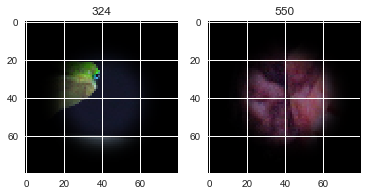

correlation:  0.9235631063278772
means:  -0.04890416897988606  ,  -0.23014474561013365


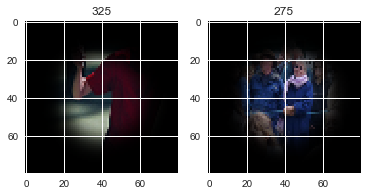

correlation:  0.8383302464681984
means:  0.5992535010741843  ,  0.47350992390901414


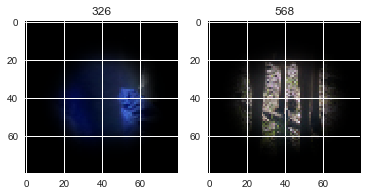

correlation:  0.8487211576019424
means:  -0.27757043720306057  ,  -0.25097369190110025


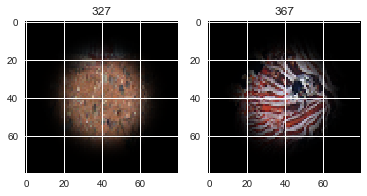

correlation:  0.8537526901858017
means:  -0.18118312895124292  ,  0.2119823745030726


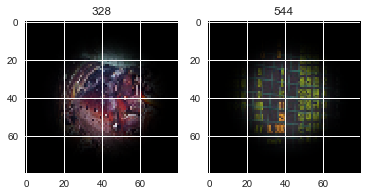

correlation:  0.7978255575049398
means:  -0.44989736967734756  ,  0.20195879373901346


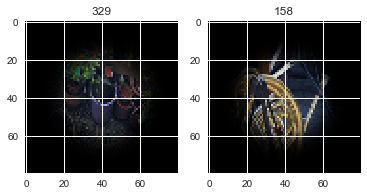

correlation:  0.8880733009097859
means:  -0.22950910522720813  ,  -0.05633345229576443


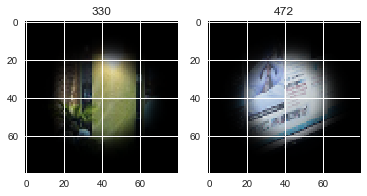

correlation:  0.8195683548976667
means:  0.3882724794840446  ,  -1.4652639591358443


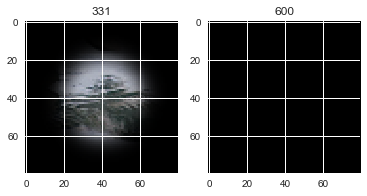

correlation:  0.8436617743757888
means:  0.003285335847043577  ,  0.3195085961760274


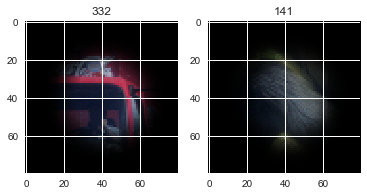

correlation:  0.8243778432448597
means:  -0.4246778765278442  ,  -0.10937591312392483


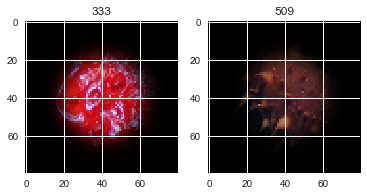

correlation:  0.8022805315471991
means:  -0.22319234384681802  ,  0.3755315362497738


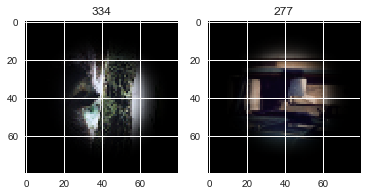

correlation:  0.8226401957368841
means:  0.39810359949827134  ,  0.5700084589939496


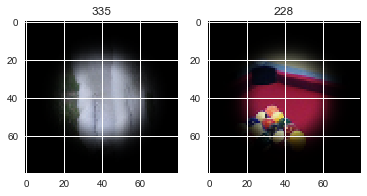

correlation:  0.8819458122423376
means:  0.021646044254758877  ,  -0.24145858233195458


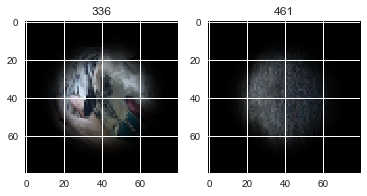

correlation:  0.7523676181879487
means:  -0.006962551177307425  ,  0.0691679125774749


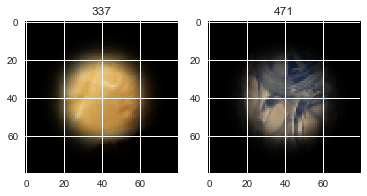

correlation:  0.913129086496946
means:  -0.4732293381018309  ,  -0.12511121055501886


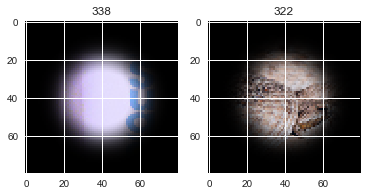

correlation:  0.9455023063262145
means:  -0.2724161570738844  ,  -1.4652639591358443


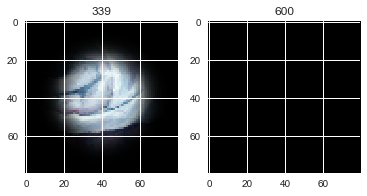

correlation:  0.9248054386466297
means:  -0.09689739146776168  ,  -0.28106204801000456


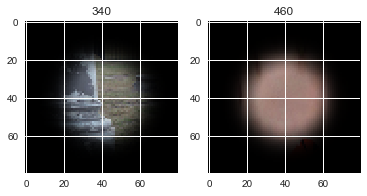

correlation:  0.9460552086330785
means:  -0.19434435931389737  ,  0.11660906857447878


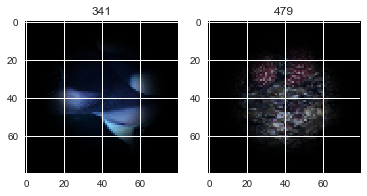

correlation:  0.7919992699439458
means:  -0.13770611090818985  ,  -0.24145858233195458


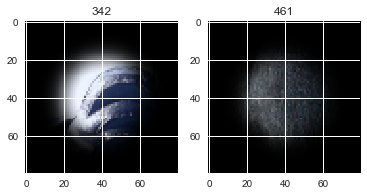

correlation:  0.8287926700224685
means:  0.16016110188436922  ,  -0.15834300327490755


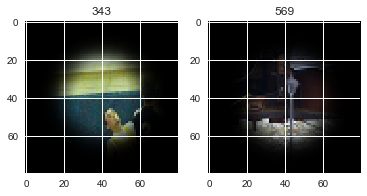

correlation:  0.892049476094168
means:  -0.012461599796203527  ,  -0.19430133791028623


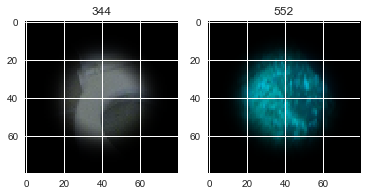

correlation:  0.8386834379146839
means:  0.26247286215270343  ,  -0.060262671996479084


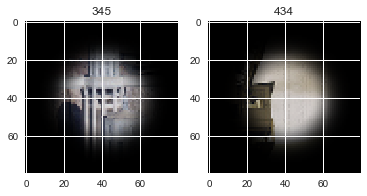

correlation:  0.7820581816357679
means:  0.3423439243814657  ,  -0.3623880241005052


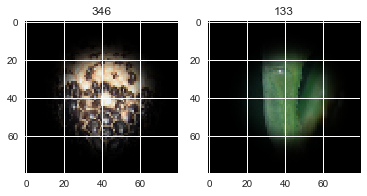

correlation:  0.8714247233254517
means:  0.38980202956496157  ,  -1.4652639591358443


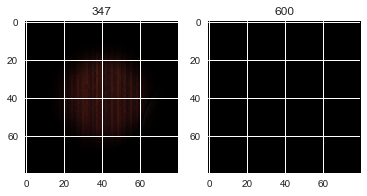

correlation:  0.9207810623214577
means:  0.1248320245914238  ,  0.12846847740135858


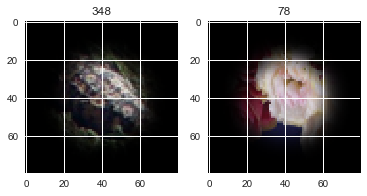

correlation:  0.9121820225121888
means:  -0.47471834682655606  ,  -1.4652639591358443


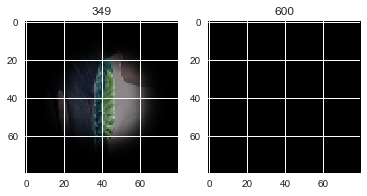

correlation:  0.8145143895024597
means:  -0.00848630972381635  ,  0.19819632024255282


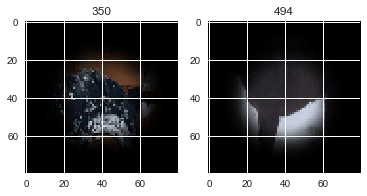

correlation:  0.7774818356863668
means:  -0.29616345293988244  ,  -0.06731739140093654


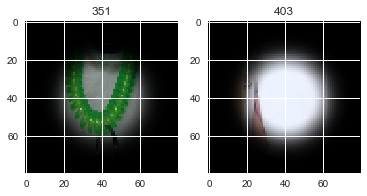

correlation:  0.8247781377525741
means:  0.21204087521008522  ,  -0.23346224189049478


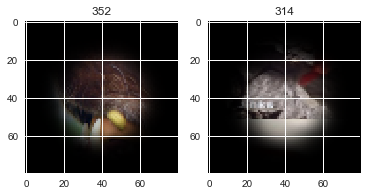

correlation:  0.9319709232971268
means:  0.07752500053947874  ,  0.17838502020393643


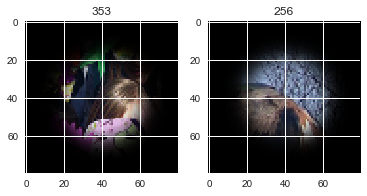

correlation:  0.9449302989227222
means:  0.36326101736422833  ,  0.4566994589593911


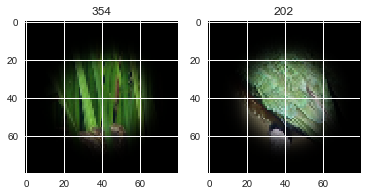

correlation:  0.7768523723645516
means:  -0.39570832956617996  ,  -0.18402515189237054


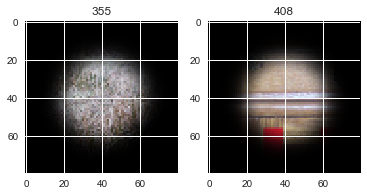

correlation:  0.8409034225455879
means:  0.17234986355179605  ,  -0.24861632641170728


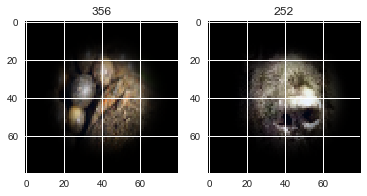

correlation:  0.8822714692740626
means:  -0.22135396005436023  ,  -0.23274682334359936


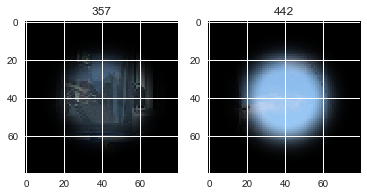

correlation:  0.9167000761268542
means:  -0.023353142362042792  ,  0.1248320245914238


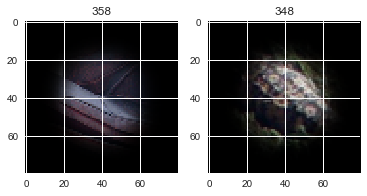

correlation:  0.8608188936024347
means:  -0.4476363130048931  ,  -0.12549715786153193


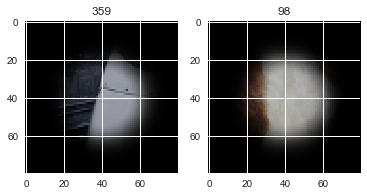

correlation:  0.7996230291801719
means:  -0.2664623478352018  ,  0.798014403869771


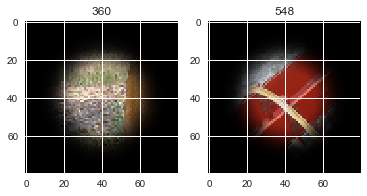

correlation:  0.8715499002092625
means:  0.3802166465364913  ,  -0.055573302896500525


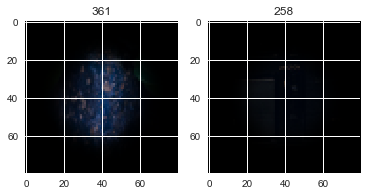

correlation:  0.8610561766090707
means:  0.4254889379747222  ,  0.273516530233975


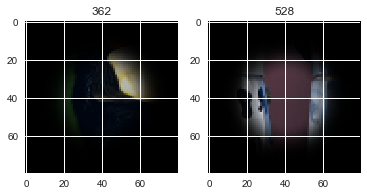

correlation:  0.7544467924974111
means:  -0.17021025152781163  ,  -0.22794620997125392


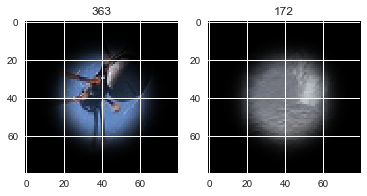

correlation:  0.8424478526247003
means:  0.45872612782307504  ,  -0.00020053852846912463


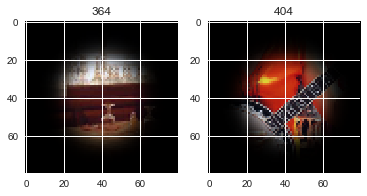

correlation:  0.8829858365626898
means:  0.4385446042627344  ,  -0.17120152916734802


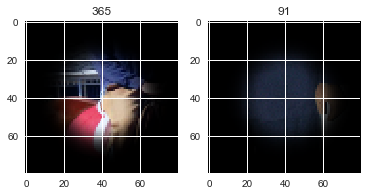

correlation:  0.8840706270706864
means:  -0.3371151537184192  ,  -0.5119384574770878


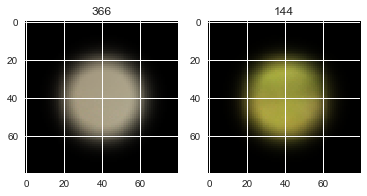

correlation:  0.8487211576019424
means:  -0.25097369190110025  ,  -0.27757043720306057


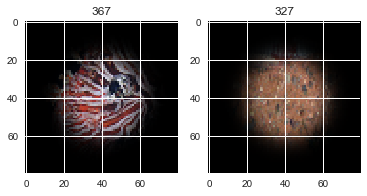

correlation:  0.8370385883304104
means:  -0.21861548396119554  ,  -0.43750632536954187


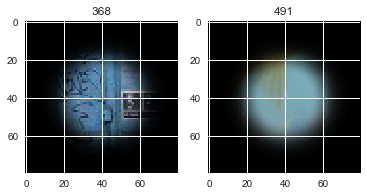

correlation:  0.8909375938832127
means:  -0.18364033373014868  ,  -0.22477485742245606


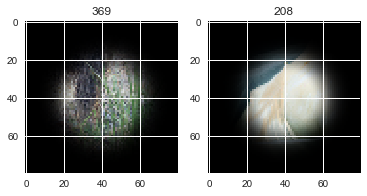

correlation:  0.9010570831064122
means:  -0.2829175845293425  ,  -0.13745139668060616


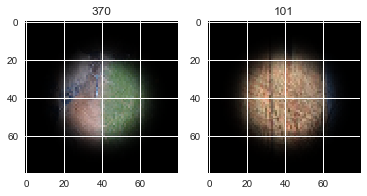

correlation:  0.850758344102405
means:  -0.2265047681771886  ,  -0.18118312895124292


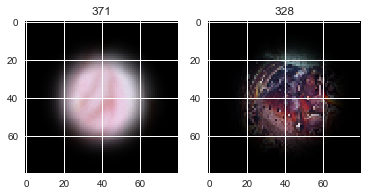

correlation:  0.8215980486247003
means:  -0.21996764686855205  ,  -0.09022574580806664


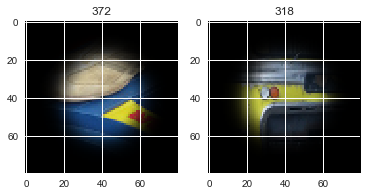

correlation:  0.9007671968705059
means:  -0.25180705796730607  ,  -0.15557095683424763


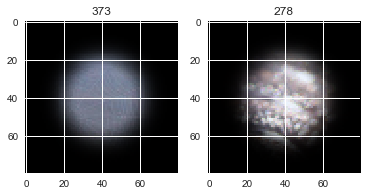

correlation:  0.8853980483652745
means:  -0.5977646659858018  ,  0.42778863624694474


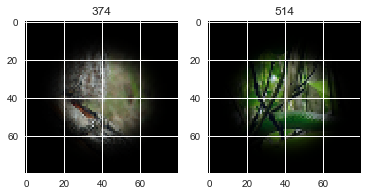

correlation:  0.8421383606431939
means:  -0.22298039178645065  ,  0.33994792123101714


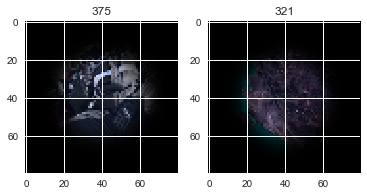

correlation:  0.818369000833094
means:  0.300792196868593  ,  -0.13426859887094034


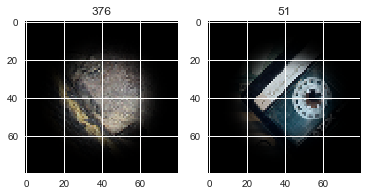

correlation:  0.7912589609288244
means:  1.0160627295710638  ,  -0.31194280837025057


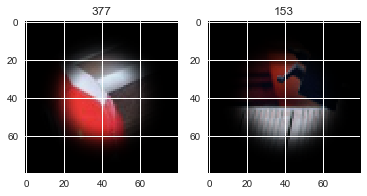

correlation:  0.8631586546389328
means:  0.27067311780831543  ,  0.4149953954940294


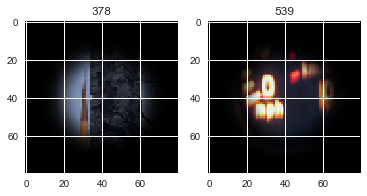

correlation:  0.8182179094466117
means:  -0.40298893451196327  ,  -0.6488351720042389


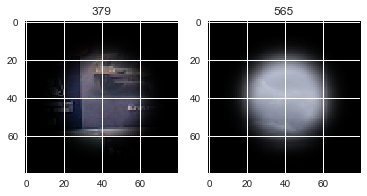

correlation:  0.7980040846164491
means:  -0.4763969259765958  ,  -0.35666178404311427


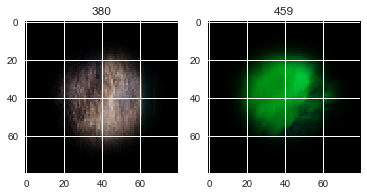

correlation:  0.8832119020519343
means:  -0.1189120308630097  ,  -0.22489565565010364


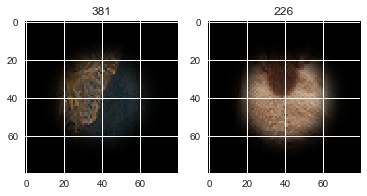

correlation:  0.8265301694811906
means:  -0.7557136281614528  ,  -0.09689739146776168


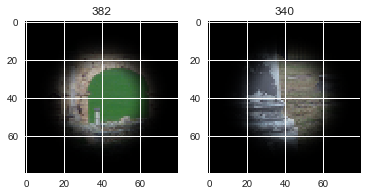

correlation:  0.9387695481412376
means:  0.32946148454360996  ,  -0.5119384574770878


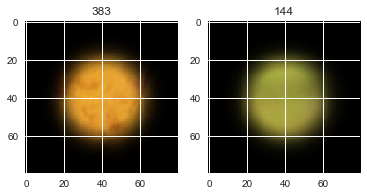

correlation:  0.9677630772753179
means:  0.3593348529907456  ,  -1.4652639591358443


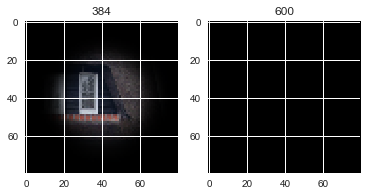

correlation:  0.8601969309678155
means:  0.14662662975787785  ,  -0.43975758228459105


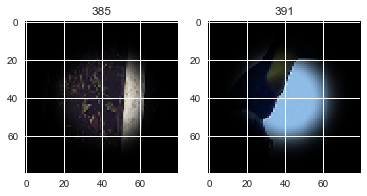

correlation:  0.8356117979958804
means:  -0.204881179438068  ,  -0.22794620997125392


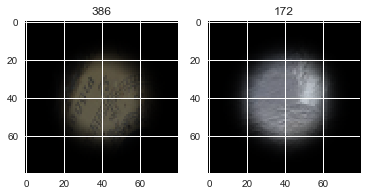

correlation:  0.8366439063646167
means:  0.48526936442436847  ,  0.5419970540058835


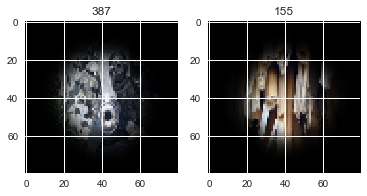

correlation:  0.9198617129580728
means:  -0.352677469799895  ,  -0.21850816530511788


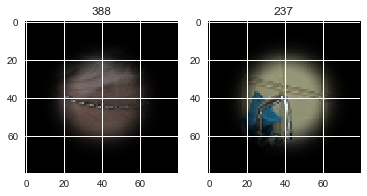

correlation:  0.8154554772723915
means:  -0.023630888418542415  ,  0.6540418432165833


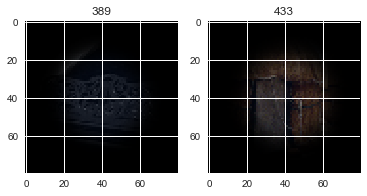

correlation:  0.858325621695329
means:  -0.046632046351766814  ,  0.005562768323611719


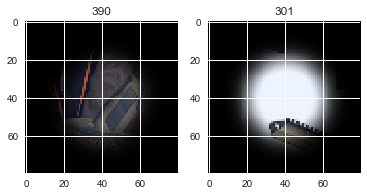

correlation:  0.8601969309678155
means:  -0.43975758228459105  ,  0.14662662975787785


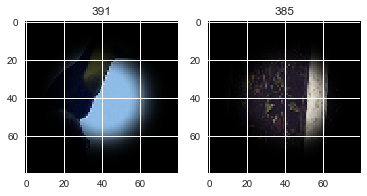

correlation:  0.8226914112332174
means:  0.14649775057844552  ,  0.06987668124782469


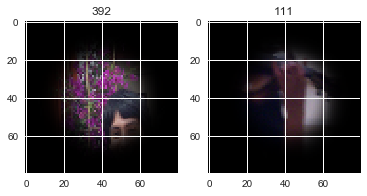

correlation:  0.8160617289855951
means:  0.053936050671690265  ,  0.6541512737942416


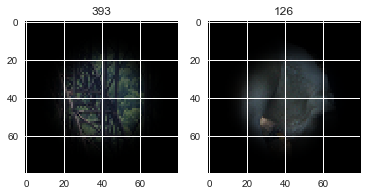

correlation:  0.9293949327487291
means:  -0.1462984059511199  ,  -0.1201705135231164


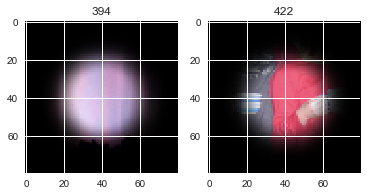

correlation:  0.7513787793028576
means:  -0.43893507666519566  ,  0.45872612782307504


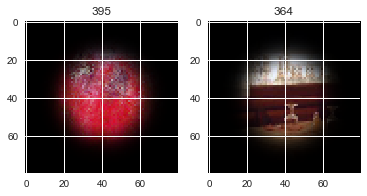

correlation:  0.8930474533469313
means:  0.5577711696443243  ,  -0.08035598284724749


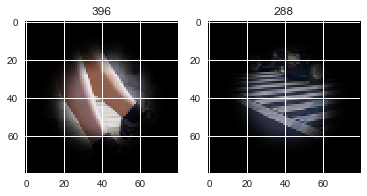

correlation:  0.9243164263522755
means:  0.08936398413575541  ,  0.5700084589939496


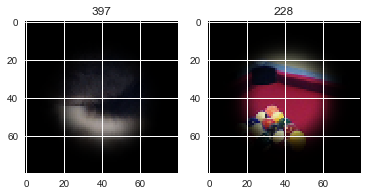

correlation:  0.9418194353860913
means:  0.014695168388468767  ,  -0.3129408315121396


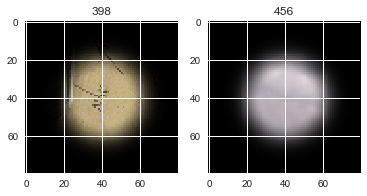

correlation:  0.6469049232395953
means:  0.16794577508533476  ,  0.05135633855604887


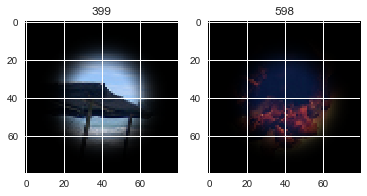

correlation:  0.7596410882582371
means:  -0.48498352939718764  ,  -0.2829175845293425


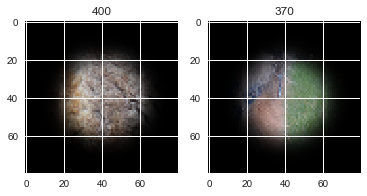

correlation:  0.8383429390416648
means:  0.07321383051743724  ,  -0.10660890014317831


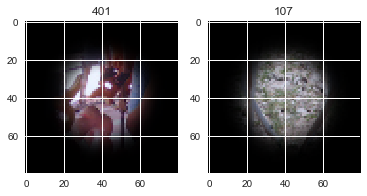

correlation:  0.8556289289284286
means:  0.5979748821360092  ,  0.4886866504271384


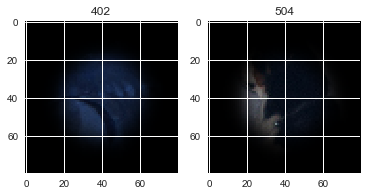

correlation:  0.7810971291572454
means:  -0.06731739140093654  ,  -0.1288590907725604


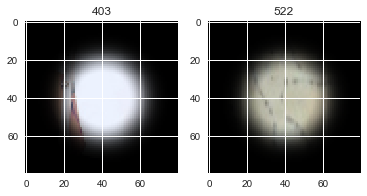

correlation:  0.8684126317041285
means:  -0.00020053852846912463  ,  0.1952468030564647


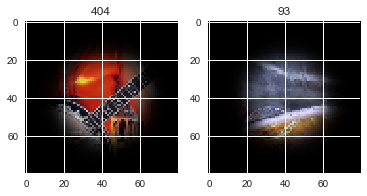

correlation:  0.9127796386806097
means:  -0.131762436338249  ,  0.22920086589016303


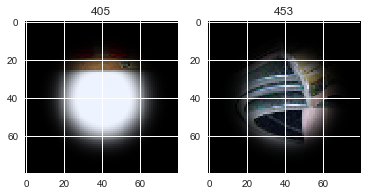

correlation:  0.8978002440311785
means:  -0.321607873338173  ,  -0.2148505608966454


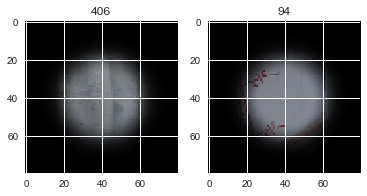

correlation:  0.7841683757087534
means:  0.9745456262467417  ,  0.06987668124782469


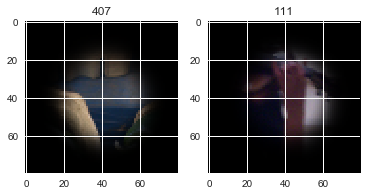

correlation:  0.8784626109431393
means:  -0.18402515189237054  ,  -0.3694664665786218


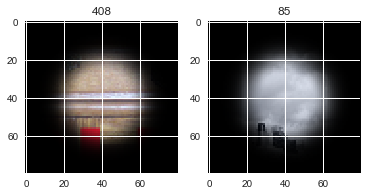

correlation:  0.7856436797773239
means:  0.27931415516030905  ,  -0.15313314564305533


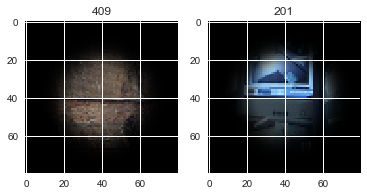

correlation:  0.8212545843187555
means:  -0.4645376429233485  ,  0.6826087786561285


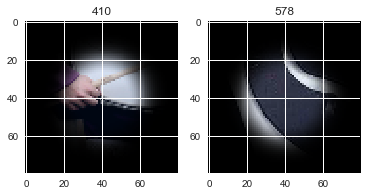

correlation:  0.937810332306747
means:  0.517887223583596  ,  0.3459989681119048


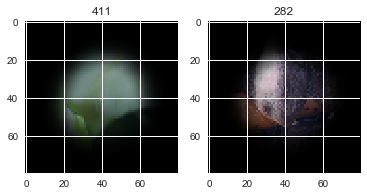

correlation:  0.8709534832313165
means:  -0.4210919881531453  ,  -0.7615651251553721


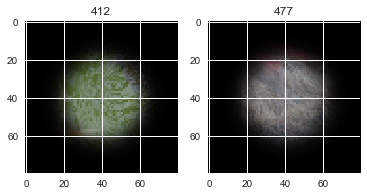

correlation:  0.8641653198826087
means:  -0.36544244068374354  ,  0.8170827181141102


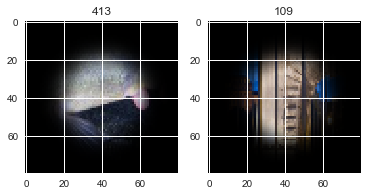

correlation:  0.8055879783840658
means:  -0.07272746721445392  ,  -0.008244846712949342


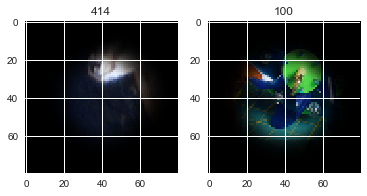

correlation:  0.8020435715422166
means:  0.309464783604415  ,  -1.4652639591358443


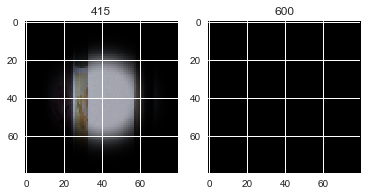

correlation:  0.9367415491983812
means:  0.30988562594939884  ,  -1.4652639591358443


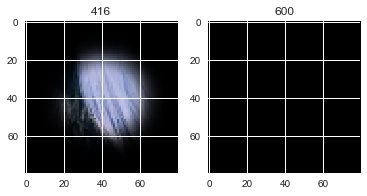

correlation:  0.6966002490975023
means:  -0.3721868247314445  ,  -0.1432715032729384


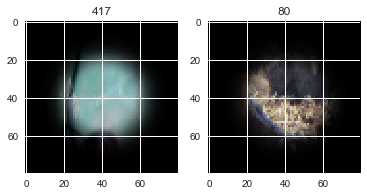

correlation:  0.8090059389694457
means:  0.14152578913105768  ,  0.1626212638523737


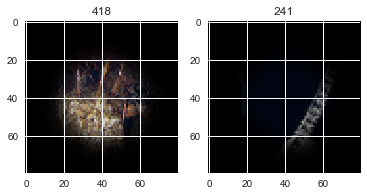

correlation:  0.9554300763919431
means:  -0.08177987270848573  ,  0.12280872125211749


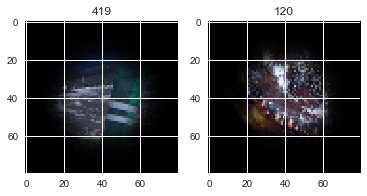

correlation:  0.8233806958390016
means:  0.2848176270883292  ,  -0.0473686557718054


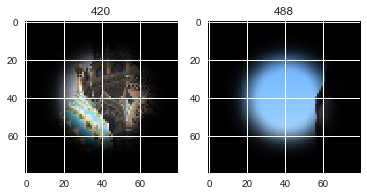

correlation:  0.8739761859498127
means:  -0.5628038874291211  ,  -0.32316347566563564


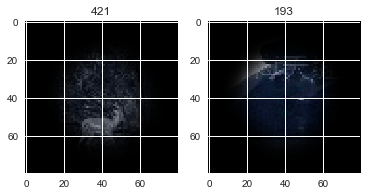

correlation:  0.9293949327487291
means:  -0.1201705135231164  ,  -0.1462984059511199


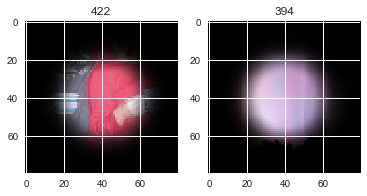

correlation:  0.7938132164628207
means:  0.09802656652564243  ,  -0.18944044960470488


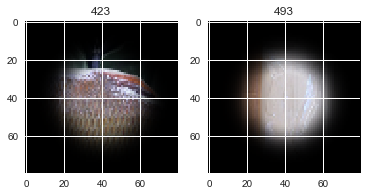

correlation:  0.8441798318322843
means:  -0.03864947045818726  ,  -0.0005628230205766769


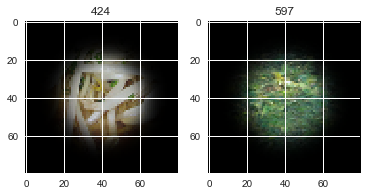

correlation:  0.9328496013248982
means:  -0.016635121522370292  ,  -0.18944044960470488


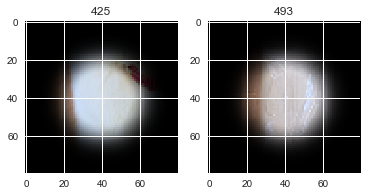

correlation:  0.8862297870775377
means:  0.20303576463003445  ,  0.268754912859123


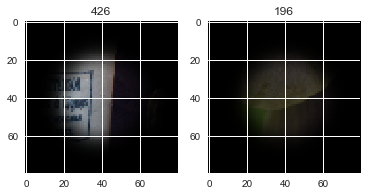

correlation:  0.89986697572272
means:  -0.22763760112337145  ,  0.3075279464879927


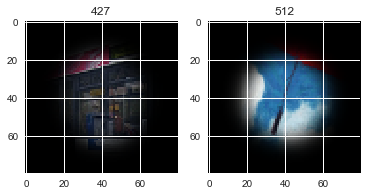

correlation:  0.9048268797566626
means:  -0.004233162567091442  ,  0.20051021523295762


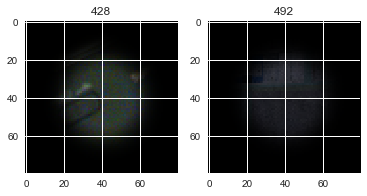

correlation:  0.9742611226159333
means:  -0.06551246663174326  ,  -1.4652639591358443


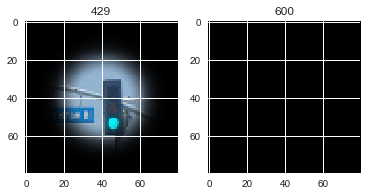

correlation:  0.8559116388170354
means:  0.313931453659047  ,  -0.20266878937433275


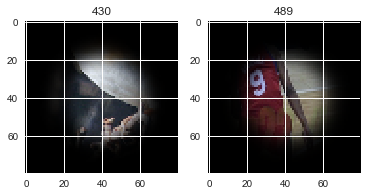

correlation:  0.8370434261087507
means:  0.09744698720836746  ,  0.005562768323611719


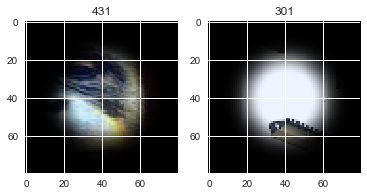

correlation:  0.7534610739684833
means:  0.3232054724889706  ,  0.3959403921666279


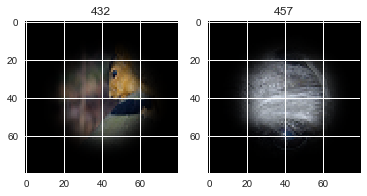

correlation:  0.90269837520435
means:  0.6540418432165833  ,  -0.11687010292077371


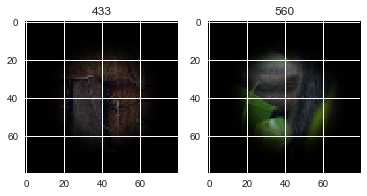

correlation:  0.8738460449851833
means:  -0.060262671996479084  ,  -0.20266878937433275


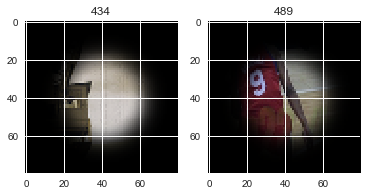

correlation:  0.8245281761170848
means:  0.028584970585862048  ,  -1.4652639591358443


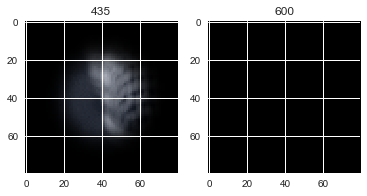

correlation:  0.8043517401719963
means:  0.09574656391301853  ,  0.20303576463003445


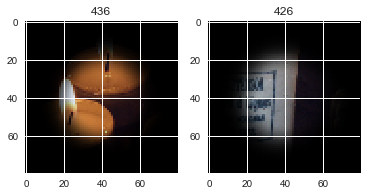

correlation:  0.9206593669926766
means:  0.10336252643920406  ,  -0.0473686557718054


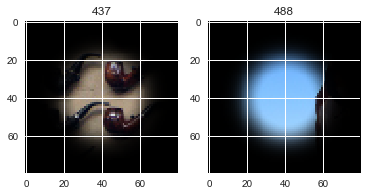

correlation:  0.9417914597640139
means:  0.2608175970608622  ,  -1.4652639591358443


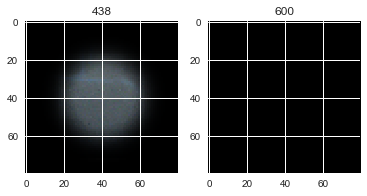

correlation:  0.8653389181207326
means:  -0.17286565650745941  ,  -0.4905477114638195


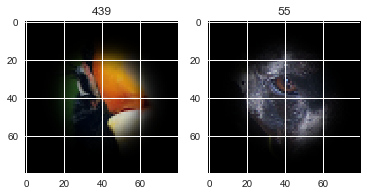

correlation:  0.7811980849513497
means:  -0.27353884127084155  ,  -0.44756343667632376


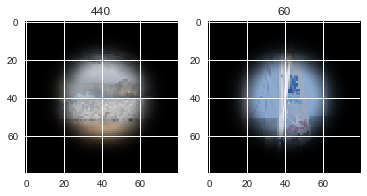

correlation:  0.7702348269807646
means:  0.40652279234326644  ,  0.24992710915253458


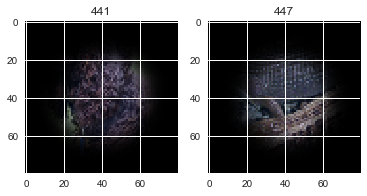

correlation:  0.9276101877500254
means:  -0.23274682334359936  ,  -1.4652639591358443


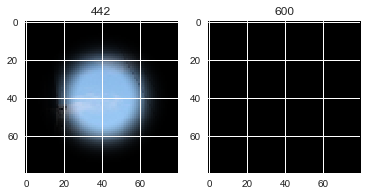

correlation:  0.7846833915995833
means:  -0.12207283775232089  ,  -0.04890416897988606


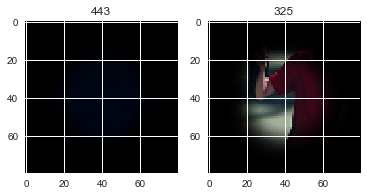

correlation:  0.8669477930793579
means:  0.15098398771737695  ,  -0.02154891935232901


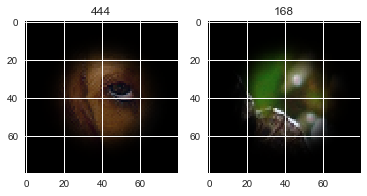

correlation:  0.8100044694524897
means:  -0.042332894228225164  ,  0.18503836416741715


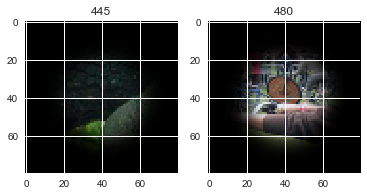

correlation:  0.8523750701868373
means:  -0.3177598959475037  ,  -0.23346224189049478


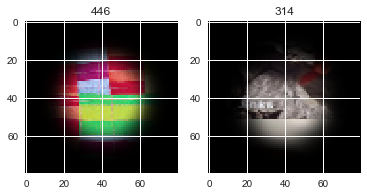

correlation:  0.7702348269807646
means:  0.24992710915253458  ,  0.40652279234326644


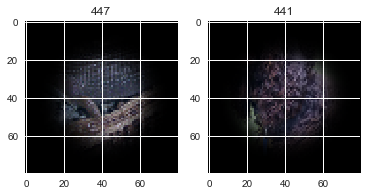

correlation:  0.8466031600775724
means:  -0.03685689641613766  ,  -0.5625802181765039


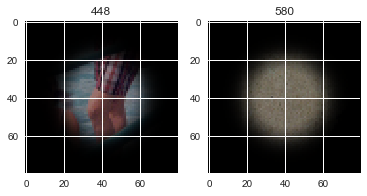

correlation:  0.8408912872317504
means:  0.052537457542540314  ,  0.07752500053947874


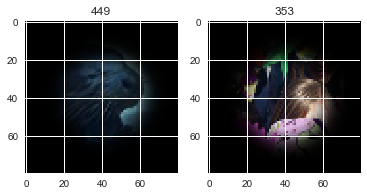

correlation:  0.9315585869510646
means:  0.45063659906718007  ,  0.46110788372828715


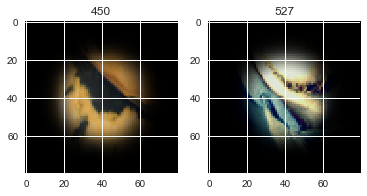

correlation:  0.8761497719931327
means:  -0.0762374720374198  ,  -0.053512432008689596


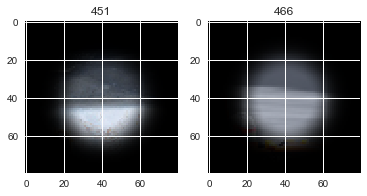

correlation:  0.7886312982521008
means:  0.48378716442332975  ,  0.11199608546375736


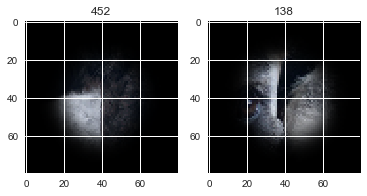

correlation:  0.9310048774273908
means:  0.22920086589016303  ,  0.09123209610212885


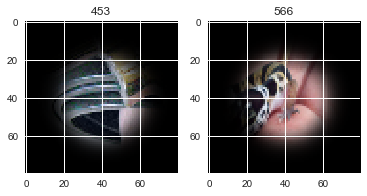

correlation:  0.8317517889867437
means:  0.1561009408550674  ,  -0.31194280837025057


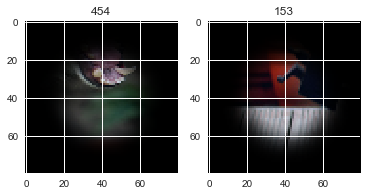

correlation:  0.748340900708178
means:  -0.1811911157195326  ,  -0.17021025152781163


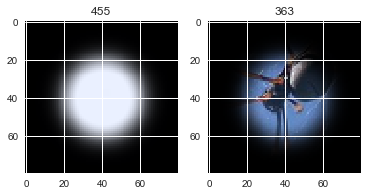

correlation:  0.9985445346652384
means:  -0.3129408315121396  ,  -1.4652639591358443


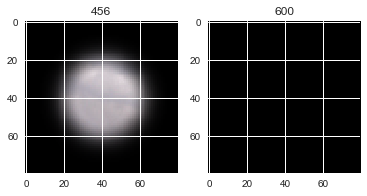

correlation:  0.9079367675896375
means:  0.3959403921666279  ,  0.39782240225559434


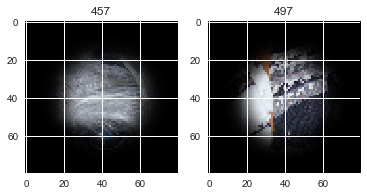

correlation:  0.885601191600307
means:  -0.42889682109315913  ,  -0.27674492459008976


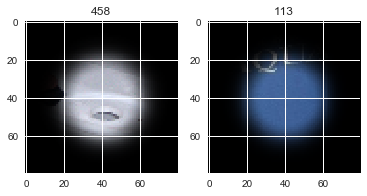

correlation:  0.8836530778288147
means:  -0.35666178404311427  ,  -0.5276760867776671


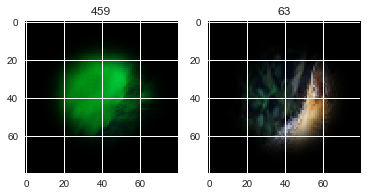

correlation:  0.9248054386466297
means:  -0.28106204801000456  ,  -0.09689739146776168


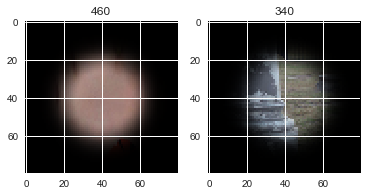

correlation:  0.8819458122423376
means:  -0.24145858233195458  ,  0.021646044254758877


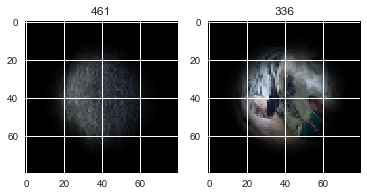

correlation:  0.8527497904782935
means:  -0.13193672561266062  ,  0.1261108510223152


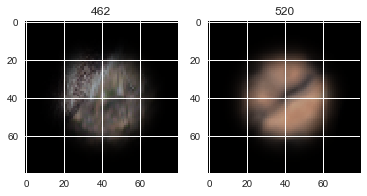

correlation:  0.770229574779821
means:  -0.012398701079188416  ,  0.11199608546375736


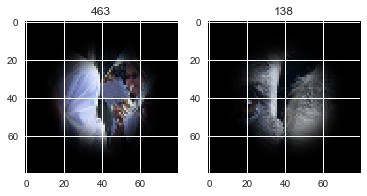

correlation:  0.9428474307472358
means:  -0.3742027586608717  ,  0.04415965587240464


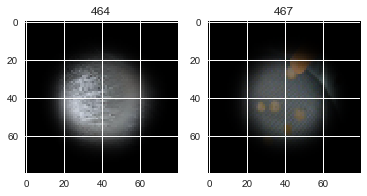

correlation:  0.908694966498317
means:  -0.21038957029846667  ,  -0.18595662863629894


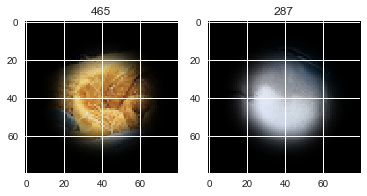

correlation:  0.8761497719931327
means:  -0.053512432008689596  ,  -0.0762374720374198


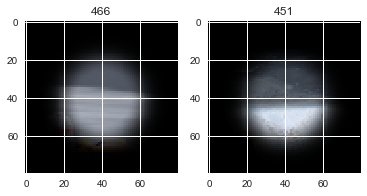

correlation:  0.9428474307472358
means:  0.04415965587240464  ,  -0.3742027586608717


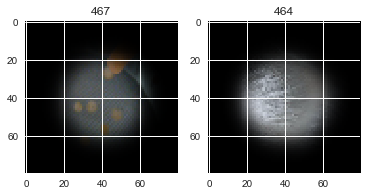

correlation:  0.9796270972540788
means:  1.1085569928351282  ,  -1.4652639591358443


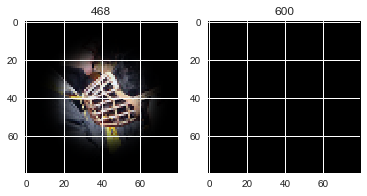

correlation:  0.8769447744685817
means:  -0.22759543142738525  ,  -0.22137483530074792


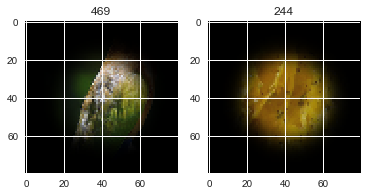

correlation:  0.8953095239920857
means:  -0.20503389577306477  ,  -0.20650664318926654


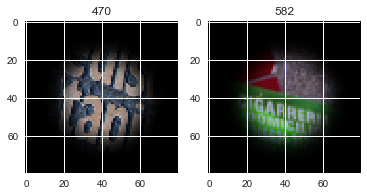

correlation:  0.804857219532364
means:  0.0691679125774749  ,  -0.04549143566265382


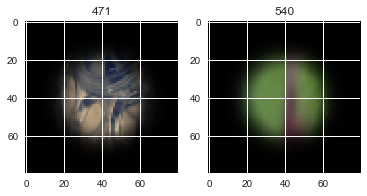

correlation:  0.8880733009097859
means:  -0.05633345229576443  ,  -0.22950910522720813


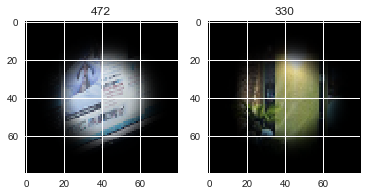

correlation:  0.9969308501764661
means:  0.07196999315278316  ,  -1.4652639591358443


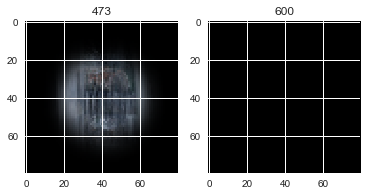

correlation:  0.9168285342830199
means:  -0.42865314863116527  ,  0.04374581292212882


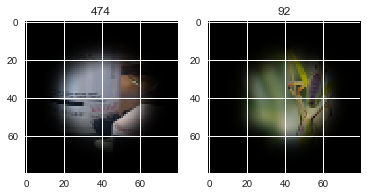

correlation:  0.9444069639079387
means:  0.36369794938547495  ,  -1.4652639591358443


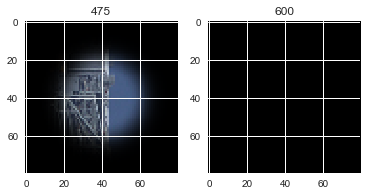

correlation:  0.8591093912579622
means:  -0.13374714588564407  ,  0.0003762299825217703


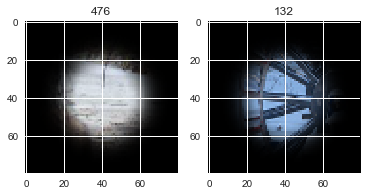

correlation:  0.8880918732257729
means:  -0.7615651251553721  ,  -0.24072233574173565


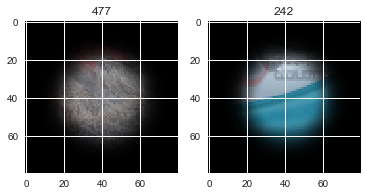

correlation:  0.8584288433750464
means:  0.336204442026465  ,  0.4149953954940294


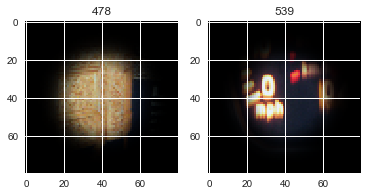

correlation:  0.9460552086330785
means:  0.11660906857447878  ,  -0.19434435931389737


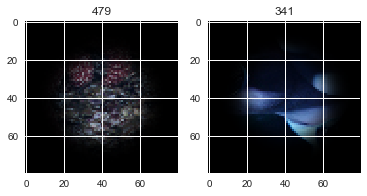

correlation:  0.8155644628061115
means:  0.18503836416741715  ,  -0.19434435931389737


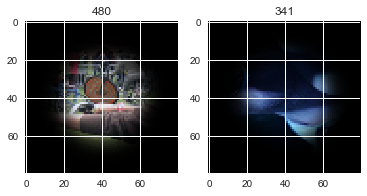

correlation:  0.7050155157483267
means:  -0.13021780675628228  ,  0.29681092218870325


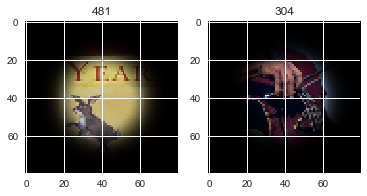

correlation:  0.8022598696634327
means:  -0.27152480849162414  ,  -0.4269945715327454


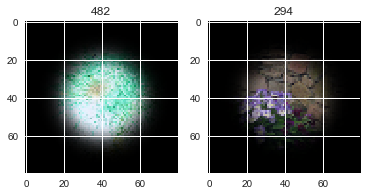

correlation:  0.7829894710096337
means:  0.48762612286941337  ,  -1.4652639591358443


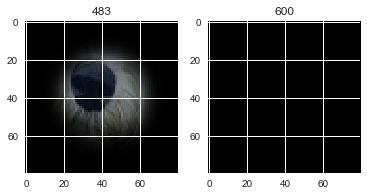

correlation:  0.8801713199443005
means:  -0.6569202788435398  ,  -0.0473686557718054


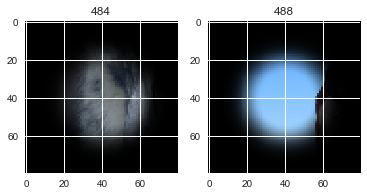

correlation:  0.8512880023948737
means:  -0.3435376979258626  ,  -0.23205604426966986


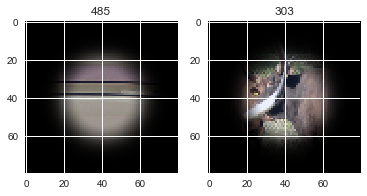

correlation:  0.8649984383393118
means:  -0.35526438799061794  ,  -0.1195669000506388


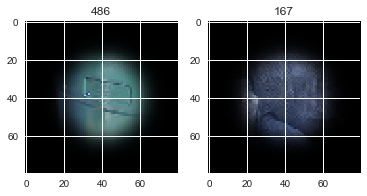

correlation:  0.8111476111258773
means:  -0.4124277011718995  ,  -0.47471834682655606


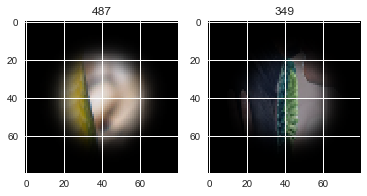

correlation:  0.9206593669926766
means:  -0.0473686557718054  ,  0.10336252643920406


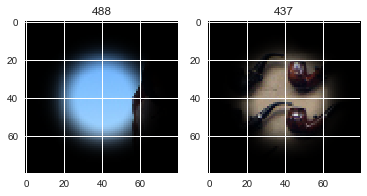

correlation:  0.954142057069442
means:  -0.20266878937433275  ,  -1.4652639591358443


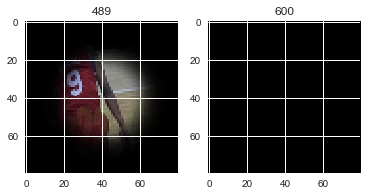

correlation:  0.872797908808676
means:  0.49885560234322585  ,  0.2778397974831313


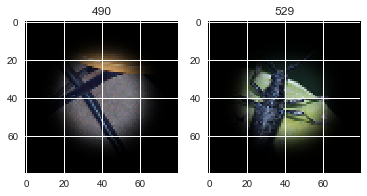

correlation:  0.8370385883304104
means:  -0.43750632536954187  ,  -0.21861548396119554


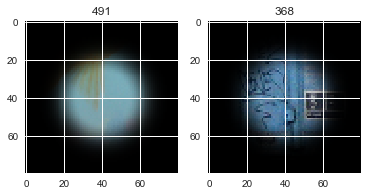

correlation:  0.9048268797566626
means:  0.20051021523295762  ,  -0.004233162567091442


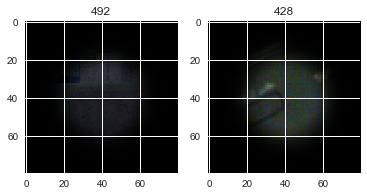

correlation:  0.9328496013248982
means:  -0.18944044960470488  ,  -0.016635121522370292


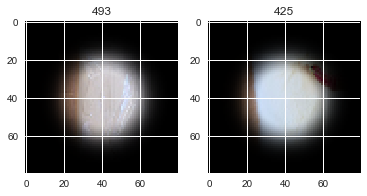

correlation:  0.8145143895024597
means:  0.19819632024255282  ,  -0.00848630972381635


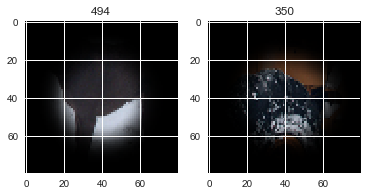

correlation:  0.8820074898631746
means:  0.22369806996618324  ,  0.46052382135698006


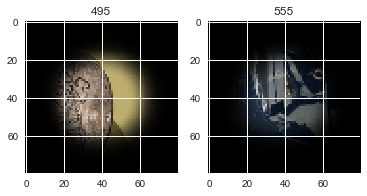

correlation:  0.8340347274890342
means:  0.8959340457930629  ,  -0.11687010292077371


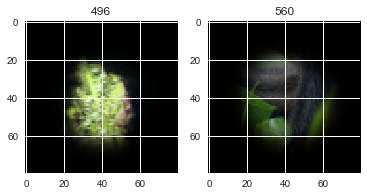

correlation:  0.9079367675896375
means:  0.39782240225559434  ,  0.3959403921666279


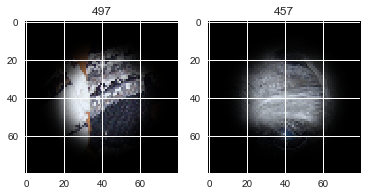

correlation:  0.9120919657929116
means:  -0.17747756041662202  ,  -0.45059812038959707


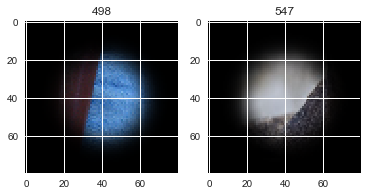

correlation:  0.8745153948026085
means:  -0.38198677094286176  ,  -0.25180705796730607


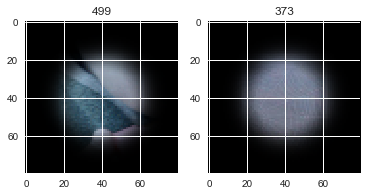

correlation:  0.8516178200432815
means:  0.04822459664623588  ,  0.012947724607270233


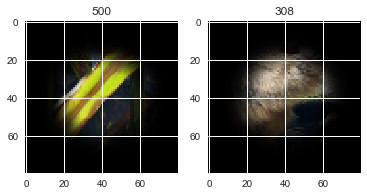

correlation:  0.7993231196393588
means:  -0.30682689955682635  ,  0.13593330655445476


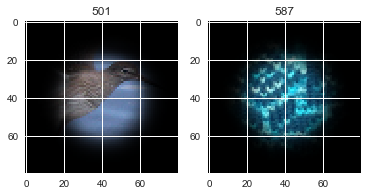

correlation:  0.7672520494222375
means:  -0.18406062655178748  ,  -0.3448641218821176


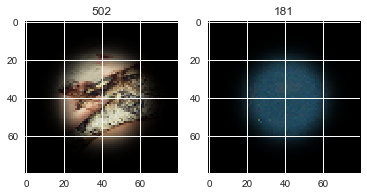

correlation:  0.9511221492902682
means:  0.2125954258594059  ,  -0.20650664318926654


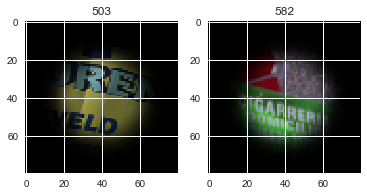

correlation:  0.9569696500807898
means:  0.4886866504271384  ,  0.33994792123101714


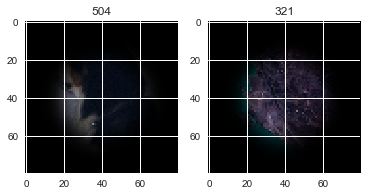

correlation:  0.8734822659993849
means:  0.16771263073155968  ,  -0.45003981277939153


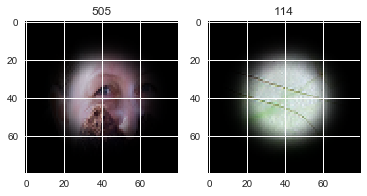

correlation:  0.9105649590408974
means:  0.21418969143672958  ,  0.12362315660638451


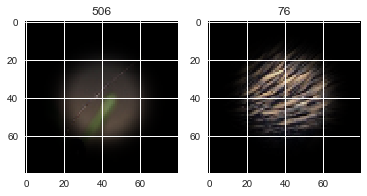

correlation:  0.9511548821985194
means:  0.04727541757152543  ,  0.3729076701043097


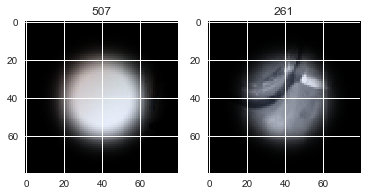

correlation:  0.920239643110495
means:  -0.007941477204459334  ,  -0.06163758076803607


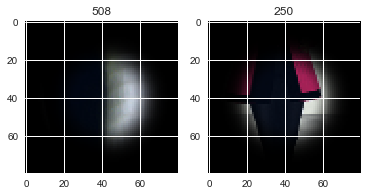

correlation:  0.8479670017513034
means:  -0.10937591312392483  ,  0.21418969143672958


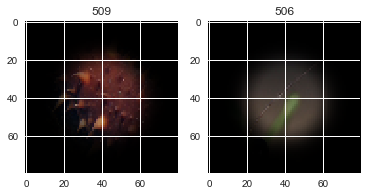

correlation:  0.8504505274269077
means:  -0.08054134026742994  ,  -0.27674492459008976


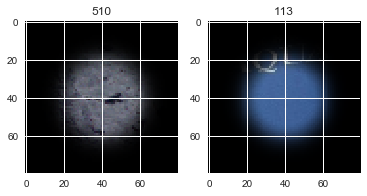

correlation:  0.8817644908269847
means:  0.6077156419794822  ,  -1.4652639591358443


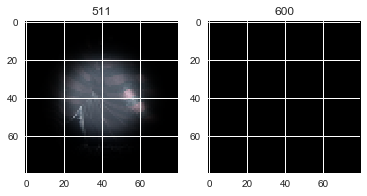

correlation:  0.89986697572272
means:  0.3075279464879927  ,  -0.22763760112337145


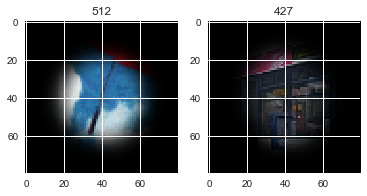

correlation:  0.8735392498784725
means:  -0.3228741210175776  ,  -0.3007389421332138


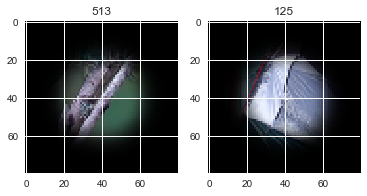

correlation:  0.8853980483652745
means:  0.42778863624694474  ,  -0.5977646659858018


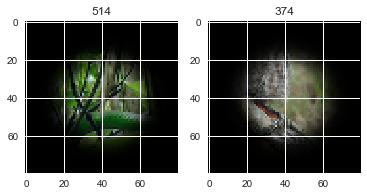

correlation:  0.8931862462267163
means:  0.2891846240517956  ,  -0.24169267877107722


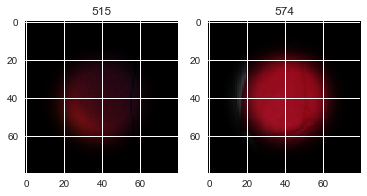

correlation:  0.8089459203777983
means:  0.02511879506625989  ,  0.2904183480068572


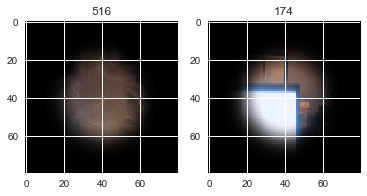

correlation:  0.8187545118344085
means:  -0.16731013466440206  ,  0.42453812450286


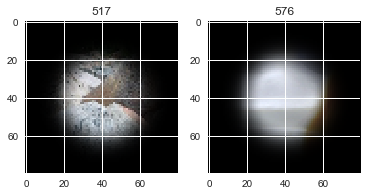

correlation:  0.8390884989949311
means:  -0.16715259105148889  ,  0.46052382135698006


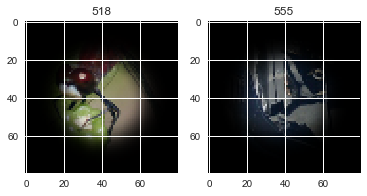

correlation:  0.9183458121598932
means:  -0.5490275932655944  ,  -0.27869150754938543


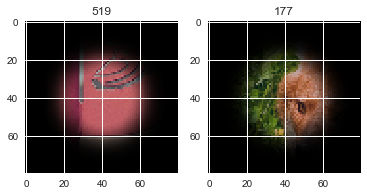

correlation:  0.879643795430299
means:  0.1261108510223152  ,  -0.2724161570738844


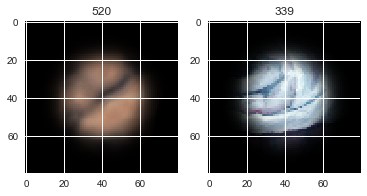

correlation:  0.8131268039954798
means:  0.38117554879918925  ,  0.061733236328723115


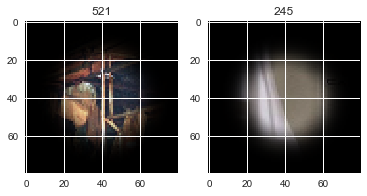

correlation:  0.8349937943012592
means:  -0.1288590907725604  ,  -0.13745139668060616


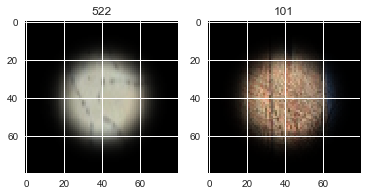

correlation:  0.7985821717186532
means:  -0.2327951173965239  ,  -0.35666178404311427


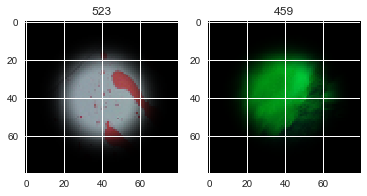

correlation:  0.949890308032079
means:  0.30385869269925814  ,  -1.4652639591358443


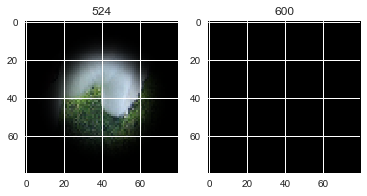

correlation:  0.8407797733631668
means:  0.17542684795662541  ,  -0.15313314564305533


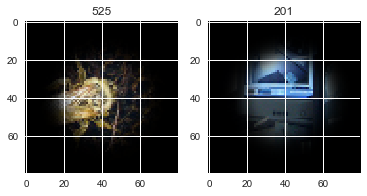

correlation:  0.7477727359490812
means:  -0.166928082857111  ,  -0.03214481773179042


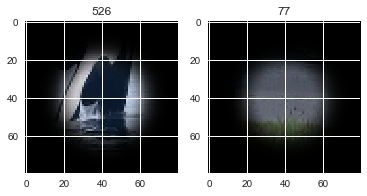

correlation:  0.9315585869510646
means:  0.46110788372828715  ,  0.45063659906718007


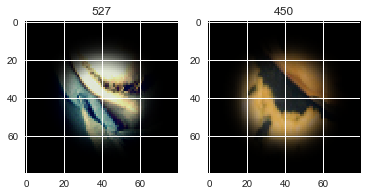

correlation:  0.8610561766090707
means:  0.273516530233975  ,  0.4254889379747222


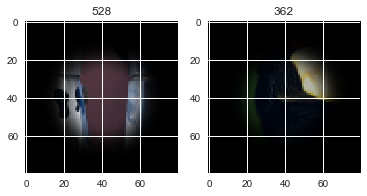

correlation:  0.8930742253712052
means:  0.2778397974831313  ,  -0.18944044960470488


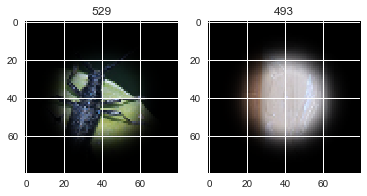

correlation:  0.7568240402957245
means:  0.06939247971260841  ,  -0.0762374720374198


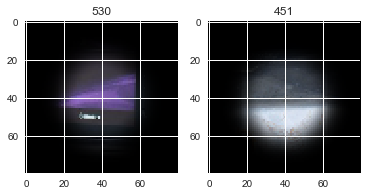

correlation:  0.8670365796508199
means:  -0.2005603420937807  ,  -0.04760401837163633


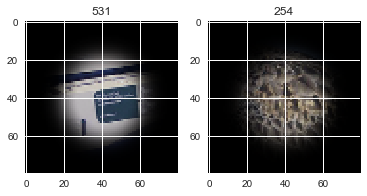

correlation:  0.8101945413387232
means:  -0.3719115692964388  ,  -0.607679315442089


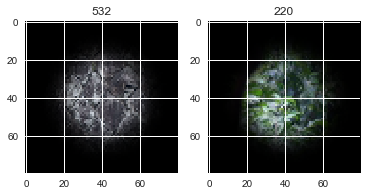

correlation:  0.9520679104858136
means:  -0.46529195416608665  ,  -0.37131820083567685


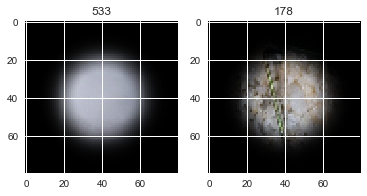

correlation:  0.8429554111660171
means:  0.017229688540591558  ,  0.22920086589016303


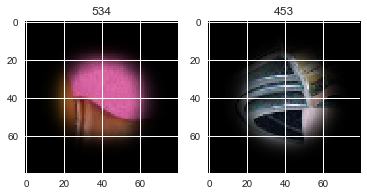

correlation:  0.7549446198904084
means:  0.3780708759739081  ,  0.22369806996618324


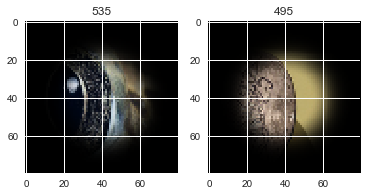

correlation:  0.784233832875375
means:  0.2821858789483245  ,  0.39810359949827134


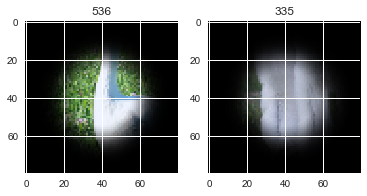

correlation:  0.9285929278074709
means:  0.024713037780595602  ,  -0.28241241911884724


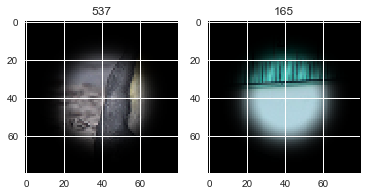

correlation:  0.8688285320882182
means:  -0.3190890919583182  ,  -0.018510609956125836


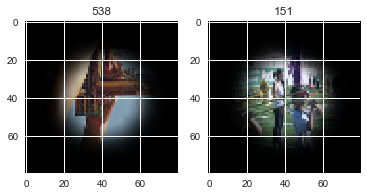

correlation:  0.8631586546389328
means:  0.4149953954940294  ,  0.27067311780831543


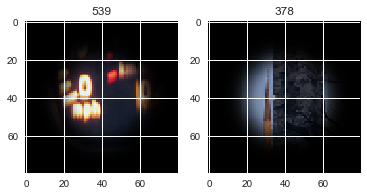

correlation:  0.9674398234414269
means:  -0.04549143566265382  ,  -1.4652639591358443


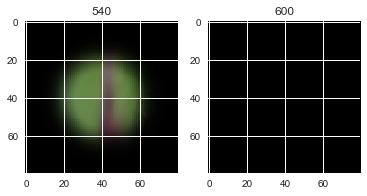

correlation:  0.8921367230900121
means:  -0.44727471958703635  ,  -0.33604937177111605


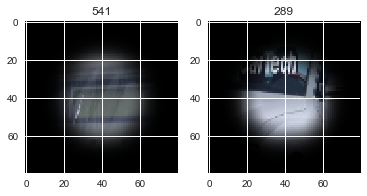

correlation:  0.8776218514301972
means:  -0.2981930737981295  ,  0.09123209610212885


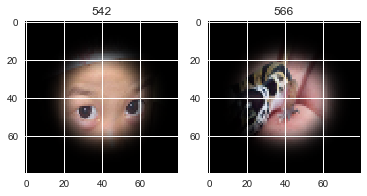

correlation:  0.8252273858569749
means:  0.06715801183990967  ,  0.2125954258594059


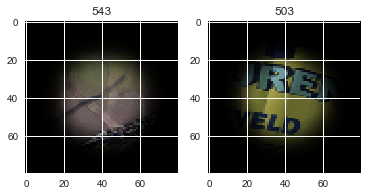

correlation:  0.8987648368576069
means:  0.2119823745030726  ,  -0.2293109657430742


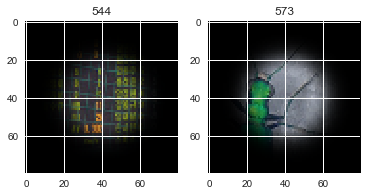

correlation:  0.7936715704560243
means:  -0.23464854458363707  ,  -0.45059812038959707


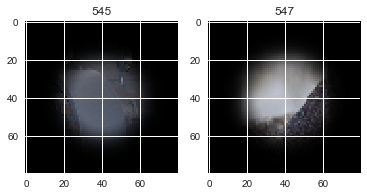

correlation:  0.9112908589914758
means:  -0.3138981778484005  ,  -1.4652639591358443


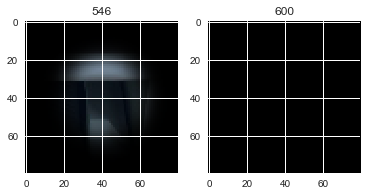

correlation:  0.9120919657929116
means:  -0.45059812038959707  ,  -0.17747756041662202


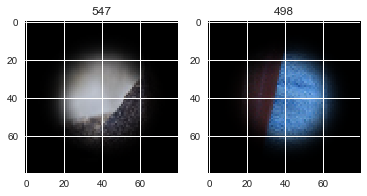

correlation:  0.9030119409656183
means:  0.798014403869771  ,  -0.12549715786153193


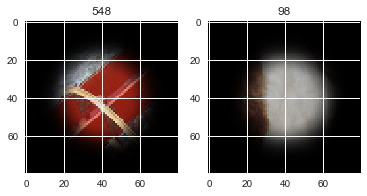

correlation:  0.8948430511136032
means:  -0.06823380520674732  ,  -1.4652639591358443


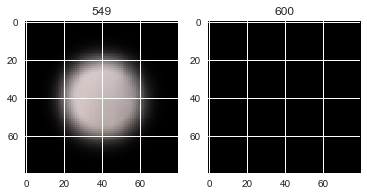

correlation:  0.9070167886969244
means:  -0.163333911457193  ,  -1.4652639591358443


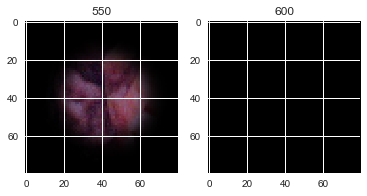

correlation:  0.7808158994792278
means:  0.1867588732651693  ,  0.3882724794840446


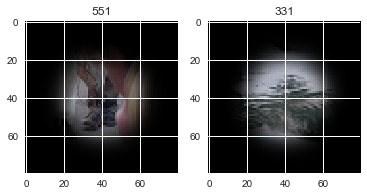

correlation:  0.9056011457687902
means:  -0.19430133791028623  ,  -0.607679315442089


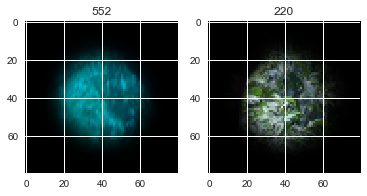

correlation:  0.7944382321065778
means:  0.11718248029617512  ,  -0.006046404356143851


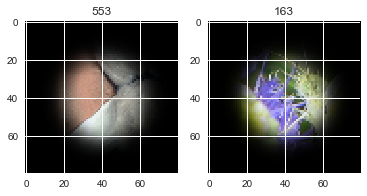

correlation:  0.908789676530151
means:  0.15019961310726462  ,  0.0447607037522935


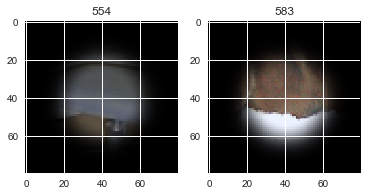

correlation:  0.9275262403619232
means:  0.46052382135698006  ,  0.30988562594939884


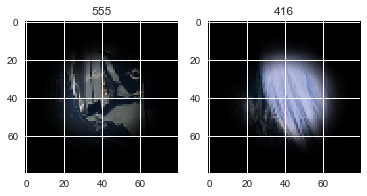

correlation:  0.8351664181769921
means:  0.3742588478190374  ,  0.8912198764065405


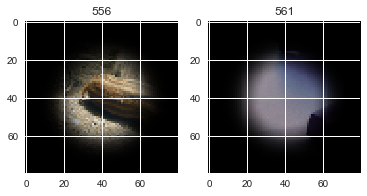

correlation:  0.745022642915647
means:  -0.16102899662925838  ,  -0.006962551177307425


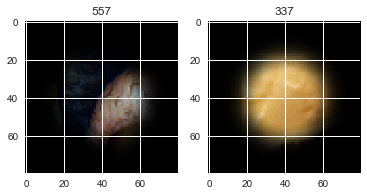

correlation:  0.8567305187984093
means:  0.251644983441126  ,  -1.4652639591358443


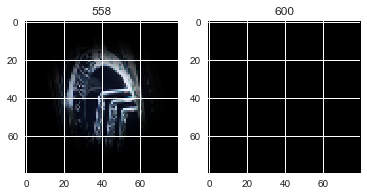

correlation:  0.8294355507933754
means:  -0.40147097543611304  ,  -0.2981930737981295


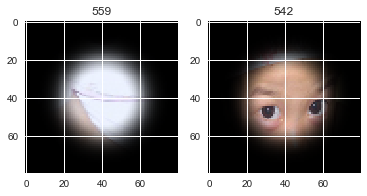

correlation:  0.90269837520435
means:  -0.11687010292077371  ,  0.6540418432165833


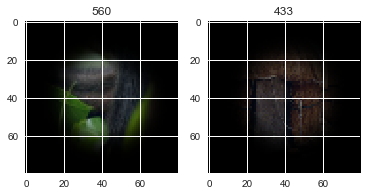

correlation:  0.8552388553397844
means:  0.8912198764065405  ,  0.5704864383134401


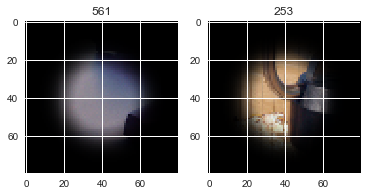

correlation:  0.88908277530827
means:  -0.3405142643750854  ,  -0.055573302896500525


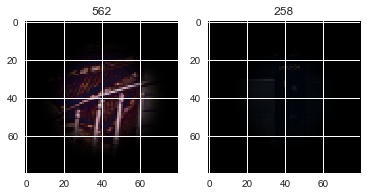

correlation:  0.7895356780349259
means:  0.3137170361166692  ,  0.5903754949457847


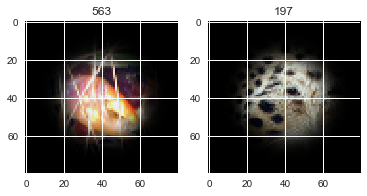

correlation:  0.8069874168460167
means:  -0.29996710742323707  ,  -0.13948185406640667


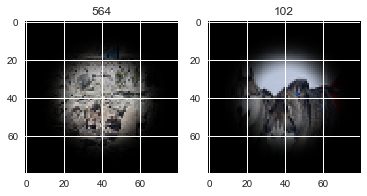

correlation:  0.8182179094466117
means:  -0.6488351720042389  ,  -0.40298893451196327


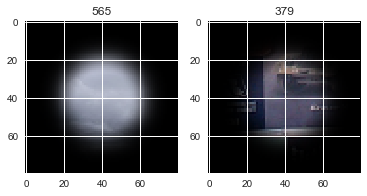

correlation:  0.9500846878596468
means:  0.09123209610212885  ,  0.21316801546147496


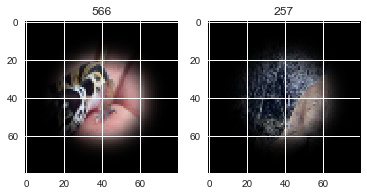

correlation:  0.849946098776234
means:  -0.020726156975098886  ,  0.2824321557377024


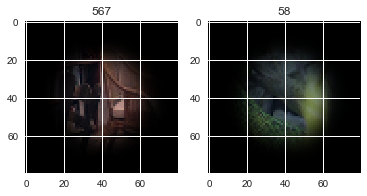

correlation:  0.8400627338233915
means:  0.47350992390901414  ,  -0.3138981778484005


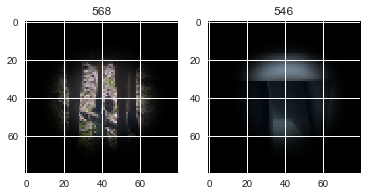

correlation:  0.8531575212996324
means:  -0.15834300327490755  ,  -0.19434435931389737


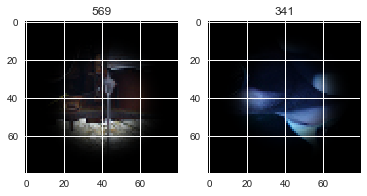

correlation:  0.7604795946597532
means:  0.9903468847300657  ,  0.03145066062417047


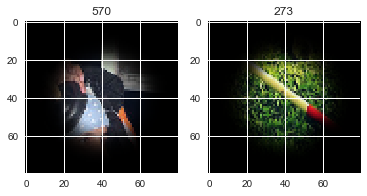

correlation:  0.855563268648908
means:  0.1749262463458826  ,  0.28084310191060285


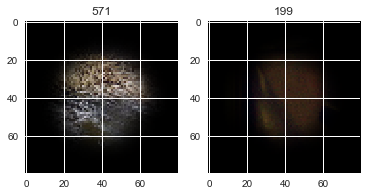

correlation:  0.875478177320244
means:  -0.017923520764866318  ,  -0.21214824538114307


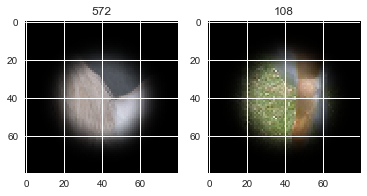

correlation:  0.8987648368576069
means:  -0.2293109657430742  ,  0.2119823745030726


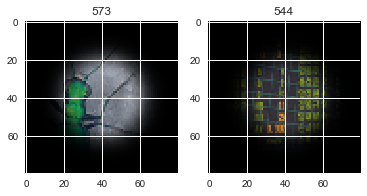

correlation:  0.8931862462267163
means:  -0.24169267877107722  ,  0.2891846240517956


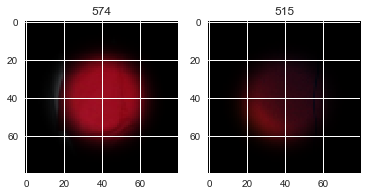

correlation:  0.7702406387376424
means:  -0.19046260442146898  ,  0.017229688540591558


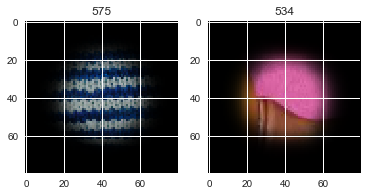

correlation:  0.8187545118344085
means:  0.42453812450286  ,  -0.16731013466440206


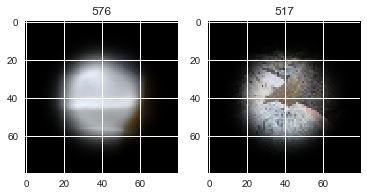

correlation:  0.7685521718031841
means:  0.3181036971366125  ,  -0.06094974842433727


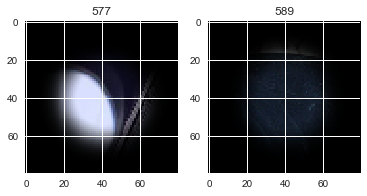

correlation:  0.8566232834693486
means:  0.6826087786561285  ,  0.3420342462938204


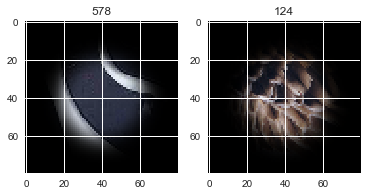

correlation:  0.7941869406466823
means:  -0.1148928097323958  ,  0.05135633855604887


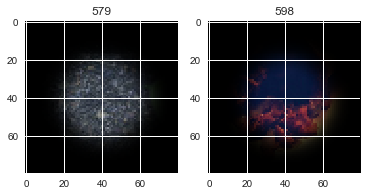

correlation:  0.9261251201558622
means:  -0.5625802181765039  ,  -0.4258509475176776


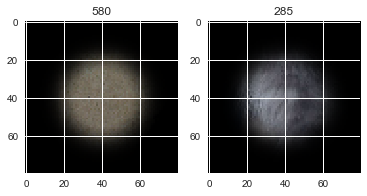

correlation:  0.7108920845945277
means:  0.2532508654138547  ,  0.48762612286941337


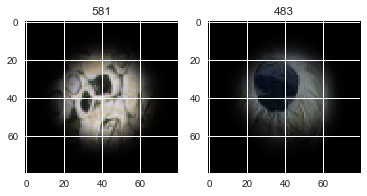

correlation:  0.9511221492902682
means:  -0.20650664318926654  ,  0.2125954258594059


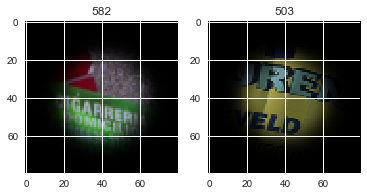

correlation:  0.908789676530151
means:  0.0447607037522935  ,  0.15019961310726462


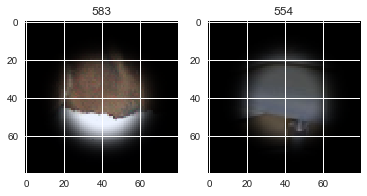

correlation:  0.840371290498734
means:  -0.48297140908619035  ,  0.49885560234322585


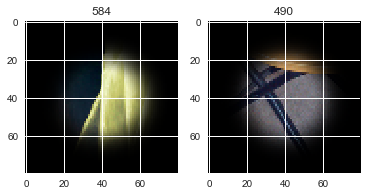

correlation:  0.879843460016995
means:  -0.6822192025815755  ,  -0.548645778475016


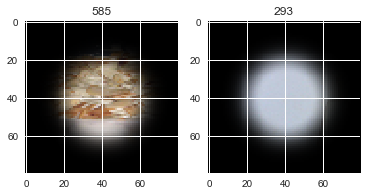

correlation:  0.784579753774652
means:  -0.001262896038482685  ,  -0.45059812038959707


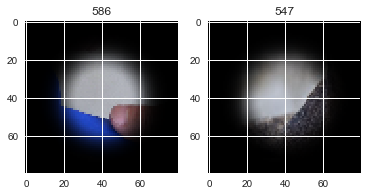

correlation:  0.8020668780636577
means:  0.13593330655445476  ,  0.16658285081265592


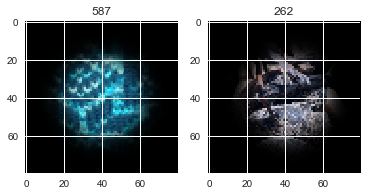

correlation:  0.8268413710252238
means:  -0.11584481382573077  ,  -0.2265047681771886


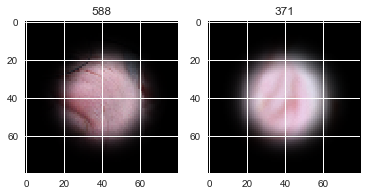

correlation:  0.7685521718031841
means:  -0.06094974842433727  ,  0.3181036971366125


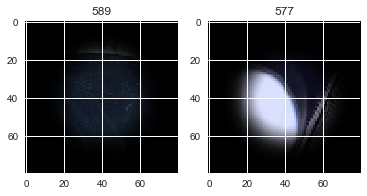

correlation:  0.8209519145289725
means:  -0.07799501091751017  ,  -0.4476363130048931


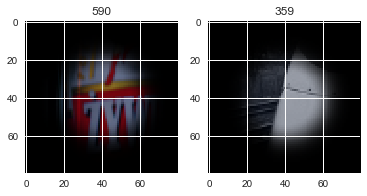

correlation:  0.8762006273906594
means:  0.25922384554585337  ,  -1.4652639591358443


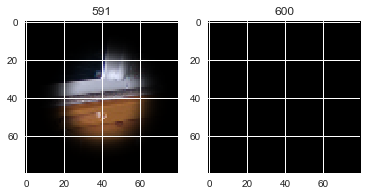

correlation:  0.9426159846934076
means:  -0.4128563184194697  ,  -0.4999931019352017


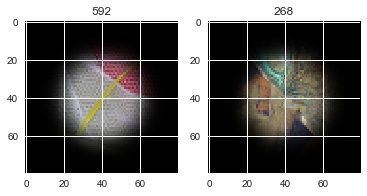

correlation:  0.8142518298240862
means:  0.1392162748667736  ,  -0.060262671996479084


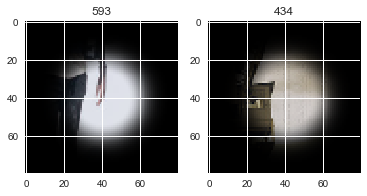

correlation:  0.7539735624118507
means:  -0.9328859918299078  ,  0.9903468847300657


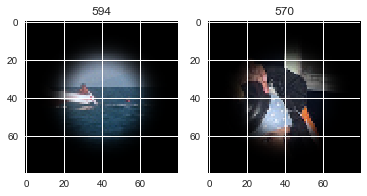

correlation:  0.8285018855172664
means:  -0.05677662766849905  ,  -0.40147097543611304


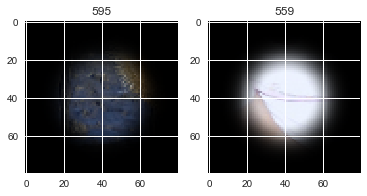

correlation:  0.8688098080857127
means:  0.12708082282781605  ,  -0.11450134992049357


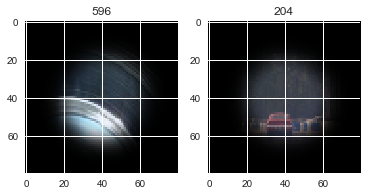

correlation:  0.8441798318322843
means:  -0.0005628230205766769  ,  -0.03864947045818726


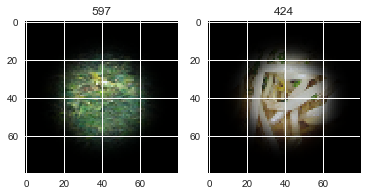

correlation:  0.7941869406466823
means:  0.05135633855604887  ,  -0.1148928097323958


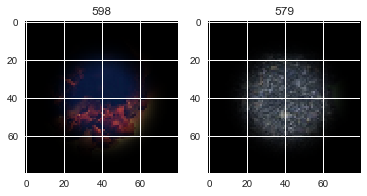

correlation:  0.8782561898137582
means:  -0.13341370742542982  ,  0.11198469648363789


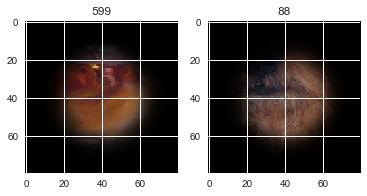

correlation:  0.9991135558120937
means:  -1.4652639591358443  ,  0.09790282763563535


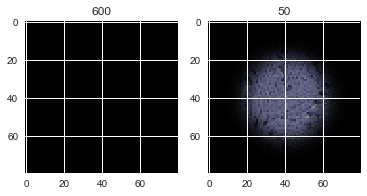

In [26]:
# Checking which images seem to generate similar responses, after the day to day variation has been
# taken out!

import seaborn as sns; 
sns.set()

corrs = dcd.transpose().corr()
# set diagonal correlations to NaN so that they are ignored in min/max search
corrs.mask(corrs == 1, inplace=True) 

# For each stimuli/image, this gives the other stimuli that had the highest correlation
max_corrs = corrs.idxmax()

for idx, idx2 in max_corrs.iteritems():
    img1 = stim[idx]
    img2 = stim[idx2]
    
    
    print("correlation: ", corrs[idx][idx2])
    print("means: " , sorted_means[idx], " , ", sorted_means[idx2])
    plt.figure()
    plt.subplot(1,2,1)
    plt.imshow(img1)
    plt.title(str(idx))
    
    plt.subplot(1,2,2)
    plt.imshow(img2)
    plt.title(str(idx2))
    plt.show()
    
    #diffs = np.abs(img1 - img2)
    #sns.heatmap(diffs[:,:,0])
    #sns.heatmap(diffs[:,:,1], cmap="Blues")
    #sns.heatmap(diffs[:,:,2], cmap="Greens")

    

correlation:  -0.6889802742525584
means:  0.09790282763563535  ,  0.48378716442332975


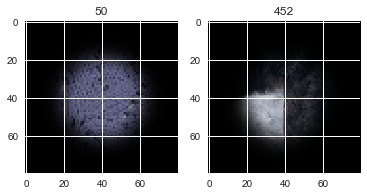

correlation:  -0.8213438461929908
means:  -0.13426859887094034  ,  -0.22489565565010364


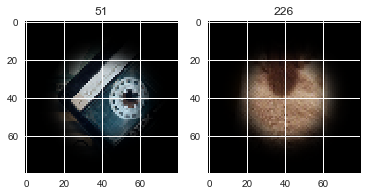

correlation:  -0.7477250042516674
means:  -0.20802465596677178  ,  0.38117554879918925


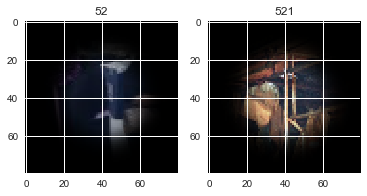

correlation:  -0.8423045407533442
means:  0.5784372181080357  ,  -0.4645376429233485


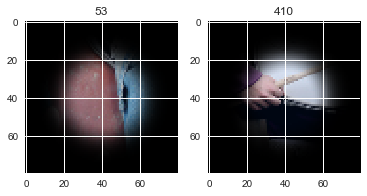

correlation:  -0.8549260581576722
means:  -0.26339431584944106  ,  -0.01292578751739587


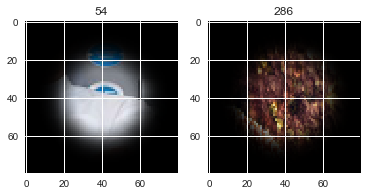

correlation:  -0.8189002543094607
means:  -0.4905477114638195  ,  0.021646044254758877


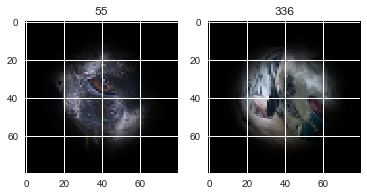

correlation:  -0.7263356946160268
means:  -0.16088523623248116  ,  -0.36537828083037655


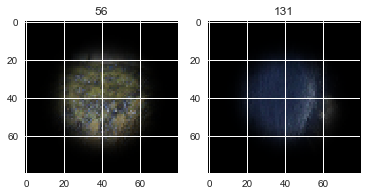

correlation:  -0.7544081628719377
means:  0.07663497895688184  ,  0.18191237324382498


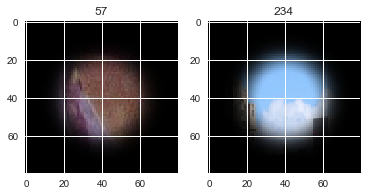

correlation:  -0.779622902241603
means:  0.2824321557377024  ,  -0.20412305442947687


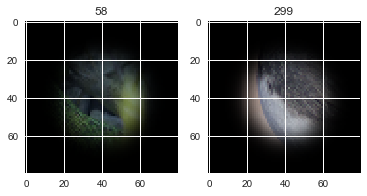

correlation:  -0.8794232899985179
means:  -0.23870946017719818  ,  0.0447607037522935


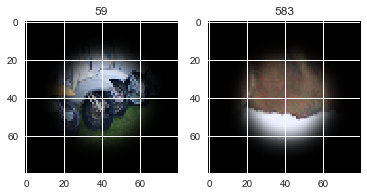

correlation:  -0.8315330962311682
means:  -0.44756343667632376  ,  0.11660906857447878


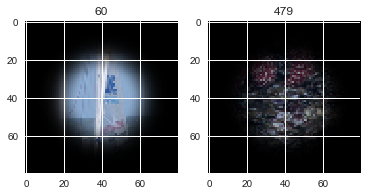

correlation:  -0.8289580234268934
means:  0.21725205049041166  ,  -0.548645778475016


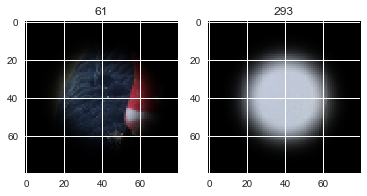

correlation:  -0.8186347276013307
means:  -0.5272235073168551  ,  0.08754166882415361


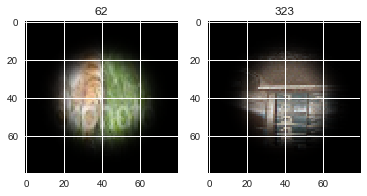

correlation:  -0.7361751168806953
means:  -0.5276760867776671  ,  0.2798585618935452


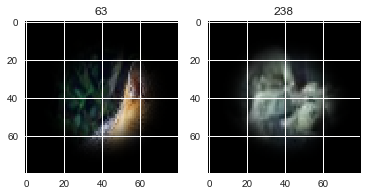

correlation:  -0.7386379042662758
means:  0.2617947617512303  ,  -0.3833303677120933


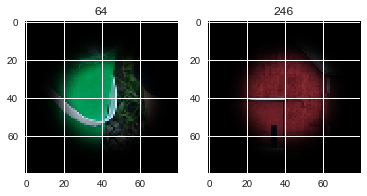

correlation:  -0.7316221226463759
means:  -0.06937676227558293  ,  0.3780708759739081


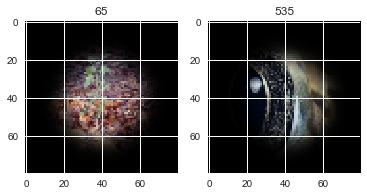

correlation:  -0.7352038058290323
means:  -0.16900922623834377  ,  0.273516530233975


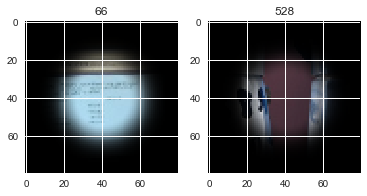

correlation:  -0.789640708353929
means:  0.048428039865389155  ,  -0.023630888418542415


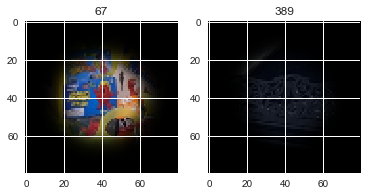

correlation:  -0.7916439178618876
means:  0.27139074270477337  ,  -0.042332894228225164


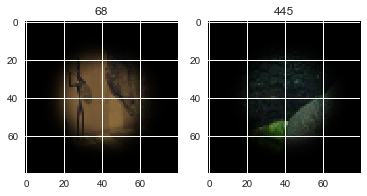

correlation:  -0.745640611767241
means:  0.2845399671663753  ,  0.22284639926486838


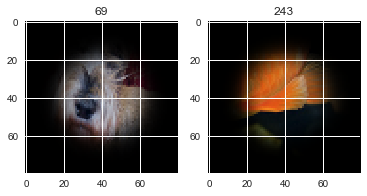

correlation:  -0.742416831233707
means:  0.0763883335290822  ,  0.15098398771737695


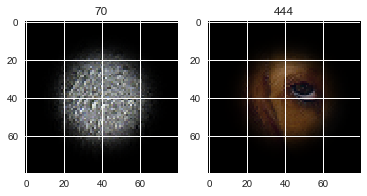

correlation:  -0.7863670360352546
means:  0.1600705794431766  ,  -0.042332894228225164


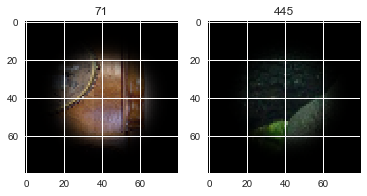

correlation:  -0.8714271575838319
means:  -0.2905123846183401  ,  -0.19046260442146898


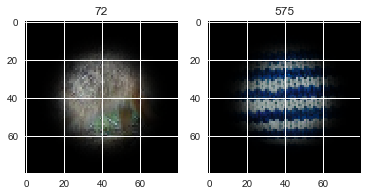

correlation:  -0.8411088786634067
means:  -0.3408675241840722  ,  -0.09689739146776168


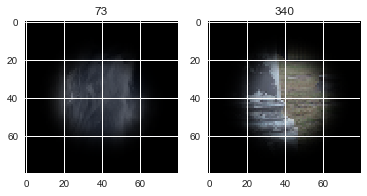

correlation:  -0.7080256503757731
means:  -0.12428621723159468  ,  0.0447607037522935


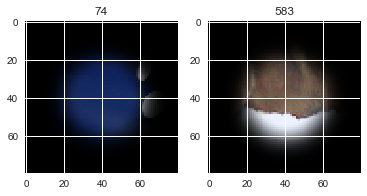

correlation:  -0.7403500651424626
means:  -0.2175506514205424  ,  0.3882724794840446


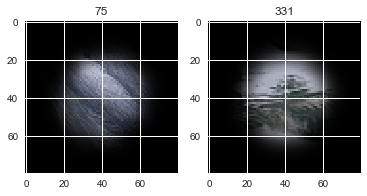

correlation:  -0.8409936531832694
means:  0.12362315660638451  ,  -0.6822192025815755


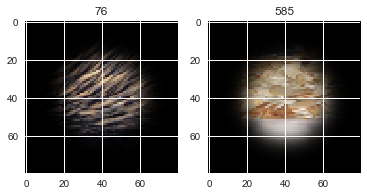

correlation:  -0.8339736554270827
means:  -0.03214481773179042  ,  -0.6822192025815755


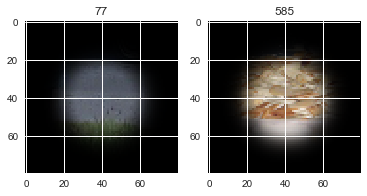

correlation:  -0.7278384893205835
means:  0.12846847740135858  ,  -0.42889682109315913


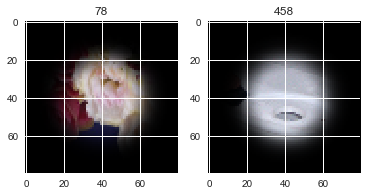

correlation:  -0.8403497267997853
means:  0.4350377947716831  ,  0.36326101736422833


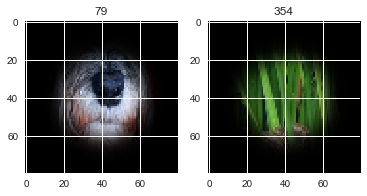

correlation:  -0.7659179339678003
means:  -0.1432715032729384  ,  -0.2265047681771886


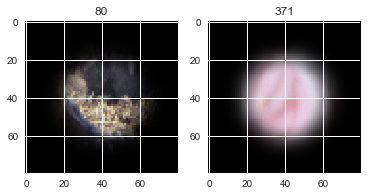

correlation:  -0.8312444113302997
means:  0.472712622538051  ,  -0.3371151537184192


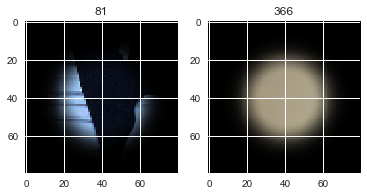

correlation:  -0.7949872301377623
means:  0.30817815650290864  ,  -0.20266878937433275


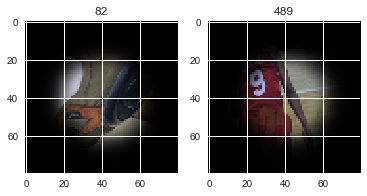

correlation:  -0.655766767844109
means:  0.041419216715228746  ,  -0.45680547468531446


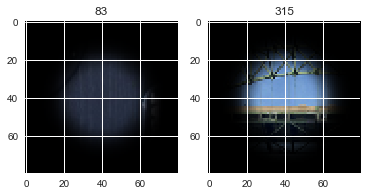

correlation:  -0.818125633234593
means:  0.2635985743841671  ,  -0.16811896688439287


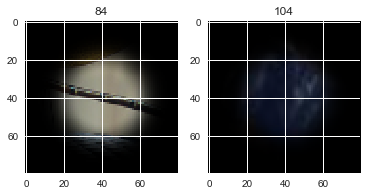

correlation:  -0.8967418474911839
means:  -0.3694664665786218  ,  0.1626212638523737


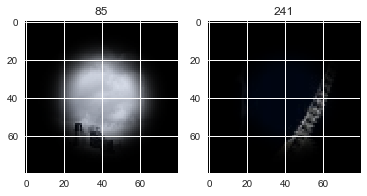

correlation:  -0.8904928837305668
means:  -0.03606860508674857  ,  -1.4652639591358443


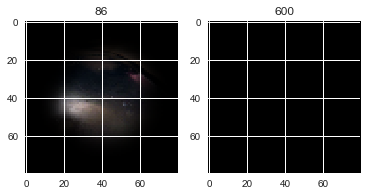

correlation:  -0.7707353393351154
means:  -0.34437304437901217  ,  0.34306009411848915


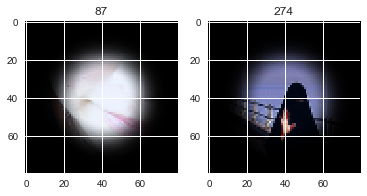

correlation:  -0.7629012000494223
means:  0.11198469648363789  ,  -0.09022574580806664


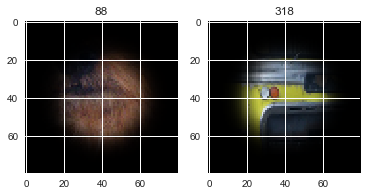

correlation:  -0.8345928920550355
means:  0.7311946335856094  ,  -0.19805722044624077


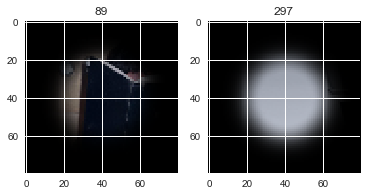

correlation:  -0.771428683276342
means:  0.3070458508490839  ,  -0.25180705796730607


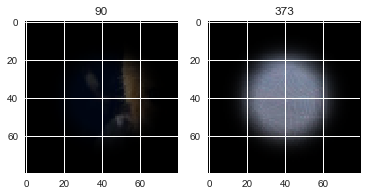

correlation:  -0.8019367345167435
means:  -0.17120152916734802  ,  -0.2657944655703399


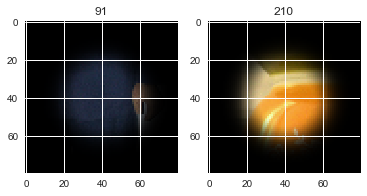

correlation:  -0.7175916732277032
means:  0.04374581292212882  ,  0.07321383051743724


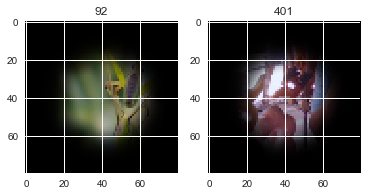

correlation:  -0.8888100784859374
means:  0.1952468030564647  ,  -1.4652639591358443


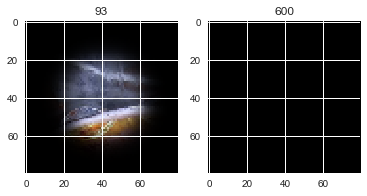

correlation:  -0.8294606889100639
means:  -0.2148505608966454  ,  -0.17286565650745941


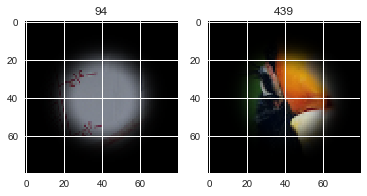

correlation:  -0.8256812503382991
means:  -0.29027599478032395  ,  -0.6446014672923197


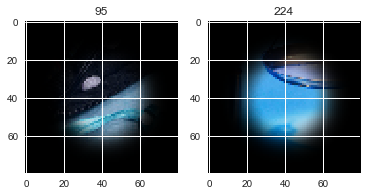

correlation:  -0.8633937192755795
means:  0.15770907242137036  ,  -0.43975758228459105


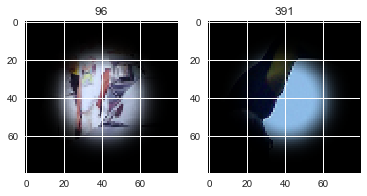

correlation:  -0.8515156316530523
means:  0.2221291454193669  ,  -1.4652639591358443


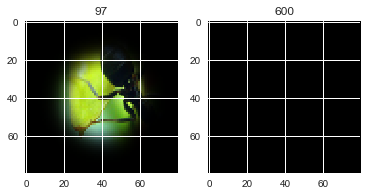

correlation:  -0.7700717159377262
means:  -0.12549715786153193  ,  0.38980202956496157


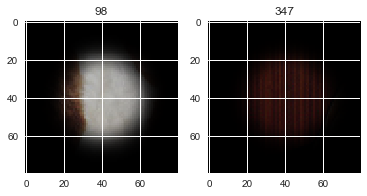

correlation:  -0.8126132220880354
means:  0.00613800801382892  ,  -0.17023127368316662


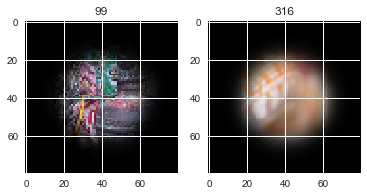

correlation:  -0.747447974760942
means:  -0.008244846712949342  ,  -0.6446014672923197


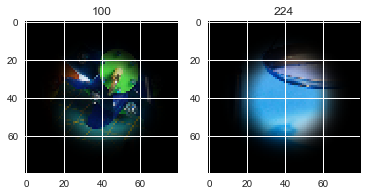

correlation:  -0.8148774766180581
means:  -0.13745139668060616  ,  -0.06163758076803607


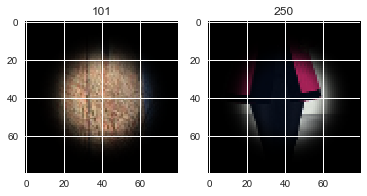

correlation:  -0.8847112712626686
means:  -0.13948185406640667  ,  -0.26677550329284944


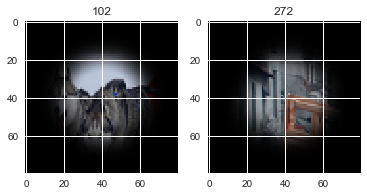

correlation:  -0.8200928010169226
means:  0.3501023115855664  ,  0.09744698720836746


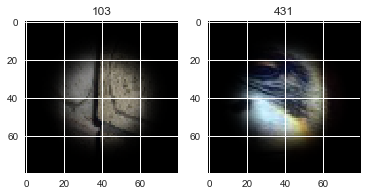

correlation:  -0.818125633234593
means:  -0.16811896688439287  ,  0.2635985743841671


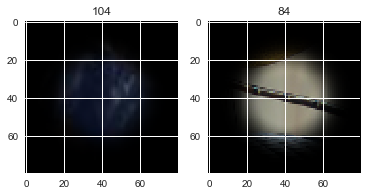

correlation:  -0.8183282600930234
means:  -0.09364482857978879  ,  -0.4269945715327454


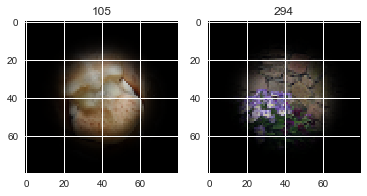

correlation:  -0.8006196983455864
means:  -0.2252496622614865  ,  0.14449705057328888


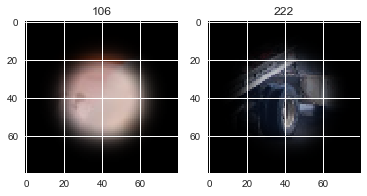

correlation:  -0.777879852629254
means:  -0.10660890014317831  ,  0.1248320245914238


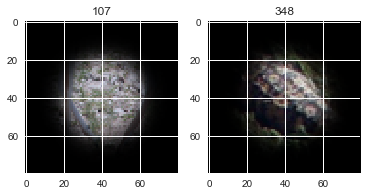

correlation:  -0.7265648434135038
means:  -0.21214824538114307  ,  0.19786491773828832


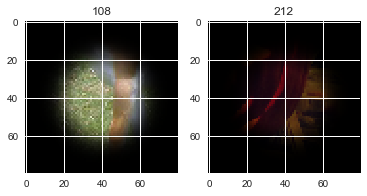

correlation:  -0.813995644405898
means:  0.8170827181141102  ,  -0.38198677094286176


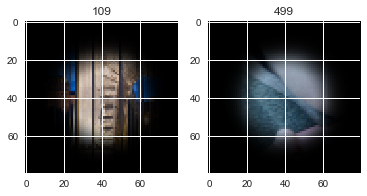

correlation:  -0.8238185676023769
means:  0.0045489991908873074  ,  -0.5625802181765039


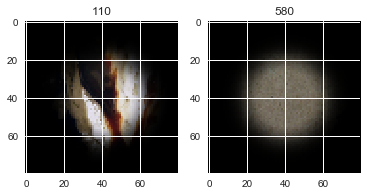

correlation:  -0.7604760474630092
means:  0.06987668124782469  ,  0.09744449426158144


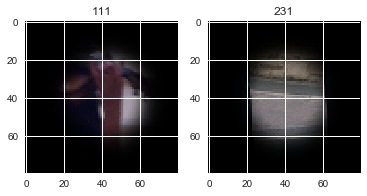

correlation:  -0.8947880845259497
means:  0.04747568251088071  ,  -0.4128563184194697


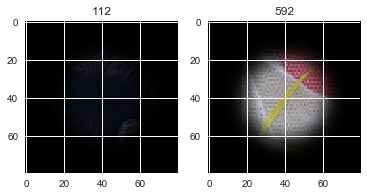

correlation:  -0.7356323713873608
means:  -0.27674492459008976  ,  0.20573251735579817


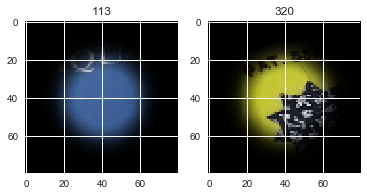

correlation:  -0.6822987801336
means:  -0.45003981277939153  ,  0.20573251735579817


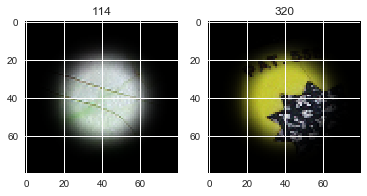

correlation:  -0.8480378581983177
means:  0.2974980940699257  ,  -0.21996764686855205


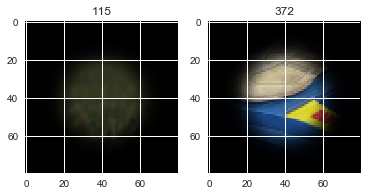

correlation:  -0.7956644739479146
means:  -0.20030575110295093  ,  0.19819632024255282


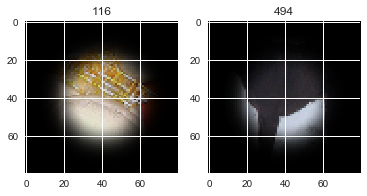

correlation:  -0.8052070274964728
means:  -0.278778489149582  ,  -0.17747756041662202


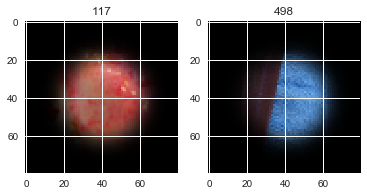

correlation:  -0.7584115336984643
means:  0.20904460922562362  ,  -0.5628038874291211


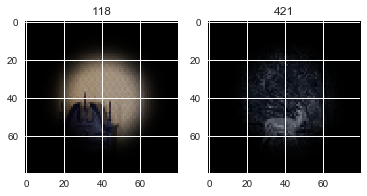

correlation:  -0.7623737932937341
means:  -0.5142923818849005  ,  0.017229688540591558


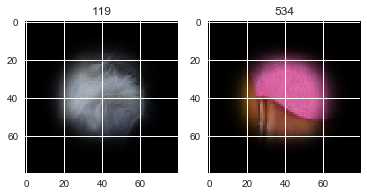

correlation:  -0.7570593439406517
means:  0.12280872125211749  ,  -0.019225724600761045


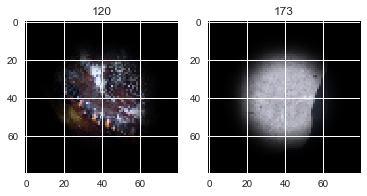

correlation:  -0.7570850620367103
means:  -0.48555847033950034  ,  0.15098398771737695


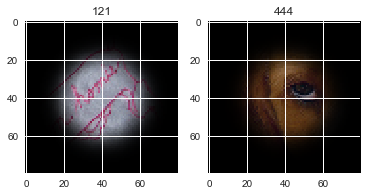

correlation:  -0.7604122905233841
means:  0.6272121996233906  ,  -0.43750632536954187


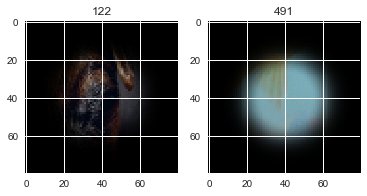

correlation:  -0.7662086473561602
means:  0.006868956618054456  ,  -0.03214481773179042


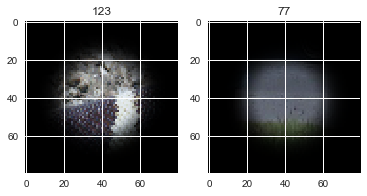

correlation:  -0.8186030302858663
means:  0.3420342462938204  ,  -0.4732293381018309


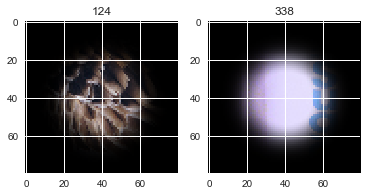

correlation:  -0.8071727979835898
means:  -0.3007389421332138  ,  -0.27757043720306057


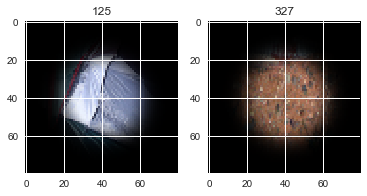

correlation:  -0.8257372703937677
means:  0.6541512737942416  ,  0.20573251735579817


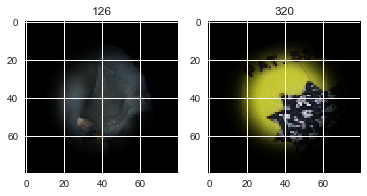

correlation:  -0.7964496278891253
means:  -0.046928127596483446  ,  -0.3833303677120933


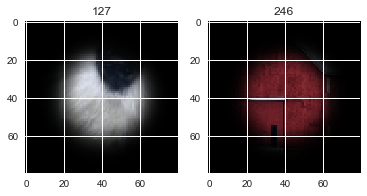

correlation:  -0.7408182895918421
means:  -0.00012721275169300106  ,  0.300792196868593


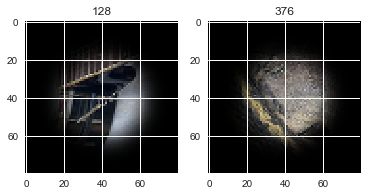

correlation:  -0.8865131786105632
means:  -0.3487101215988061  ,  -0.3405142643750854


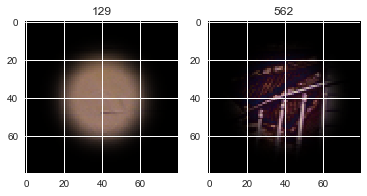

correlation:  -0.861638384514756
means:  -0.24293214606215152  ,  -0.042332894228225164


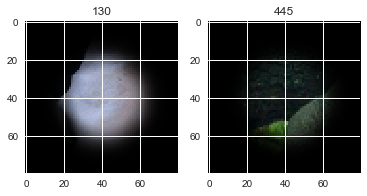

correlation:  -0.7717108164416395
means:  -0.36537828083037655  ,  0.2635985743841671


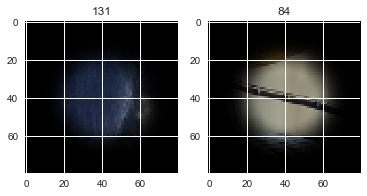

correlation:  -0.751027597811344
means:  0.0003762299825217703  ,  0.6540418432165833


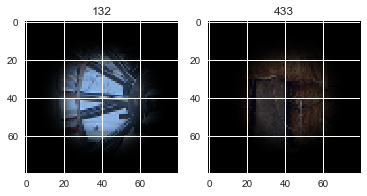

correlation:  -0.7875026750415365
means:  -0.3623880241005052  ,  -0.29616345293988244


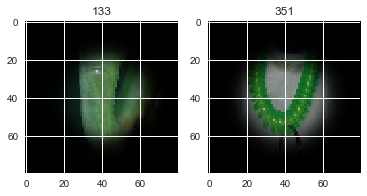

correlation:  -0.68405030289101
means:  0.4224887284672816  ,  -0.20802465596677178


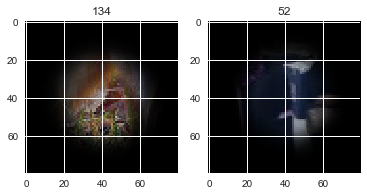

correlation:  -0.8184951576632893
means:  0.24573370672026698  ,  -0.17747756041662202


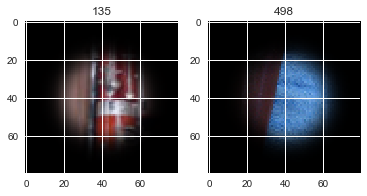

correlation:  -0.7534737593616805
means:  0.13115229331727704  ,  -0.3742027586608717


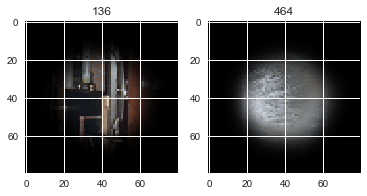

correlation:  -0.7983676272925024
means:  -0.2979377816433337  ,  0.3755315362497738


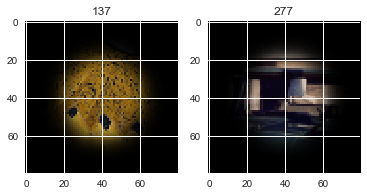

correlation:  -0.7841287293346751
means:  0.11199608546375736  ,  -0.27353884127084155


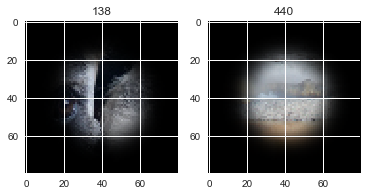

correlation:  -0.7928287753078135
means:  -0.029451088623819163  ,  -0.24145858233195458


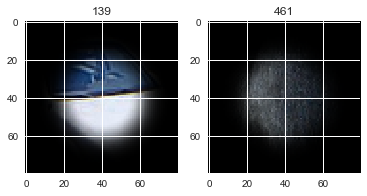

correlation:  -0.8454733138652843
means:  0.13978270426038003  ,  0.473400874378734


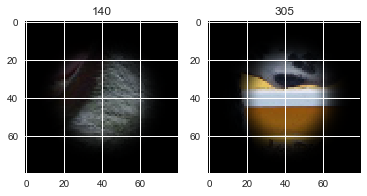

correlation:  -0.7453302031210508
means:  0.3195085961760274  ,  -0.4258509475176776


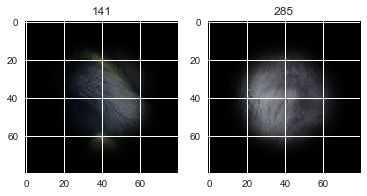

correlation:  -0.6782685306968269
means:  -0.15425758456588204  ,  0.48526936442436847


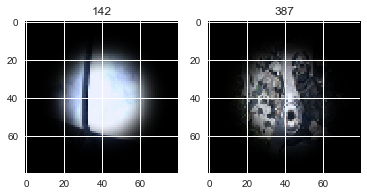

correlation:  -0.6777286115412139
means:  -0.2660102201032968  ,  0.14449705057328888


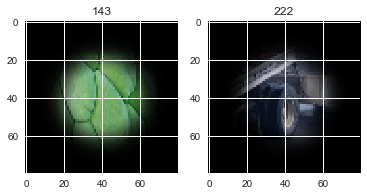

correlation:  -0.8517427901166789
means:  -0.5119384574770878  ,  0.14449705057328888


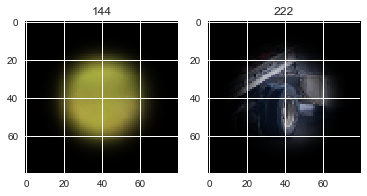

correlation:  -0.8591286994207729
means:  0.41089106034330647  ,  0.45872612782307504


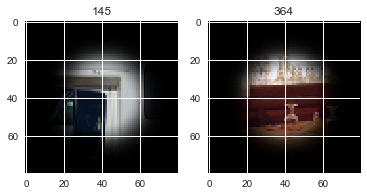

correlation:  -0.7987149279553325
means:  0.5117295938690969  ,  -0.22759543142738525


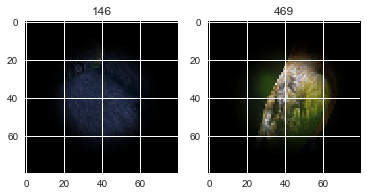

correlation:  -0.9996224900997146
means:  -0.08096792232843485  ,  -1.4652639591358443


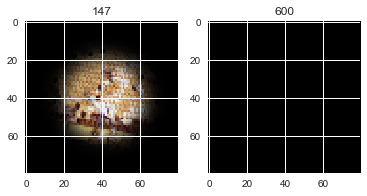

correlation:  -0.7982428326504486
means:  -0.3724887209068309  ,  -1.4652639591358443


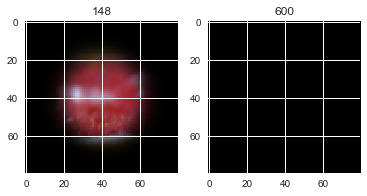

correlation:  -0.7244710905843328
means:  -0.028582509983335995  ,  0.38980202956496157


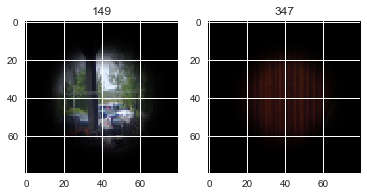

correlation:  -0.7272559545005758
means:  0.05345441909615693  ,  -0.3228741210175776


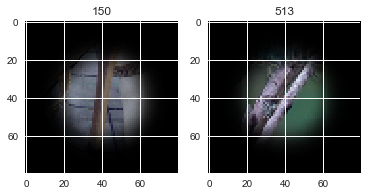

correlation:  -0.716509134447136
means:  -0.018510609956125836  ,  0.3780708759739081


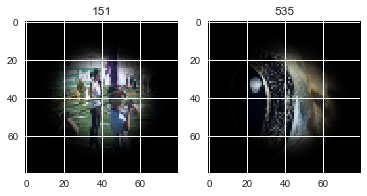

correlation:  -0.7811756869074363
means:  -0.15417443486983748  ,  -0.42865314863116527


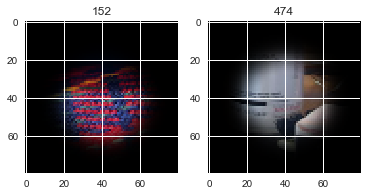

correlation:  -0.789765871229
means:  -0.31194280837025057  ,  -0.05633345229576443


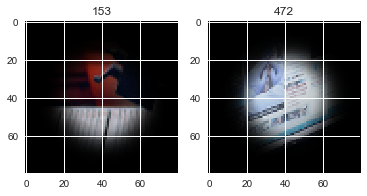

correlation:  -0.815438234488383
means:  0.17440602980345252  ,  0.18997719638891056


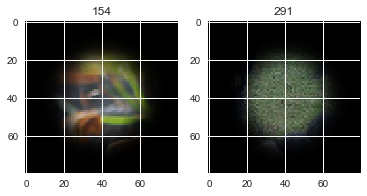

correlation:  -0.790149424239059
means:  0.5419970540058835  ,  -0.48297140908619035


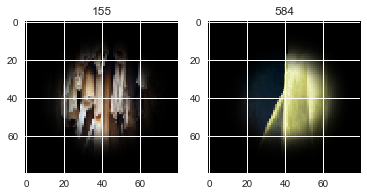

correlation:  -0.8141074276293803
means:  -0.3260227659506527  ,  -0.24631484670485204


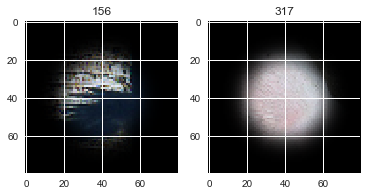

correlation:  -0.8045412882048738
means:  0.6570034954240529  ,  0.32946148454360996


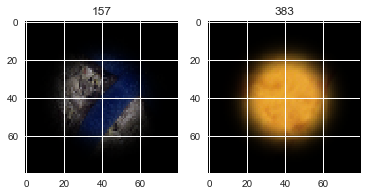

correlation:  -0.7773023238750288
means:  0.20195879373901346  ,  -0.29616345293988244


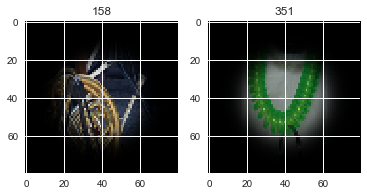

correlation:  -0.8423381321617951
means:  -0.4235459260135311  ,  0.03145066062417047


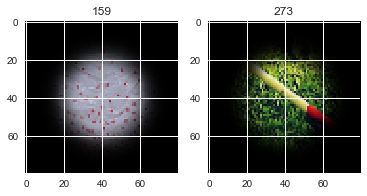

correlation:  -0.7621884555816804
means:  -0.19726468090071653  ,  -0.21701046822277037


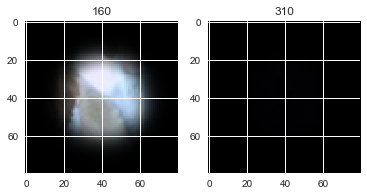

correlation:  -0.8075316172292354
means:  -0.15456807316377041  ,  -0.3190890919583182


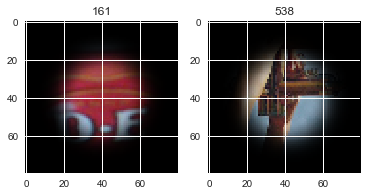

correlation:  -0.7757249188281108
means:  -0.10997078800813875  ,  0.11718248029617512


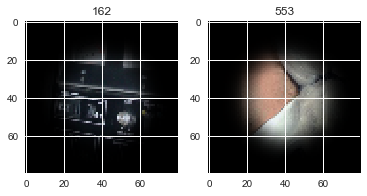

correlation:  -0.7757032542461963
means:  -0.006046404356143851  ,  -0.1148928097323958


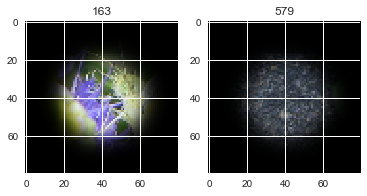

correlation:  -0.7725954626322107
means:  -0.094887216398222  ,  -0.29448758717424206


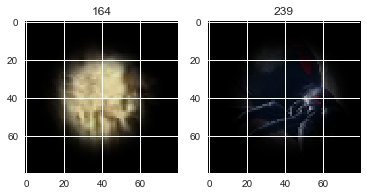

correlation:  -0.7893512554460599
means:  -0.28241241911884724  ,  0.4049063274690438


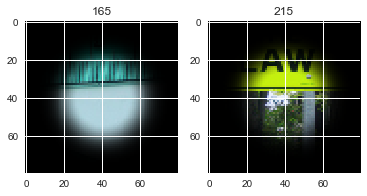

correlation:  -0.75090347894644
means:  0.3452344954328157  ,  -0.48498352939718764


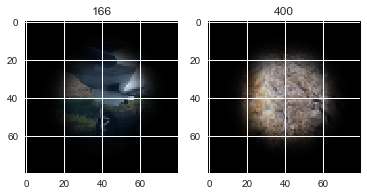

correlation:  -0.7784389731076955
means:  -0.1195669000506388  ,  0.1660611955761043


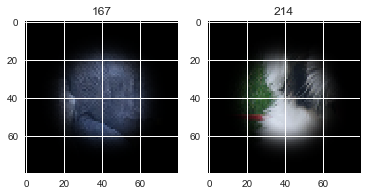

correlation:  -0.7635346954074981
means:  -0.02154891935232901  ,  -0.23205604426966986


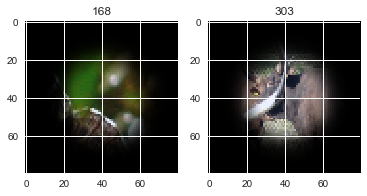

correlation:  -0.6861784583826182
means:  0.2912322994712713  ,  0.08754166882415361


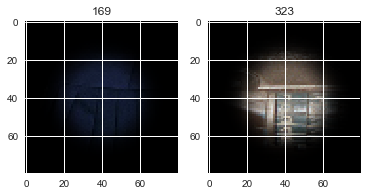

correlation:  -0.7536742365730122
means:  0.32402356447910985  ,  -0.43975758228459105


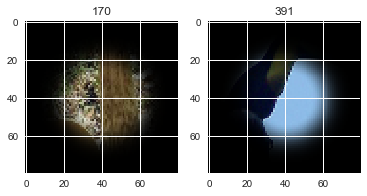

correlation:  -0.7308823712382095
means:  0.24477586089881964  ,  0.40652279234326644


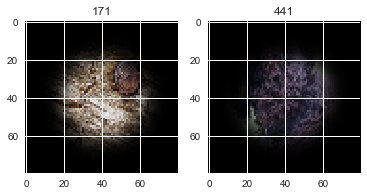

correlation:  -0.7150743708841251
means:  -0.22794620997125392  ,  -0.16088523623248116


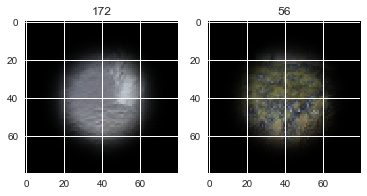

correlation:  -0.7931215009481045
means:  -0.019225724600761045  ,  -0.24861632641170728


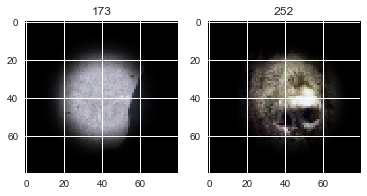

correlation:  -0.7820460728908578
means:  0.2904183480068572  ,  -1.4652639591358443


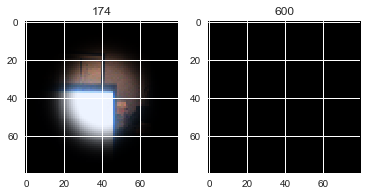

correlation:  -0.8585712695686166
means:  -0.17175447361696458  ,  -0.18364033373014868


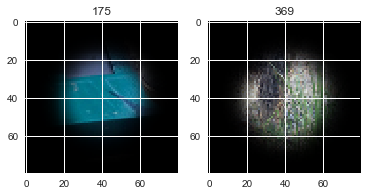

correlation:  -0.7997954255087779
means:  0.12374864867420092  ,  0.40652279234326644


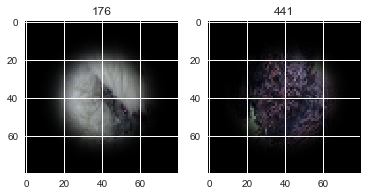

correlation:  -0.8042034864771997
means:  -0.27869150754938543  ,  0.2798585618935452


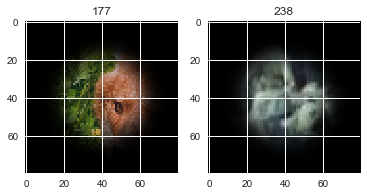

correlation:  -0.808110740941392
means:  -0.37131820083567685  ,  0.20573251735579817


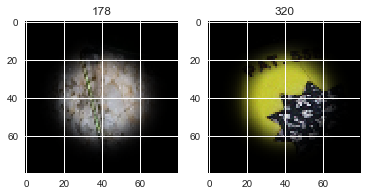

correlation:  -0.771355457221237
means:  1.0757364901796718  ,  0.014695168388468767


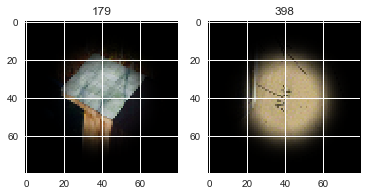

correlation:  -0.7928240731629043
means:  0.41418881818683784  ,  -0.548645778475016


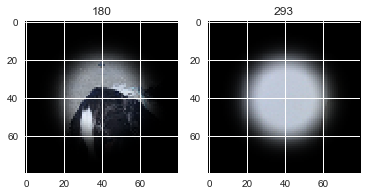

correlation:  -0.7618839913891676
means:  -0.3448641218821176  ,  -0.33604937177111605


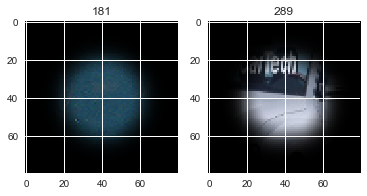

correlation:  -0.8772292300644194
means:  -0.311924146646951  ,  0.21191932255972423


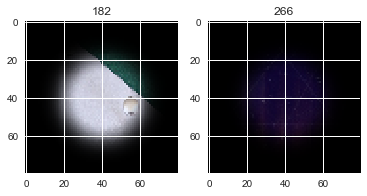

correlation:  -0.698960628246501
means:  0.1584157971972747  ,  -0.39570832956617996


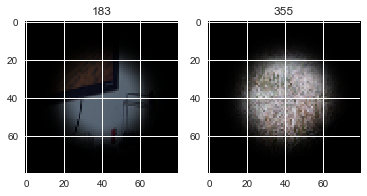

correlation:  -0.7510621157172127
means:  -0.19704728199172045  ,  -1.4652639591358443


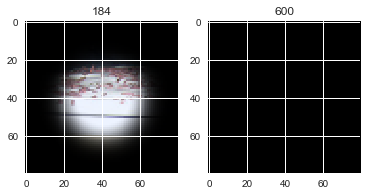

correlation:  -0.8445711185954197
means:  0.25812181188102573  ,  -0.25180705796730607


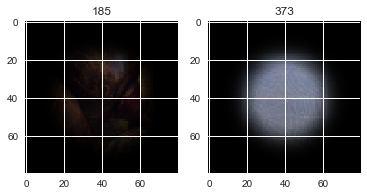

correlation:  -0.8209661744177795
means:  0.22201016215001768  ,  -0.9328859918299078


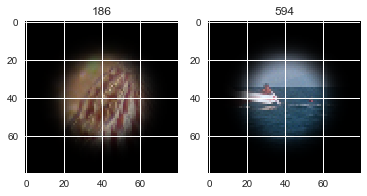

correlation:  -0.8040245897883792
means:  -0.1136338521909178  ,  0.3755315362497738


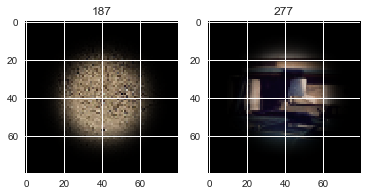

correlation:  -0.7723930192674864
means:  0.09353741171596369  ,  -0.17021025152781163


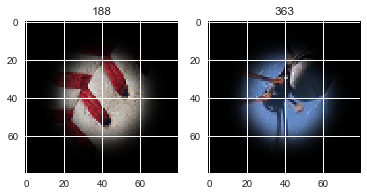

correlation:  -0.7692927108492592
means:  0.1746692997602971  ,  -0.2981930737981295


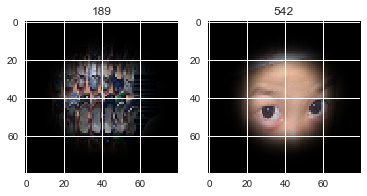

correlation:  -0.7496497405158735
means:  -0.05887171950363065  ,  0.2848176270883292


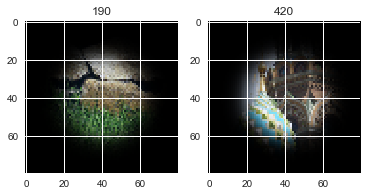

correlation:  -0.7730400292671616
means:  0.1717991153349208  ,  -0.18406062655178748


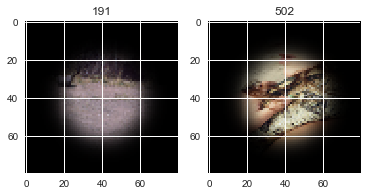

correlation:  -0.7135192142404161
means:  0.09022749031819058  ,  0.39782240225559434


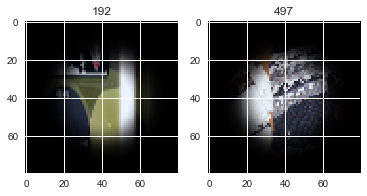

correlation:  -0.7519524854043279
means:  -0.32316347566563564  ,  -0.6822192025815755


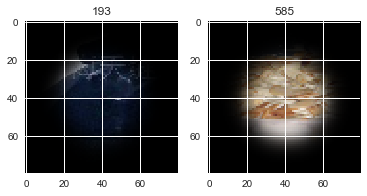

correlation:  -0.9371067468008085
means:  0.5841379855603611  ,  -1.4652639591358443


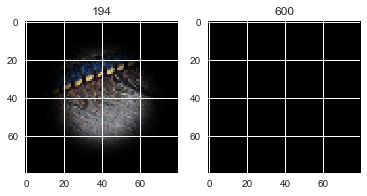

correlation:  -0.7641702360696749
means:  -0.23761587825692285  ,  -0.6822192025815755


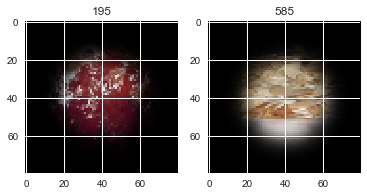

correlation:  -0.7622849304073853
means:  0.268754912859123  ,  -0.27152480849162414


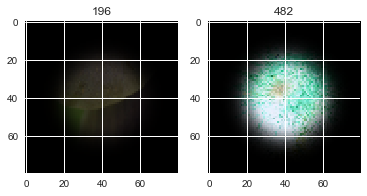

correlation:  -0.6974892144972042
means:  0.5903754949457847  ,  0.22369806996618324


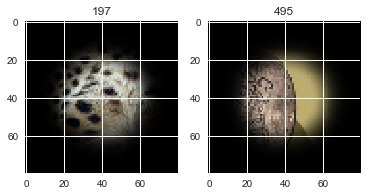

correlation:  -0.8409752506334688
means:  0.23681720397025874  ,  -0.3721868247314445


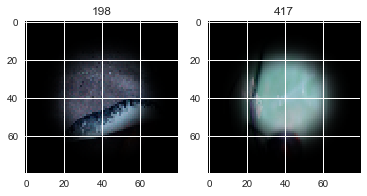

correlation:  -0.7545463361453028
means:  0.28084310191060285  ,  -0.30682689955682635


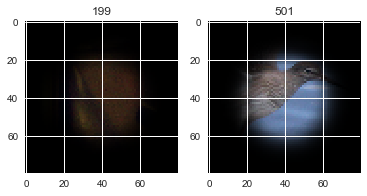

correlation:  -0.8029890535585604
means:  0.2958410286915718  ,  0.27931415516030905


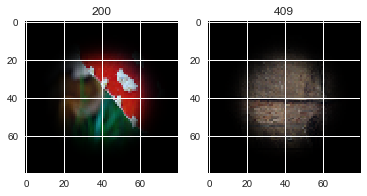

correlation:  -0.7906020947063573
means:  -0.15313314564305533  ,  -0.016635121522370292


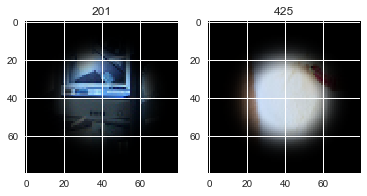

correlation:  -0.7611052362879475
means:  0.4566994589593911  ,  -0.22489565565010364


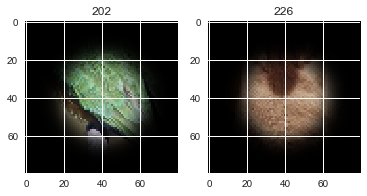

correlation:  -0.6977437158196472
means:  0.23122699672513908  ,  -0.0005628230205766769


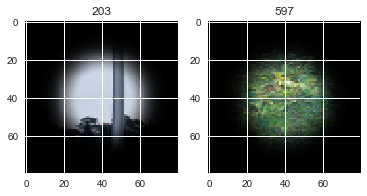

correlation:  -0.8417535081618395
means:  -0.11450134992049357  ,  -0.6446014672923197


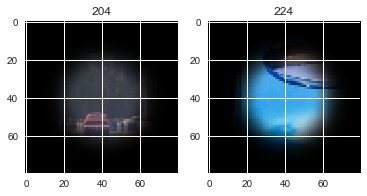

correlation:  -0.852184111885783
means:  -0.17671430346649306  ,  -0.24861632641170728


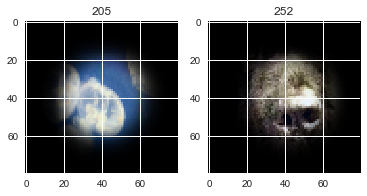

correlation:  -0.737498425331515
means:  0.5341480207026437  ,  -0.3487101215988061


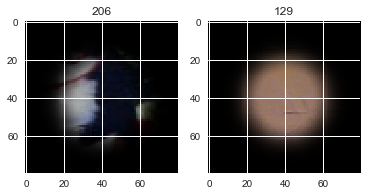

correlation:  -0.7751876592270237
means:  0.7476911102788383  ,  0.8959340457930629


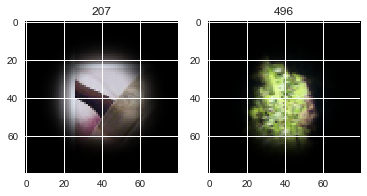

correlation:  -0.8100776575317113
means:  -0.22477485742245606  ,  0.4049063274690438


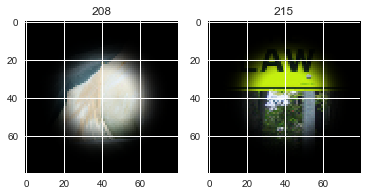

correlation:  -0.8458678031112769
means:  -0.15149955474324608  ,  -0.6822192025815755


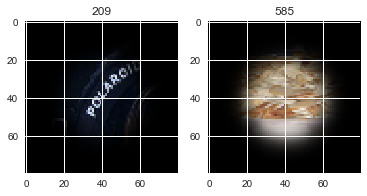

correlation:  -0.8019367345167435
means:  -0.2657944655703399  ,  -0.17120152916734802


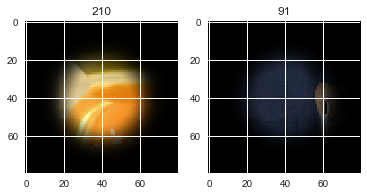

correlation:  -0.7516242928376695
means:  0.06882393652659835  ,  -0.20216226039263405


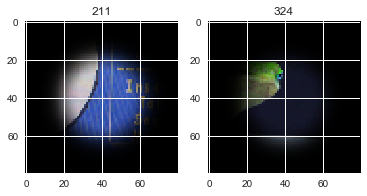

correlation:  -0.7781712789559765
means:  0.19786491773828832  ,  -0.16731013466440206


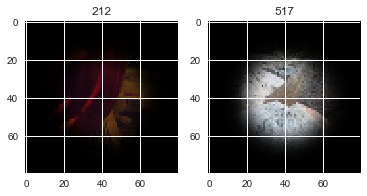

correlation:  -0.8105989172192716
means:  0.05958104628759657  ,  0.4886866504271384


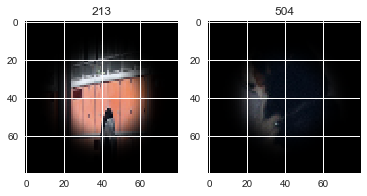

correlation:  -0.8153678790107739
means:  0.1660611955761043  ,  0.04727541757152543


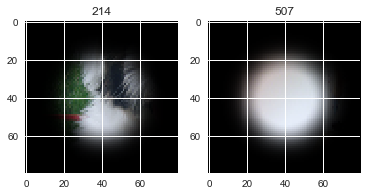

correlation:  -0.8100776575317113
means:  0.4049063274690438  ,  -0.22477485742245606


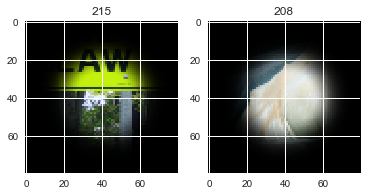

correlation:  -0.8506931942667548
means:  -0.24554805243311684  ,  0.02511879506625989


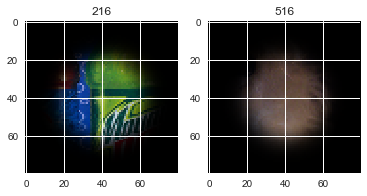

correlation:  -0.7981498919818623
means:  0.36309800039551754  ,  0.3232054724889706


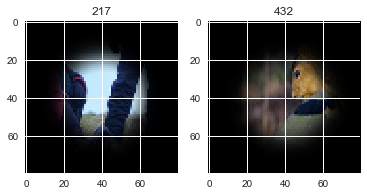

correlation:  -0.6831046010861089
means:  -0.16719833746938642  ,  -0.12428621723159468


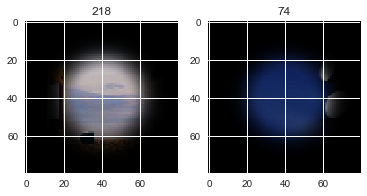

correlation:  -0.8710650911055259
means:  0.13637969107654185  ,  -0.3405142643750854


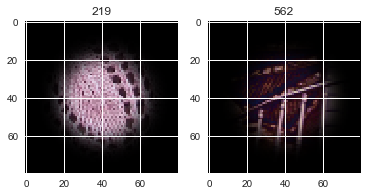

correlation:  -0.7743661794171027
means:  -0.607679315442089  ,  -0.020726156975098886


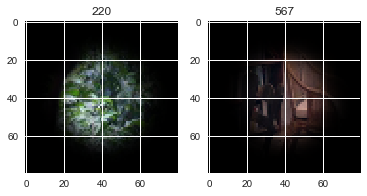

correlation:  -0.783015983958486
means:  -0.4912209855496464  ,  -0.44727471958703635


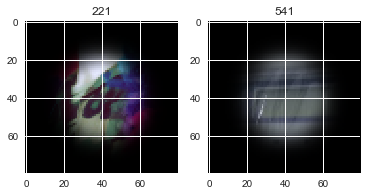

correlation:  -0.9037648196291274
means:  0.14449705057328888  ,  0.0691679125774749


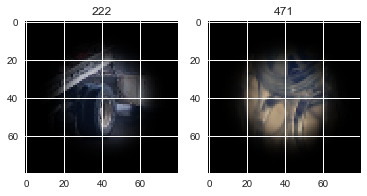

correlation:  -0.7270689824915613
means:  -0.0019677342347108506  ,  0.5188736096103596


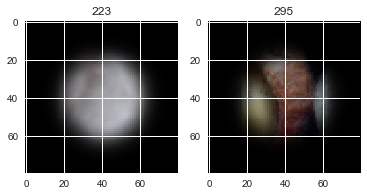

correlation:  -0.8747011624162732
means:  -0.6446014672923197  ,  0.5841379855603611


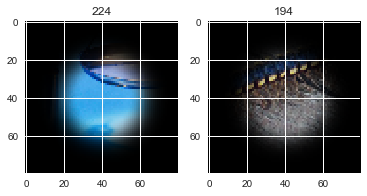

correlation:  -0.8069800840562839
means:  0.09806805870472789  ,  -0.03214481773179042


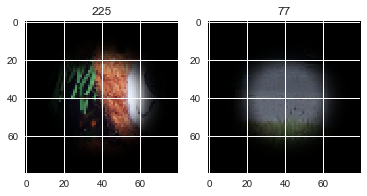

correlation:  -0.8455305758757373
means:  -0.22489565565010364  ,  0.42112040141598756


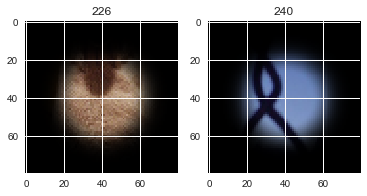

correlation:  -0.7613571215724734
means:  -0.0607473201501686  ,  0.16658285081265592


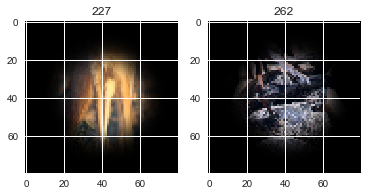

correlation:  -0.7419736397204322
means:  0.5700084589939496  ,  0.48762612286941337


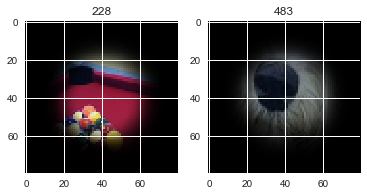

correlation:  -0.7435434565959733
means:  0.24444355676520993  ,  -0.17023127368316662


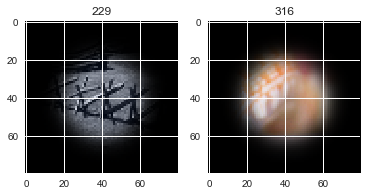

correlation:  -0.7904454487459707
means:  0.16322478620586456  ,  0.251644983441126


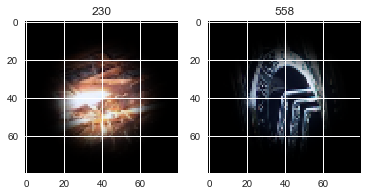

correlation:  -0.8417410594041786
means:  0.09744449426158144  ,  0.5990266237852448


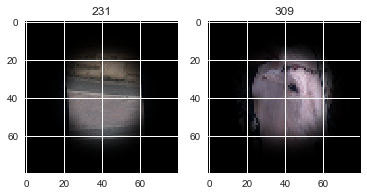

correlation:  -0.876588469974053
means:  -0.00705924533692171  ,  0.07321383051743724


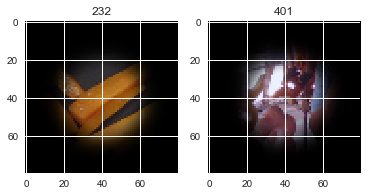

correlation:  -0.825420865054914
means:  -0.09359972294607792  ,  0.024713037780595602


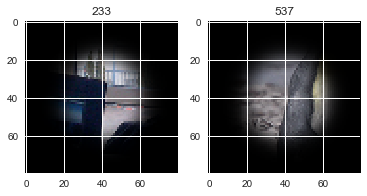

correlation:  -0.7544081628719377
means:  0.18191237324382498  ,  0.07663497895688184


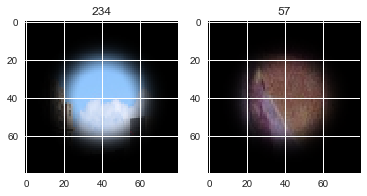

correlation:  -0.8135313615575255
means:  -0.11126695325682599  ,  0.7311946335856094


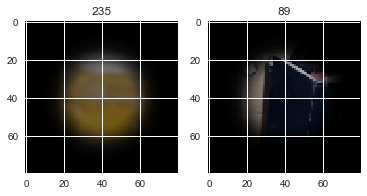

correlation:  -0.6697813148902249
means:  0.3872589440711629  ,  0.2532508654138547


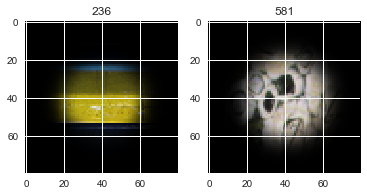

correlation:  -0.7679796324376063
means:  -0.21850816530511788  ,  -0.17747756041662202


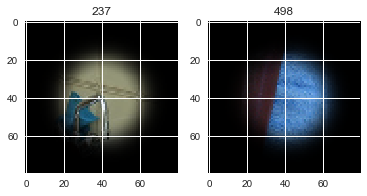

correlation:  -0.8042034864771997
means:  0.2798585618935452  ,  -0.27869150754938543


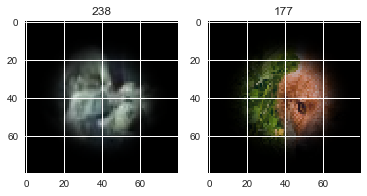

correlation:  -0.8192160413189604
means:  -0.29448758717424206  ,  0.13637969107654185


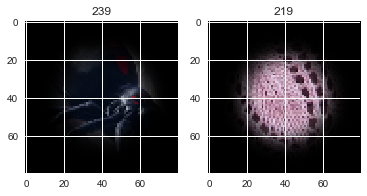

correlation:  -0.8455305758757373
means:  0.42112040141598756  ,  -0.22489565565010364


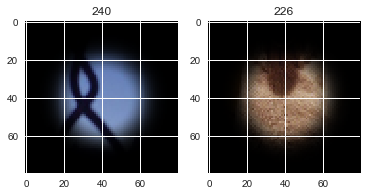

correlation:  -0.8967418474911839
means:  0.1626212638523737  ,  -0.3694664665786218


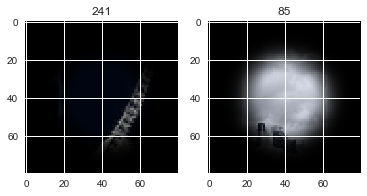

correlation:  -0.8082213233985728
means:  -0.24072233574173565  ,  0.15098398771737695


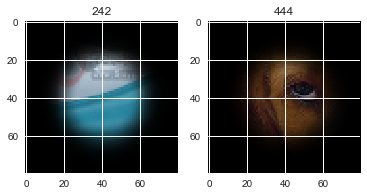

correlation:  -0.8153968451973275
means:  0.22284639926486838  ,  -0.3190890919583182


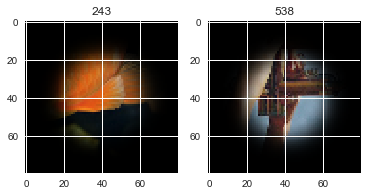

correlation:  -0.7517094492498612
means:  -0.22137483530074792  ,  0.04747568251088071


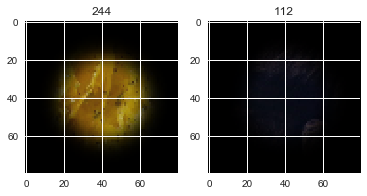

correlation:  -0.7885388650111579
means:  0.061733236328723115  ,  -0.163333911457193


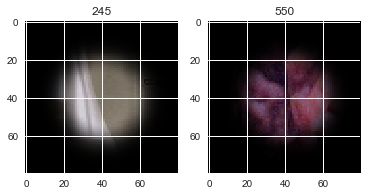

correlation:  -0.8304167704738118
means:  -0.3833303677120933  ,  0.2848176270883292


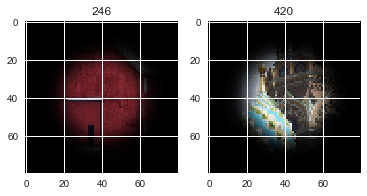

correlation:  -0.8390327571138315
means:  0.09527777272457678  ,  0.38980202956496157


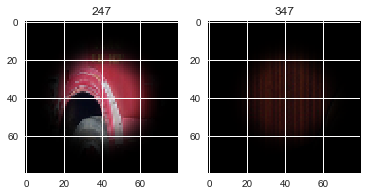

correlation:  -0.7084123967399026
means:  -0.08555546833087865  ,  -0.17747756041662202


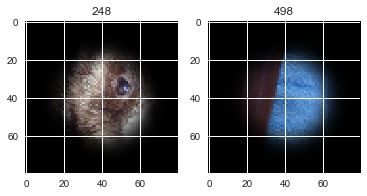

correlation:  -0.7734623579101402
means:  -0.2932868032520846  ,  0.12362315660638451


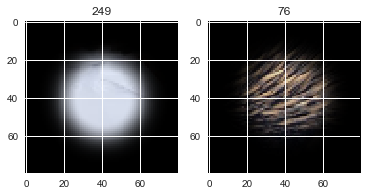

correlation:  -0.8148774766180581
means:  -0.06163758076803607  ,  -0.13745139668060616


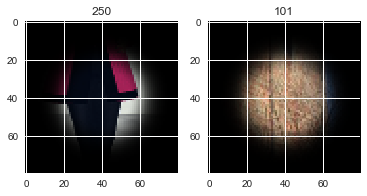

correlation:  -0.7635082463804528
means:  0.04391403129246957  ,  0.1746692997602971


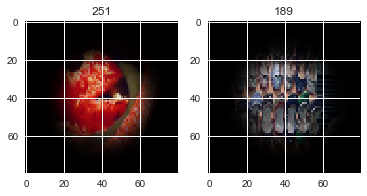

correlation:  -0.852184111885783
means:  -0.24861632641170728  ,  -0.17671430346649306


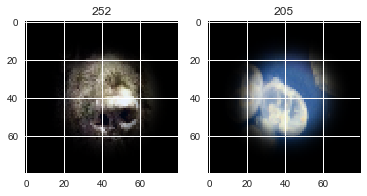

correlation:  -0.8047597515969681
means:  0.5704864383134401  ,  0.09802656652564243


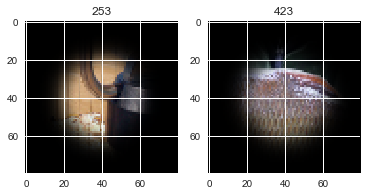

correlation:  -0.8031799987568505
means:  -0.04760401837163633  ,  -0.4645376429233485


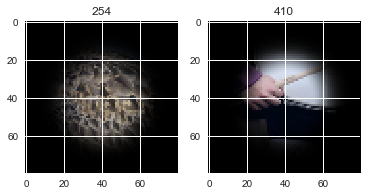

correlation:  -0.8891428512027232
means:  -0.019161570332831553  ,  -0.4269945715327454


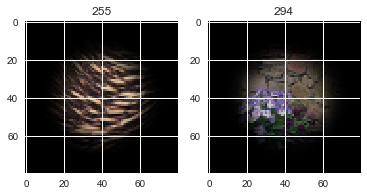

correlation:  -0.9576407017900966
means:  0.17838502020393643  ,  -1.4652639591358443


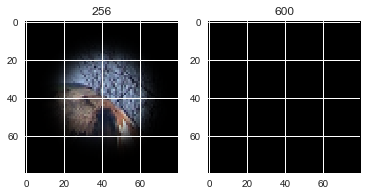

correlation:  -0.8103296714173028
means:  0.21316801546147496  ,  -0.23464854458363707


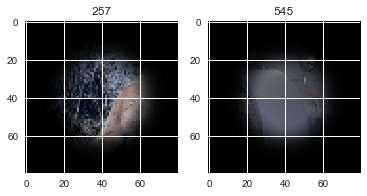

correlation:  -0.7983794442363189
means:  -0.055573302896500525  ,  0.13637969107654185


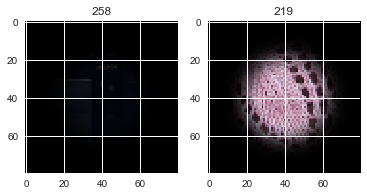

correlation:  -0.692444934574946
means:  0.07384957898246164  ,  -0.26677550329284944


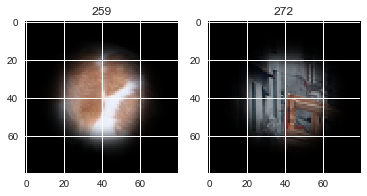

correlation:  -0.7460472044294115
means:  0.48345527463080545  ,  0.2904183480068572


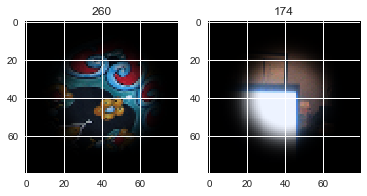

correlation:  -0.8248762826678763
means:  0.3729076701043097  ,  0.20573251735579817


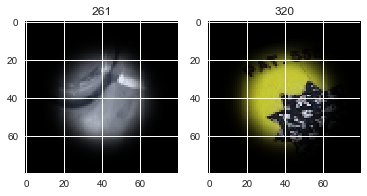

correlation:  -0.7613571215724734
means:  0.16658285081265592  ,  -0.0607473201501686


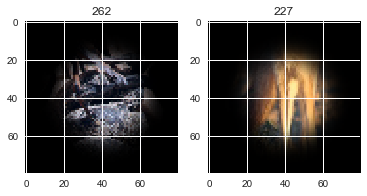

correlation:  -0.7614502516258639
means:  0.9323657150459671  ,  -1.4652639591358443


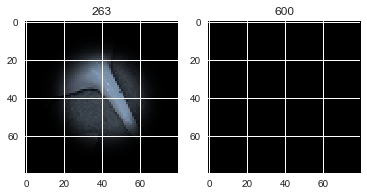

correlation:  -0.7893960184748573
means:  -0.6356897310505357  ,  0.15098398771737695


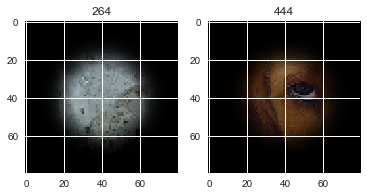

correlation:  -0.8963427453216549
means:  -0.14953376963315793  ,  0.4254889379747222


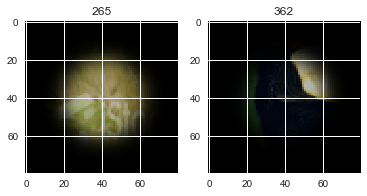

correlation:  -0.8772292300644194
means:  0.21191932255972423  ,  -0.311924146646951


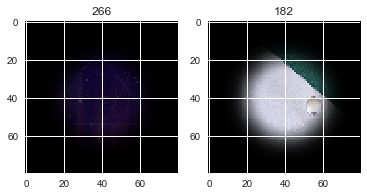

correlation:  -0.8504425811612097
means:  -0.09492505230637956  ,  -0.18944044960470488


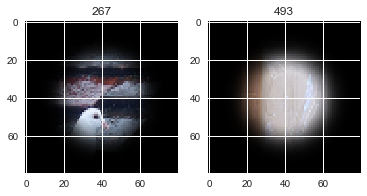

correlation:  -0.8474825834163611
means:  -0.4999931019352017  ,  -0.042332894228225164


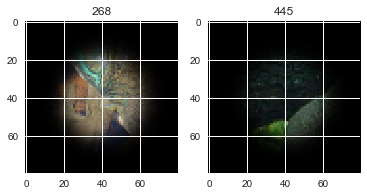

correlation:  -0.7530286163968326
means:  -0.2156404742683371  ,  -0.13426859887094034


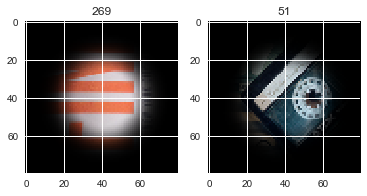

correlation:  -0.8097603843979018
means:  -0.48688095256338815  ,  0.16794577508533476


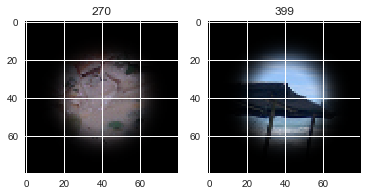

correlation:  -0.7983212525887325
means:  0.46862260530699945  ,  0.3729076701043097


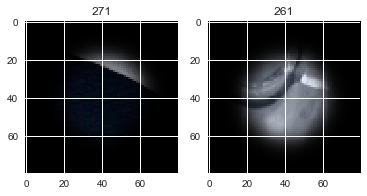

correlation:  -0.8847112712626686
means:  -0.26677550329284944  ,  -0.13948185406640667


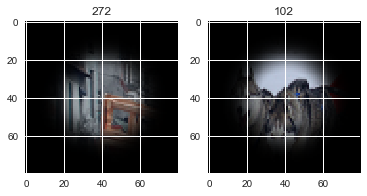

correlation:  -0.8423381321617951
means:  0.03145066062417047  ,  -0.4235459260135311


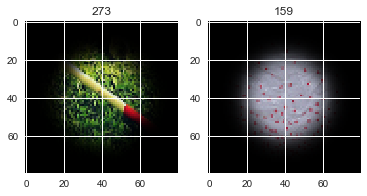

correlation:  -0.7707353393351154
means:  0.34306009411848915  ,  -0.34437304437901217


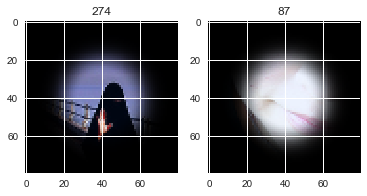

correlation:  -0.7319366392809992
means:  -0.23014474561013365  ,  -0.31180675203057046


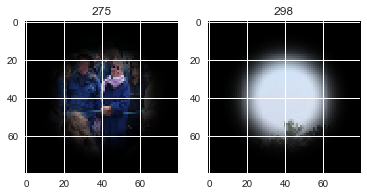

correlation:  -0.7566813100387941
means:  -0.28280455052350134  ,  0.061733236328723115


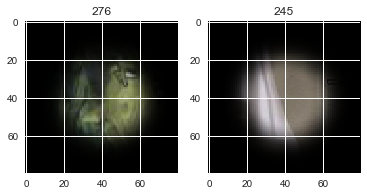

correlation:  -0.8040245897883792
means:  0.3755315362497738  ,  -0.1136338521909178


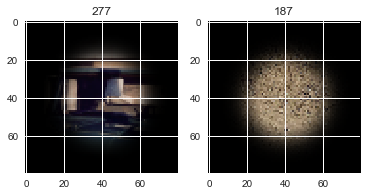

correlation:  -0.8369835801812417
means:  -0.15557095683424763  ,  -1.4652639591358443


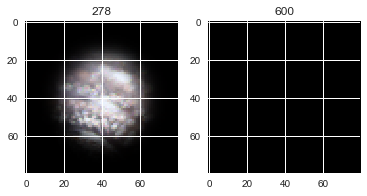

correlation:  -0.8187262752119282
means:  -0.517139508397297  ,  -0.4645376429233485


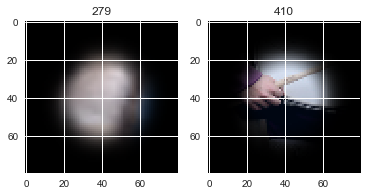

correlation:  -0.7865980369160429
means:  -0.14257689716376387  ,  -0.21861548396119554


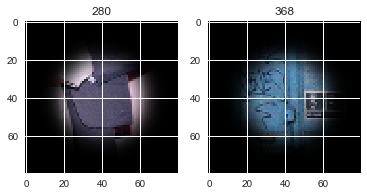

correlation:  -0.8479200451722558
means:  -0.30537901799686984  ,  0.4254889379747222


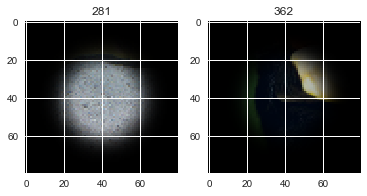

correlation:  -0.7201971763239589
means:  0.3459989681119048  ,  0.9745456262467417


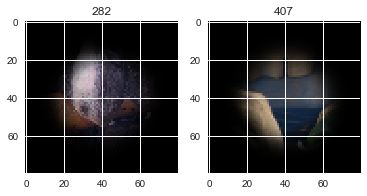

correlation:  -0.8645993950379538
means:  -0.42103249437690254  ,  0.20573251735579817


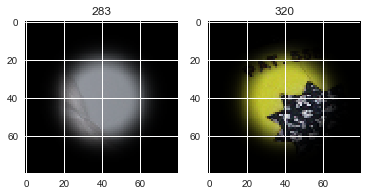

correlation:  -0.7274974329062257
means:  -0.3345165920965518  ,  0.19819632024255282


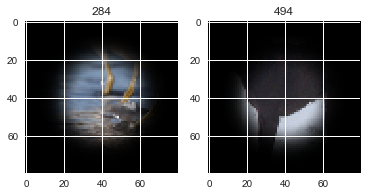

correlation:  -0.8421153734719179
means:  -0.4258509475176776  ,  -0.19046260442146898


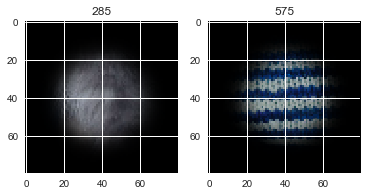

correlation:  -0.8549260581576722
means:  -0.01292578751739587  ,  -0.26339431584944106


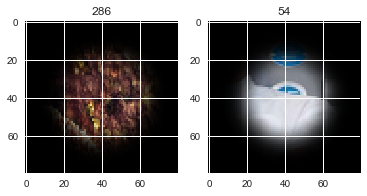

correlation:  -0.7755248318155259
means:  -0.18595662863629894  ,  0.6540418432165833


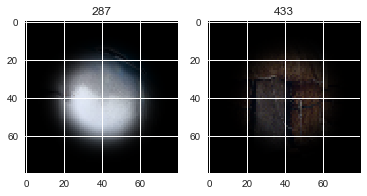

correlation:  -0.7846092489663986
means:  -0.08035598284724749  ,  -0.30537901799686984


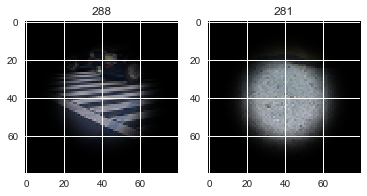

correlation:  -0.7757261266052098
means:  -0.33604937177111605  ,  0.4149953954940294


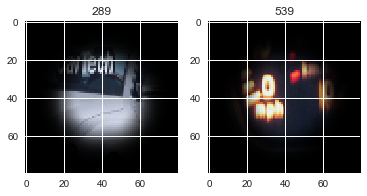

correlation:  -0.695210103976886
means:  -0.3564668575501195  ,  0.16016110188436922


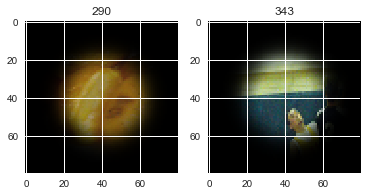

correlation:  -0.815438234488383
means:  0.18997719638891056  ,  0.17440602980345252


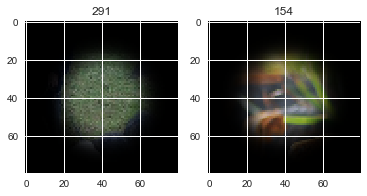

correlation:  -0.7501073656783126
means:  -0.18702260600177986  ,  -0.03214481773179042


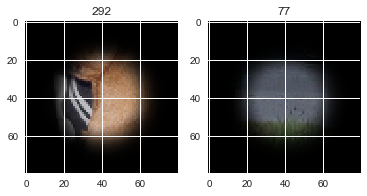

correlation:  -0.8289580234268934
means:  -0.548645778475016  ,  0.21725205049041166


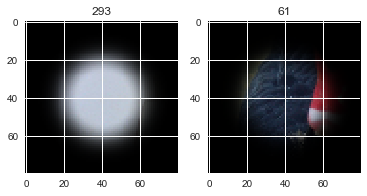

correlation:  -0.8891428512027232
means:  -0.4269945715327454  ,  -0.019161570332831553


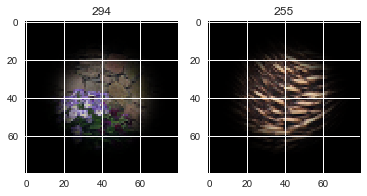

correlation:  -0.7533991568079969
means:  0.5188736096103596  ,  -0.4235459260135311


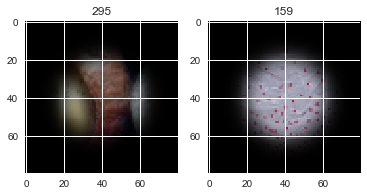

correlation:  -0.7324330535574385
means:  0.21397394231894803  ,  -0.3623880241005052


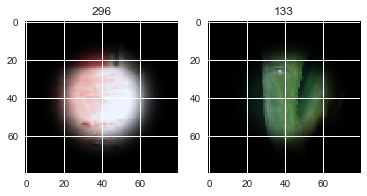

correlation:  -0.8345928920550355
means:  -0.19805722044624077  ,  0.7311946335856094


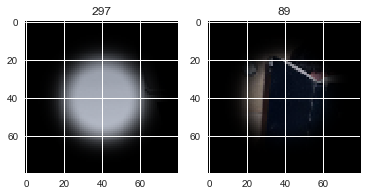

correlation:  -0.9024823977630753
means:  -0.31180675203057046  ,  -0.12207283775232089


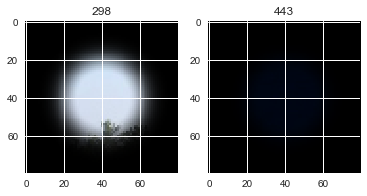

correlation:  -0.8974907355022173
means:  -0.20412305442947687  ,  -0.163333911457193


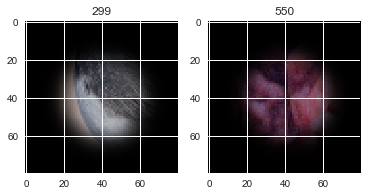

correlation:  -0.744493420326621
means:  0.06287588059347492  ,  -0.26251807009155664


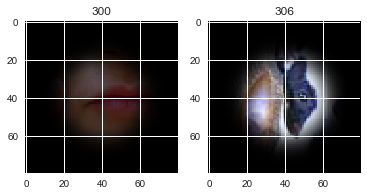

correlation:  -0.7142449245337938
means:  0.005562768323611719  ,  -0.012398701079188416


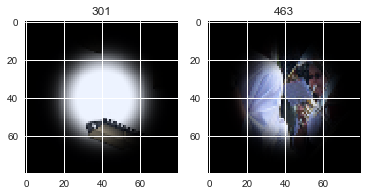

correlation:  -0.8236915830545133
means:  0.20299823935638822  ,  0.38980202956496157


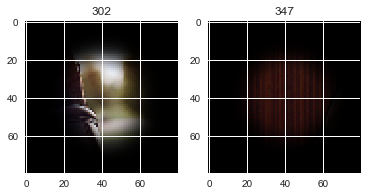

correlation:  -0.7988051987257998
means:  -0.23205604426966986  ,  0.4385446042627344


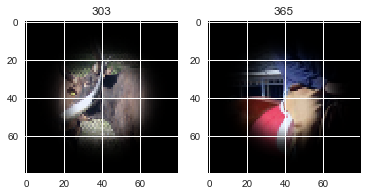

correlation:  -0.7650453534668101
means:  0.29681092218870325  ,  0.42453812450286


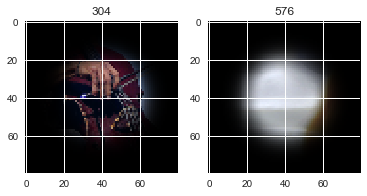

correlation:  -0.8454733138652843
means:  0.473400874378734  ,  0.13978270426038003


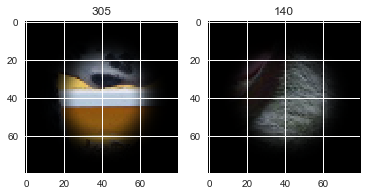

correlation:  -0.7507343618521393
means:  -0.26251807009155664  ,  -0.44727471958703635


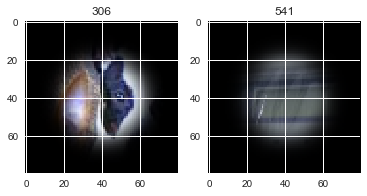

correlation:  -0.8592431547489673
means:  -0.2501018671411857  ,  -0.43893507666519566


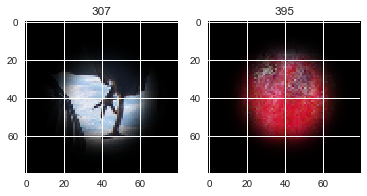

correlation:  -0.853691727798948
means:  0.012947724607270233  ,  0.15770907242137036


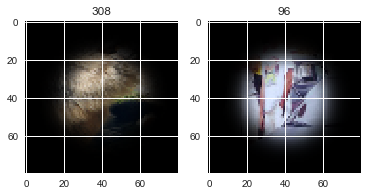

correlation:  -0.8417410594041786
means:  0.5990266237852448  ,  0.09744449426158144


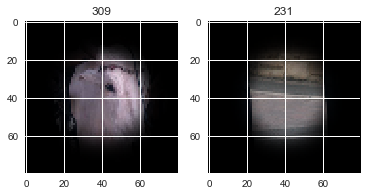

correlation:  -0.7624734933104859
means:  -0.21701046822277037  ,  -0.12549715786153193


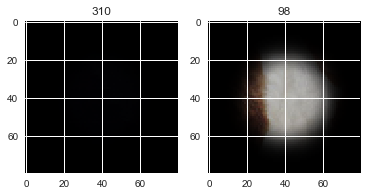

correlation:  -0.810140747453436
means:  -0.054883501372532346  ,  -0.6446014672923197


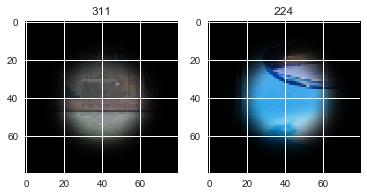

correlation:  -0.7575573668342467
means:  0.025245873174154984  ,  -0.3408675241840722


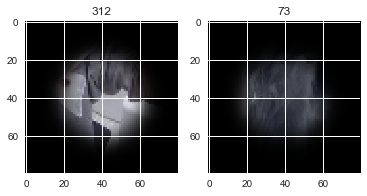

correlation:  -0.8750613078648423
means:  -0.20362350726982487  ,  -0.26677550329284944


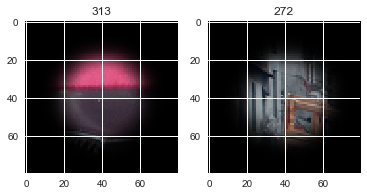

correlation:  -0.7466828328471238
means:  -0.23346224189049478  ,  -0.08054134026742994


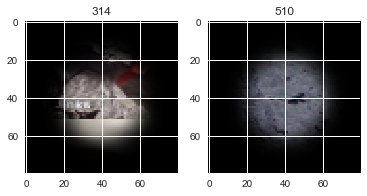

correlation:  -0.688484948910764
means:  -0.45680547468531446  ,  -0.36537828083037655


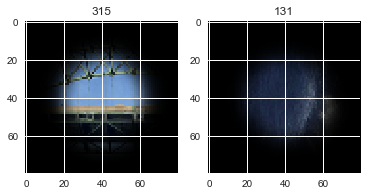

correlation:  -0.8126132220880354
means:  -0.17023127368316662  ,  0.00613800801382892


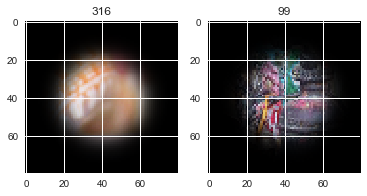

correlation:  -0.8151242902157834
means:  -0.24631484670485204  ,  0.1626212638523737


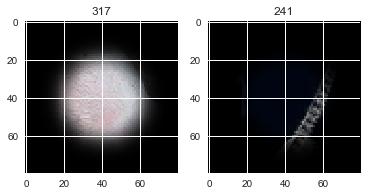

correlation:  -0.8373249265372967
means:  -0.09022574580806664  ,  0.2974980940699257


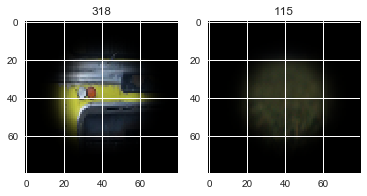

correlation:  -0.7969642756289546
means:  -0.32115440990686667  ,  -0.5625802181765039


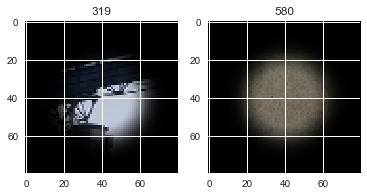

correlation:  -0.8645993950379538
means:  0.20573251735579817  ,  -0.42103249437690254


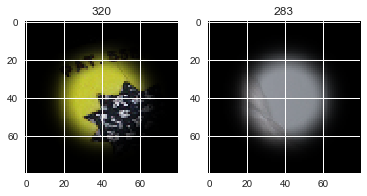

correlation:  -0.7481610709911882
means:  0.33994792123101714  ,  0.0003762299825217703


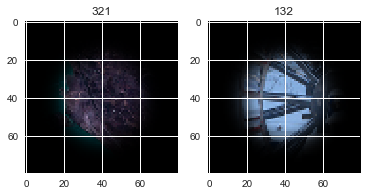

correlation:  -0.8187815458213835
means:  -0.12511121055501886  ,  0.03145066062417047


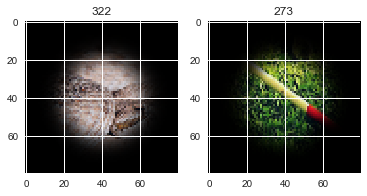

correlation:  -0.8823200142953732
means:  0.08754166882415361  ,  0.3882724794840446


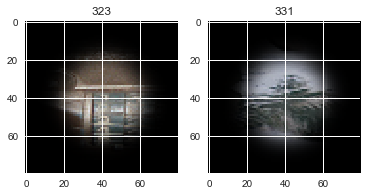

correlation:  -0.9035834162686913
means:  -0.20216226039263405  ,  0.2821858789483245


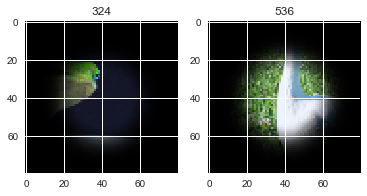

correlation:  -0.750853951922023
means:  -0.04890416897988606  ,  -0.29996710742323707


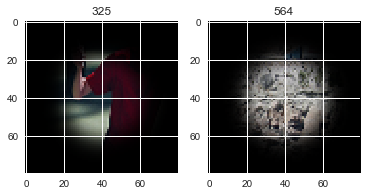

correlation:  -0.7251460297200295
means:  0.5992535010741843  ,  0.24573370672026698


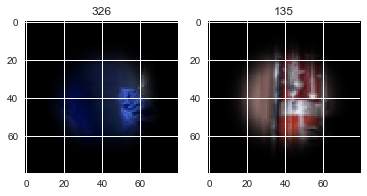

correlation:  -0.8071727979835898
means:  -0.27757043720306057  ,  -0.3007389421332138


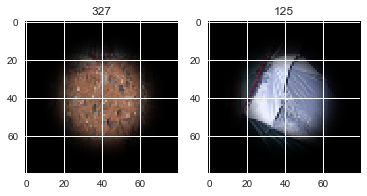

correlation:  -0.7741052684235211
means:  -0.18118312895124292  ,  0.9903468847300657


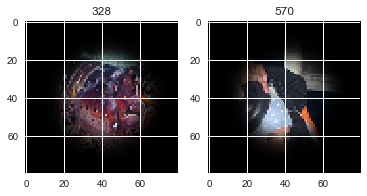

correlation:  -0.8011235840009864
means:  -0.44989736967734756  ,  -0.43750632536954187


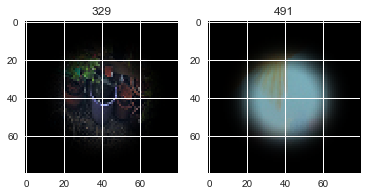

correlation:  -0.7937248981660348
means:  -0.22950910522720813  ,  0.1867588732651693


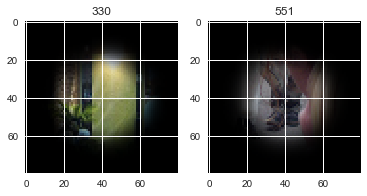

correlation:  -0.8823200142953732
means:  0.3882724794840446  ,  0.08754166882415361


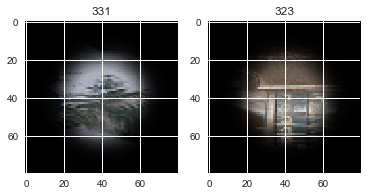

correlation:  -0.719977028804029
means:  0.003285335847043577  ,  -0.5119384574770878


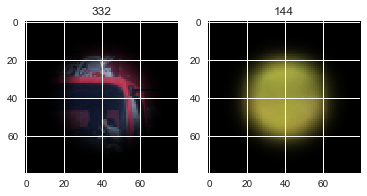

correlation:  -0.7772408856584483
means:  -0.4246778765278442  ,  -0.24145858233195458


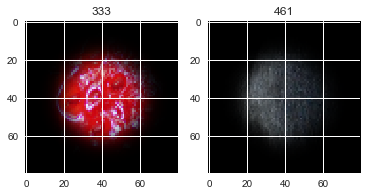

correlation:  -0.8932047585825573
means:  -0.22319234384681802  ,  -0.43750632536954187


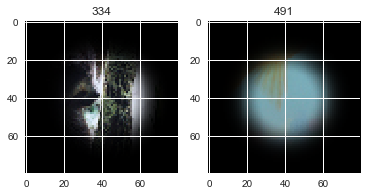

correlation:  -0.9493529593805284
means:  0.39810359949827134  ,  -1.4652639591358443


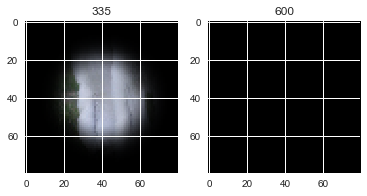

correlation:  -0.8189002543094607
means:  0.021646044254758877  ,  -0.4905477114638195


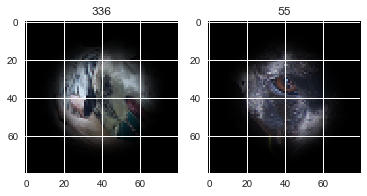

correlation:  -0.7150358811751484
means:  -0.006962551177307425  ,  0.18503836416741715


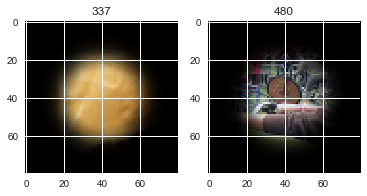

correlation:  -0.8251095237039201
means:  -0.4732293381018309  ,  0.6826087786561285


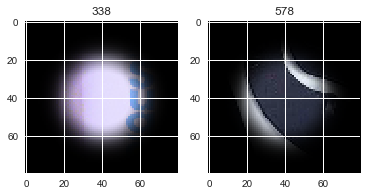

correlation:  -0.8100852769849484
means:  -0.2724161570738844  ,  0.5841379855603611


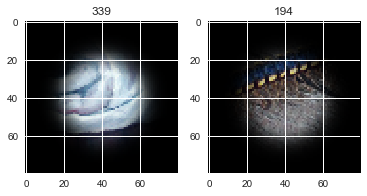

correlation:  -0.8411088786634067
means:  -0.09689739146776168  ,  -0.3408675241840722


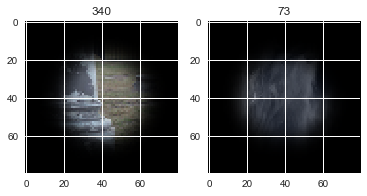

correlation:  -0.8016097935888375
means:  -0.19434435931389737  ,  -0.4128563184194697


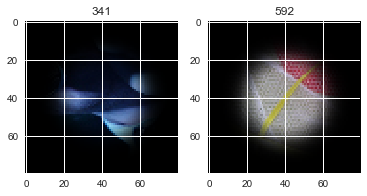

correlation:  -0.7681569333639362
means:  -0.13770611090818985  ,  -0.7557136281614528


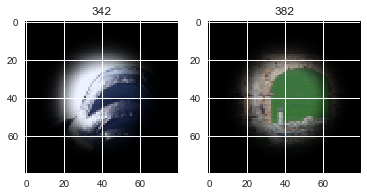

correlation:  -0.7560112572438354
means:  0.16016110188436922  ,  -0.26677550329284944


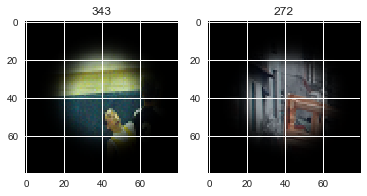

correlation:  -0.7597357655580893
means:  -0.012461599796203527  ,  -0.07272746721445392


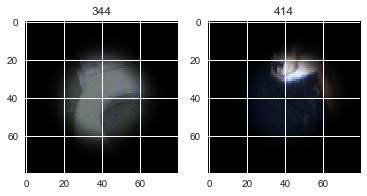

correlation:  -0.7471955497298378
means:  0.26247286215270343  ,  -0.3724887209068309


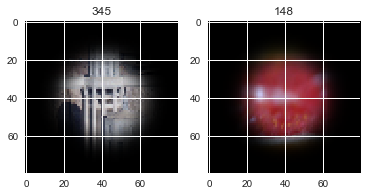

correlation:  -0.7228284099679269
means:  0.3423439243814657  ,  0.05135633855604887


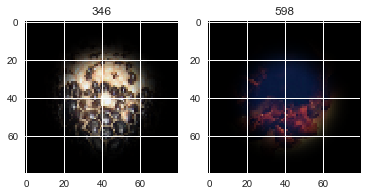

correlation:  -0.8390327571138315
means:  0.38980202956496157  ,  0.09527777272457678


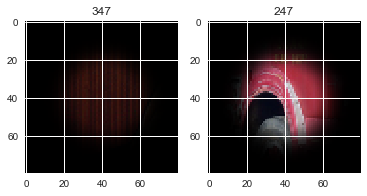

correlation:  -0.777879852629254
means:  0.1248320245914238  ,  -0.10660890014317831


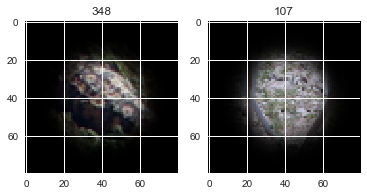

correlation:  -0.8270514449058057
means:  -0.47471834682655606  ,  -0.17021025152781163


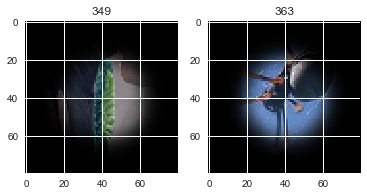

correlation:  -0.7589119321966835
means:  -0.00848630972381635  ,  -0.23761587825692285


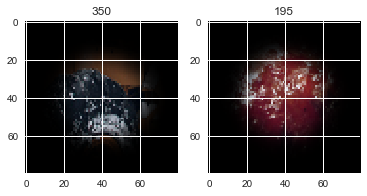

correlation:  -0.7875026750415365
means:  -0.29616345293988244  ,  -0.3623880241005052


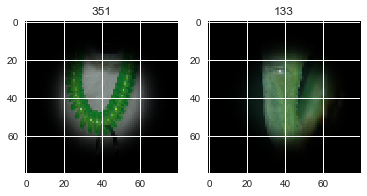

correlation:  -0.7902140477332048
means:  0.21204087521008522  ,  -1.4652639591358443


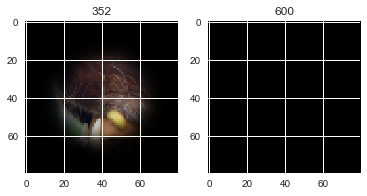

correlation:  -0.8015956821397305
means:  0.07752500053947874  ,  -0.36544244068374354


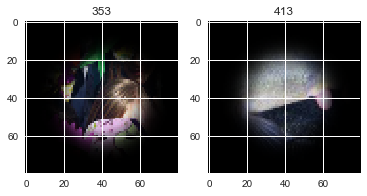

correlation:  -0.8403497267997853
means:  0.36326101736422833  ,  0.4350377947716831


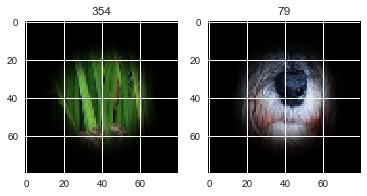

correlation:  -0.7220734127677658
means:  -0.39570832956617996  ,  0.14152578913105768


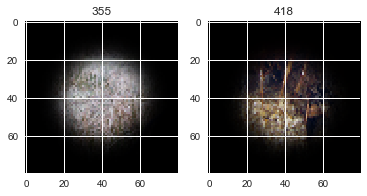

correlation:  -0.7787631039729357
means:  0.17234986355179605  ,  -0.21861548396119554


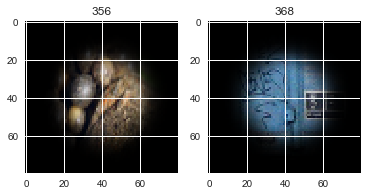

correlation:  -0.7365460527963915
means:  -0.22135396005436023  ,  0.20573251735579817


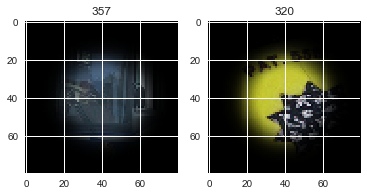

correlation:  -0.6855418025561414
means:  -0.023353142362042792  ,  -0.04760401837163633


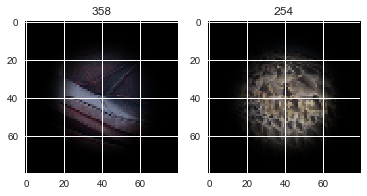

correlation:  -0.8149174401964681
means:  -0.4476363130048931  ,  -0.4258509475176776


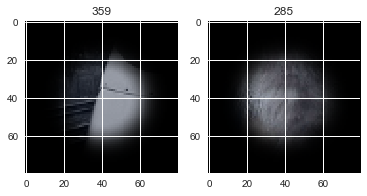

correlation:  -0.7895891082908627
means:  -0.2664623478352018  ,  0.05135633855604887


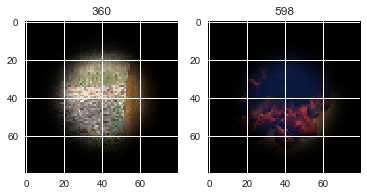

correlation:  -0.7664414841601823
means:  0.3802166465364913  ,  -0.006046404356143851


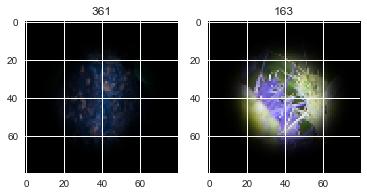

correlation:  -0.8963427453216549
means:  0.4254889379747222  ,  -0.14953376963315793


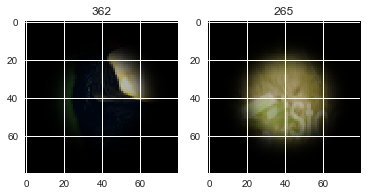

correlation:  -0.8270514449058057
means:  -0.17021025152781163  ,  -0.47471834682655606


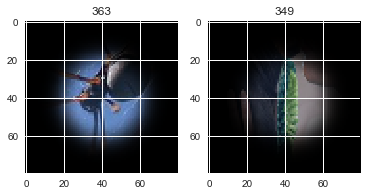

correlation:  -0.8591286994207729
means:  0.45872612782307504  ,  0.41089106034330647


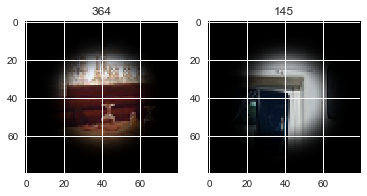

correlation:  -0.8266081624683101
means:  0.4385446042627344  ,  -0.20412305442947687


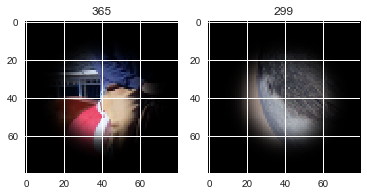

correlation:  -0.8312444113302997
means:  -0.3371151537184192  ,  0.472712622538051


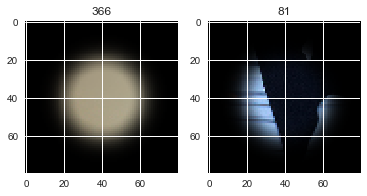

correlation:  -0.8588129490164577
means:  -0.25097369190110025  ,  -0.3228741210175776


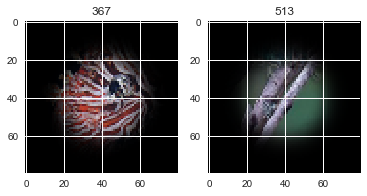

correlation:  -0.8256814768831466
means:  -0.21861548396119554  ,  -0.21996764686855205


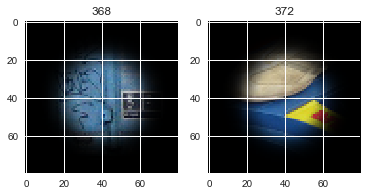

correlation:  -0.8585712695686166
means:  -0.18364033373014868  ,  -0.17175447361696458


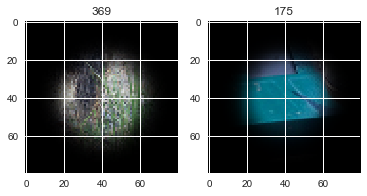

correlation:  -0.7643825534162965
means:  -0.2829175845293425  ,  0.472712622538051


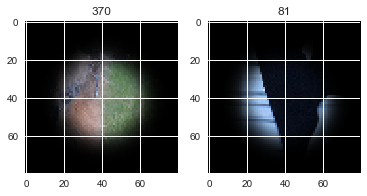

correlation:  -0.865156323995886
means:  -0.2265047681771886  ,  -0.4645376429233485


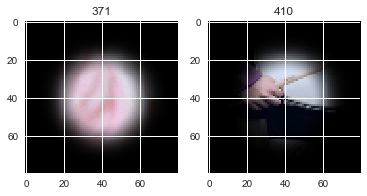

correlation:  -0.8480378581983177
means:  -0.21996764686855205  ,  0.2974980940699257


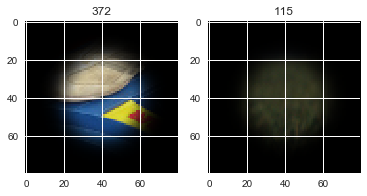

correlation:  -0.8452541870175188
means:  -0.25180705796730607  ,  -0.01292578751739587


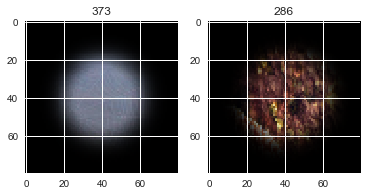

correlation:  -0.8152269877640466
means:  -0.5977646659858018  ,  0.09574656391301853


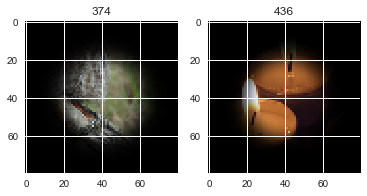

correlation:  -0.7387700859077544
means:  -0.22298039178645065  ,  -0.1811911157195326


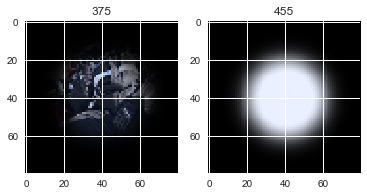

correlation:  -0.7573489842343804
means:  0.300792196868593  ,  0.04391403129246957


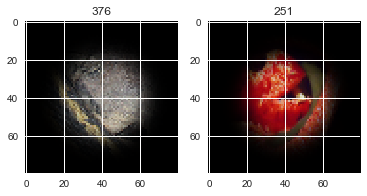

correlation:  -0.7737843555494376
means:  1.0160627295710638  ,  -0.26677550329284944


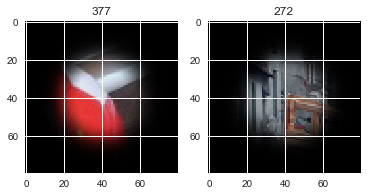

correlation:  -0.7693751535079498
means:  0.27067311780831543  ,  -0.06731739140093654


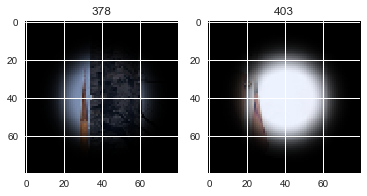

correlation:  -0.7253425654341006
means:  -0.40298893451196327  ,  -0.17023127368316662


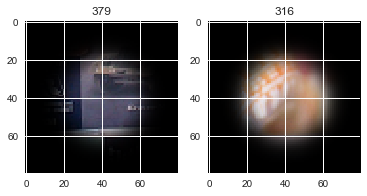

correlation:  -0.8234541553369726
means:  -0.4763969259765958  ,  -0.27152480849162414


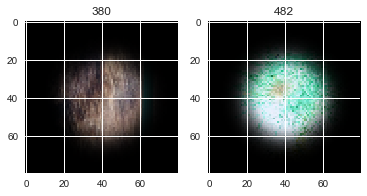

correlation:  -0.8199818683770146
means:  -0.1189120308630097  ,  0.36326101736422833


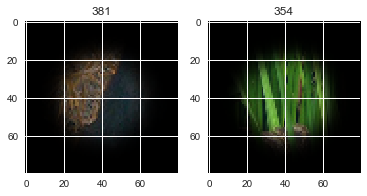

correlation:  -0.7809938881154949
means:  -0.7557136281614528  ,  -0.20216226039263405


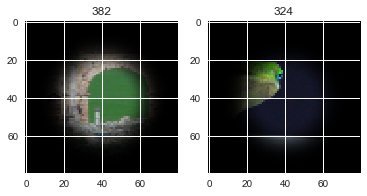

correlation:  -0.8075195813953882
means:  0.32946148454360996  ,  0.14449705057328888


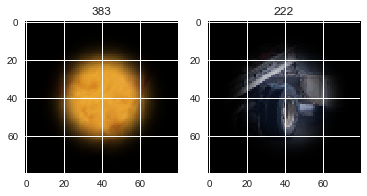

correlation:  -0.547513146404983
means:  0.3593348529907456  ,  -0.27869150754938543


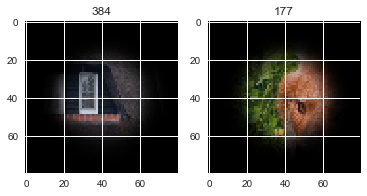

correlation:  -0.7791202475606517
means:  0.14662662975787785  ,  -0.3487101215988061


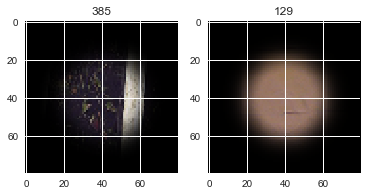

correlation:  -0.7605175584248169
means:  -0.204881179438068  ,  0.14449705057328888


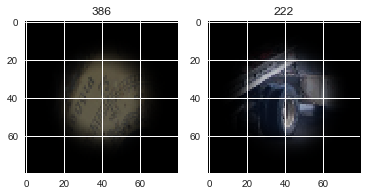

correlation:  -0.6956430679900354
means:  0.48526936442436847  ,  -0.18402515189237054


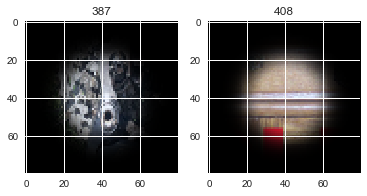

correlation:  -0.798648671129316
means:  -0.352677469799895  ,  -0.17747756041662202


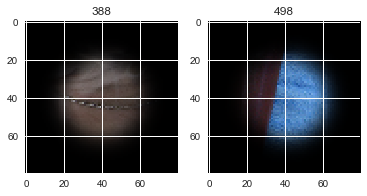

correlation:  -0.8024509911987098
means:  -0.023630888418542415  ,  -0.26677550329284944


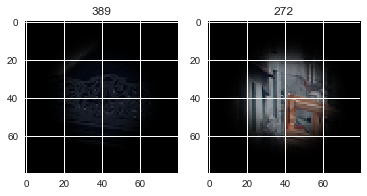

correlation:  -0.761300036431784
means:  -0.046632046351766814  ,  -0.09689739146776168


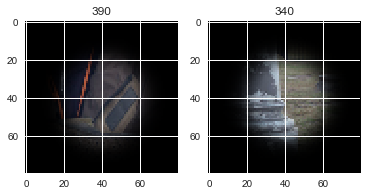

correlation:  -0.8633937192755795
means:  -0.43975758228459105  ,  0.15770907242137036


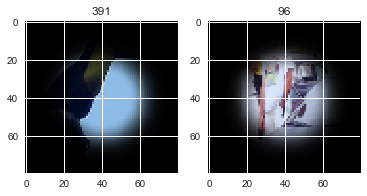

correlation:  -0.7640922937191772
means:  0.14649775057844552  ,  -0.43893507666519566


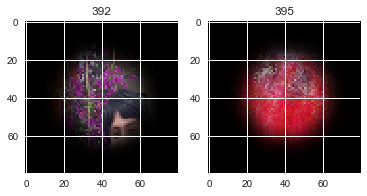

correlation:  -0.7922032657327912
means:  0.053936050671690265  ,  0.20573251735579817


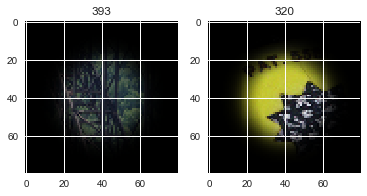

correlation:  -0.7573318933239841
means:  -0.1462984059511199  ,  -0.046632046351766814


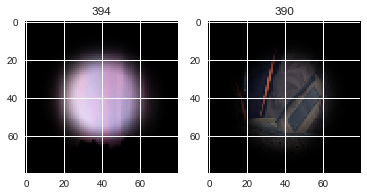

correlation:  -0.8592431547489673
means:  -0.43893507666519566  ,  -0.2501018671411857


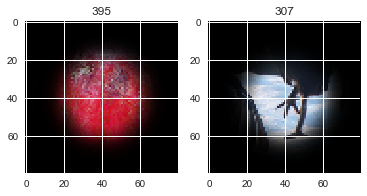

correlation:  -0.7197793054247286
means:  0.5577711696443243  ,  -0.19805722044624077


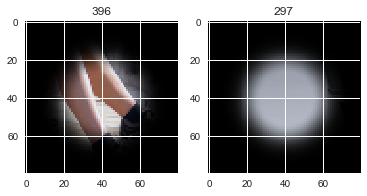

correlation:  -0.7794894237647441
means:  0.08936398413575541  ,  -0.40147097543611304


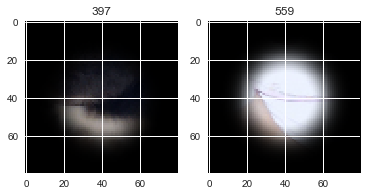

correlation:  -0.771355457221237
means:  0.014695168388468767  ,  1.0757364901796718


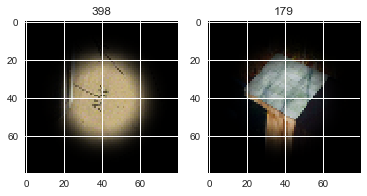

correlation:  -0.8097603843979018
means:  0.16794577508533476  ,  -0.48688095256338815


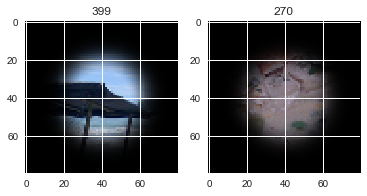

correlation:  -0.9279271917331559
means:  -0.48498352939718764  ,  -1.4652639591358443


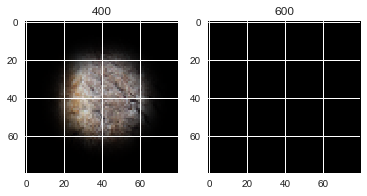

correlation:  -0.876588469974053
means:  0.07321383051743724  ,  -0.00705924533692171


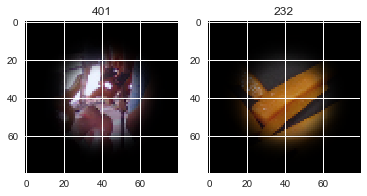

correlation:  -0.8195249001362336
means:  0.5979748821360092  ,  -0.4999931019352017


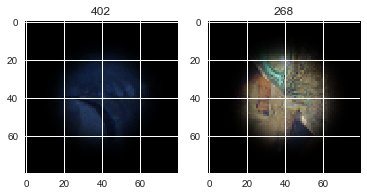

correlation:  -0.9447765308560369
means:  -0.06731739140093654  ,  -1.4652639591358443


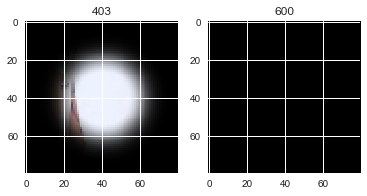

correlation:  -0.761309610918625
means:  -0.00020053852846912463  ,  -1.4652639591358443


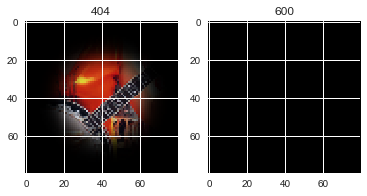

correlation:  -0.8137637079502218
means:  -0.131762436338249  ,  -0.3260227659506527


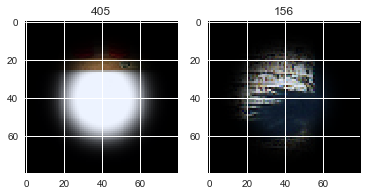

correlation:  -0.7931551403220987
means:  -0.321607873338173  ,  -0.4645376429233485


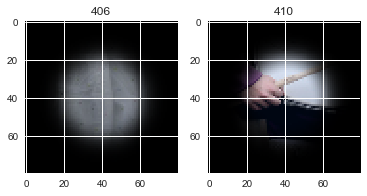

correlation:  -0.8419087414754935
means:  0.9745456262467417  ,  0.42453812450286


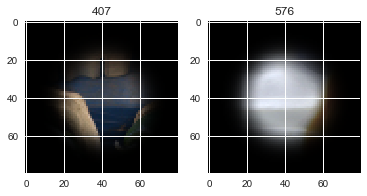

correlation:  -0.834373463361114
means:  -0.18402515189237054  ,  0.1626212638523737


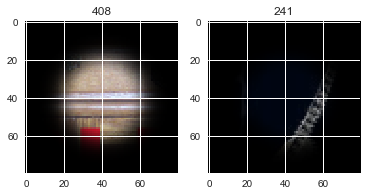

correlation:  -0.8227059166188229
means:  0.27931415516030905  ,  -1.4652639591358443


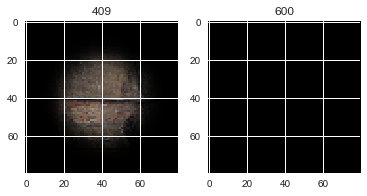

correlation:  -0.865156323995886
means:  -0.4645376429233485  ,  -0.2265047681771886


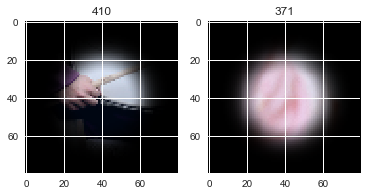

correlation:  -0.7210534439667009
means:  0.517887223583596  ,  0.5990266237852448


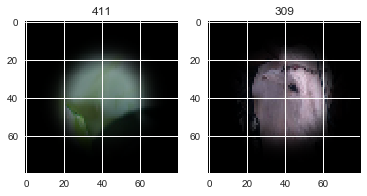

correlation:  -0.7494477952377016
means:  -0.4210919881531453  ,  -0.32115440990686667


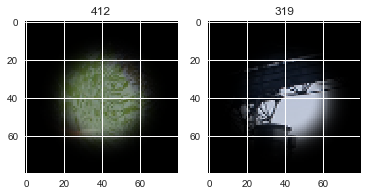

correlation:  -0.850481522305108
means:  -0.36544244068374354  ,  -0.38198677094286176


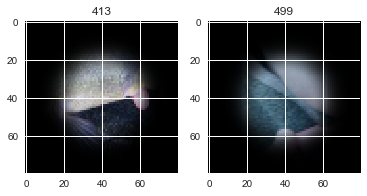

correlation:  -0.7597357655580893
means:  -0.07272746721445392  ,  -0.012461599796203527


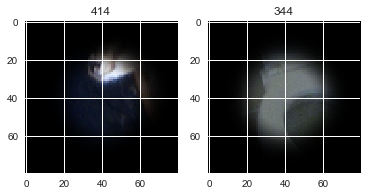

correlation:  -0.6892613430048798
means:  0.309464783604415  ,  -0.13021780675628228


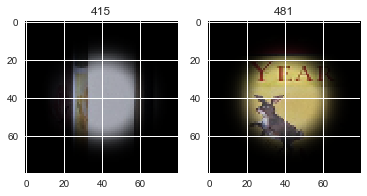

correlation:  -0.5983415792267983
means:  0.30988562594939884  ,  0.5419970540058835


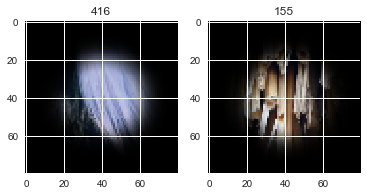

correlation:  -0.8409752506334688
means:  -0.3721868247314445  ,  0.23681720397025874


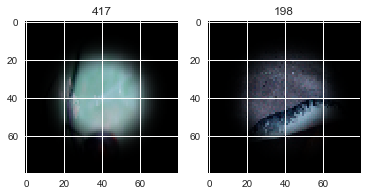

correlation:  -0.7220734127677658
means:  0.14152578913105768  ,  -0.39570832956617996


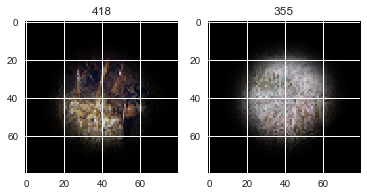

correlation:  -0.7837466389944624
means:  -0.08177987270848573  ,  0.5784372181080357


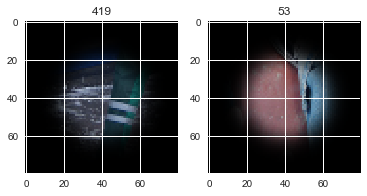

correlation:  -0.8304167704738118
means:  0.2848176270883292  ,  -0.3833303677120933


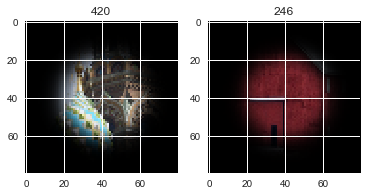

correlation:  -0.8257553826606315
means:  -0.5628038874291211  ,  -0.4999931019352017


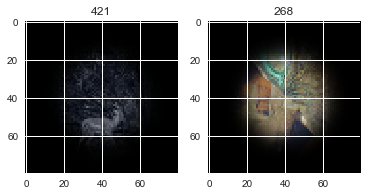

correlation:  -0.7384224394619415
means:  -0.1201705135231164  ,  -0.33604937177111605


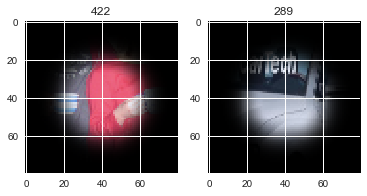

correlation:  -0.9232032364627708
means:  0.09802656652564243  ,  -1.4652639591358443


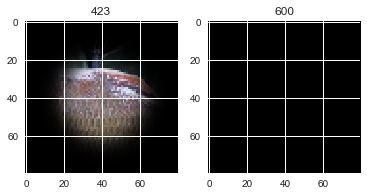

correlation:  -0.7491471197042985
means:  -0.03864947045818726  ,  0.16794577508533476


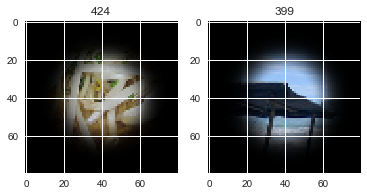

correlation:  -0.7946350458572127
means:  -0.016635121522370292  ,  -0.24169267877107722


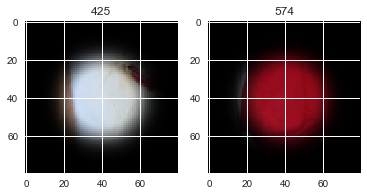

correlation:  -0.8293419907727688
means:  0.20303576463003445  ,  -0.06731739140093654


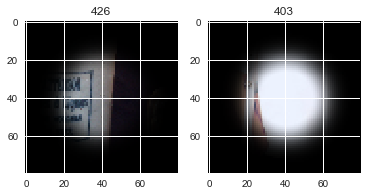

correlation:  -0.8040880352171317
means:  -0.22763760112337145  ,  -0.4763969259765958


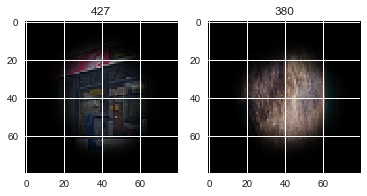

correlation:  -0.7300217880375266
means:  -0.004233162567091442  ,  -0.046928127596483446


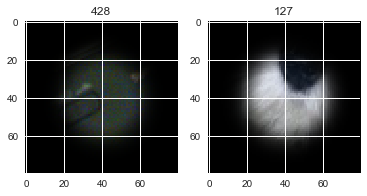

correlation:  -0.7025124785984994
means:  -0.06551246663174326  ,  0.20573251735579817


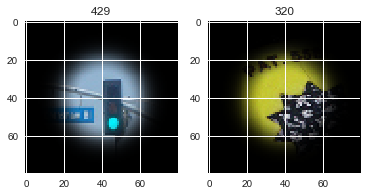

correlation:  -0.7586710013288704
means:  0.313931453659047  ,  0.4350377947716831


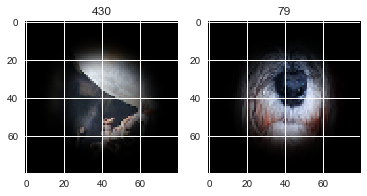

correlation:  -0.9355432138843882
means:  0.09744698720836746  ,  -1.4652639591358443


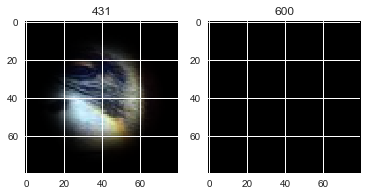

correlation:  -0.7981498919818623
means:  0.3232054724889706  ,  0.36309800039551754


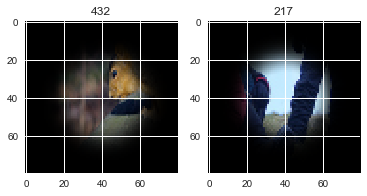

correlation:  -0.8025303327608159
means:  0.6540418432165833  ,  -0.21038957029846667


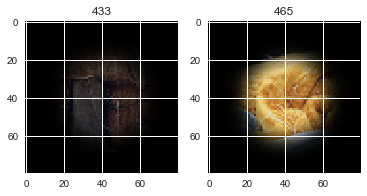

correlation:  -0.7525736094649517
means:  -0.060262671996479084  ,  0.27931415516030905


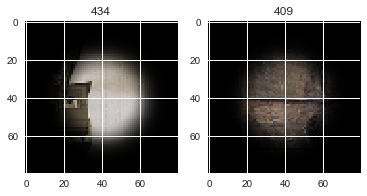

correlation:  -0.6362268896953516
means:  0.028584970585862048  ,  -0.2252496622614865


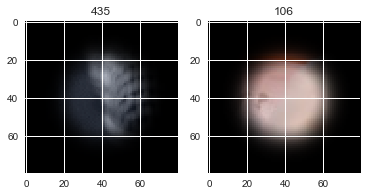

correlation:  -0.8152269877640466
means:  0.09574656391301853  ,  -0.5977646659858018


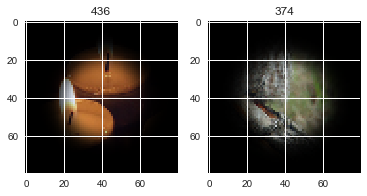

correlation:  -0.821814896399898
means:  0.10336252643920406  ,  -0.3833303677120933


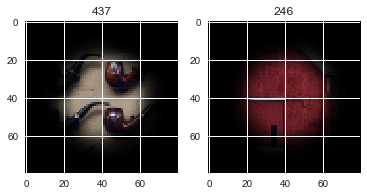

correlation:  -0.7729421887797556
means:  0.2608175970608622  ,  0.473400874378734


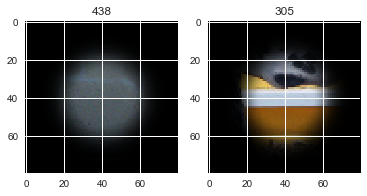

correlation:  -0.8294606889100639
means:  -0.17286565650745941  ,  -0.2148505608966454


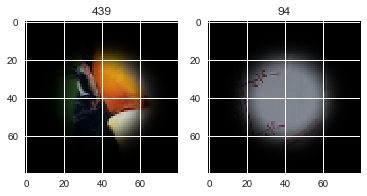

correlation:  -0.8007338420599706
means:  -0.27353884127084155  ,  0.48378716442332975


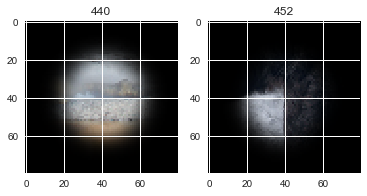

correlation:  -0.7997954255087779
means:  0.40652279234326644  ,  0.12374864867420092


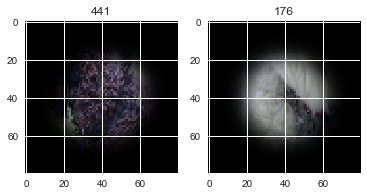

correlation:  -0.7539695544100854
means:  -0.23274682334359936  ,  0.20573251735579817


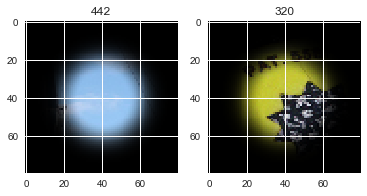

correlation:  -0.9024823977630753
means:  -0.12207283775232089  ,  -0.31180675203057046


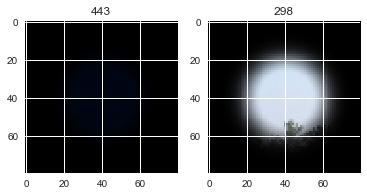

correlation:  -0.8082213233985728
means:  0.15098398771737695  ,  -0.24072233574173565


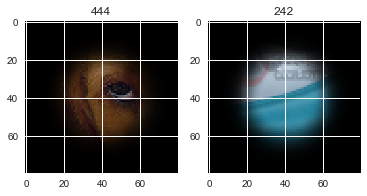

correlation:  -0.861638384514756
means:  -0.042332894228225164  ,  -0.24293214606215152


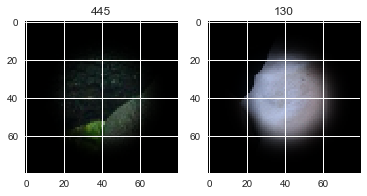

correlation:  -0.7703226567577114
means:  -0.3177598959475037  ,  -0.08054134026742994


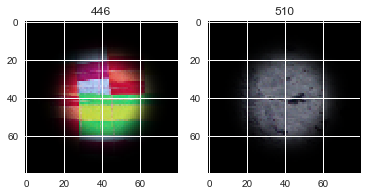

correlation:  -0.745139137032556
means:  0.24992710915253458  ,  0.8170827181141102


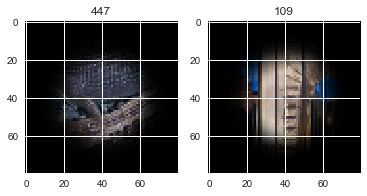

correlation:  -0.7931058405743175
means:  -0.03685689641613766  ,  -0.19046260442146898


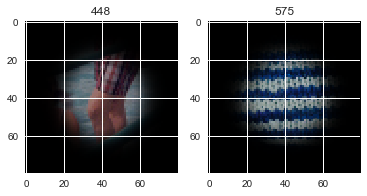

correlation:  -0.7116235026940452
means:  0.052537457542540314  ,  0.12374864867420092


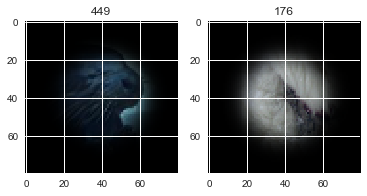

correlation:  -0.7399404118015813
means:  0.45063659906718007  ,  0.6541512737942416


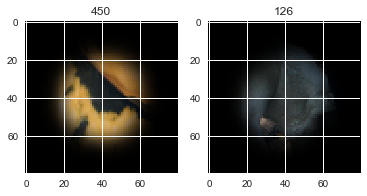

correlation:  -0.747871080653519
means:  -0.0762374720374198  ,  0.09806805870472789


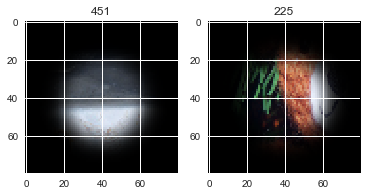

correlation:  -0.8007338420599706
means:  0.48378716442332975  ,  -0.27353884127084155


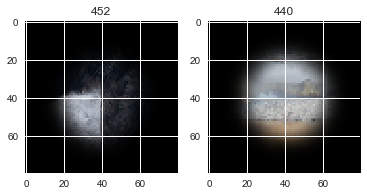

correlation:  -0.7681328921009832
means:  0.22920086589016303  ,  0.39782240225559434


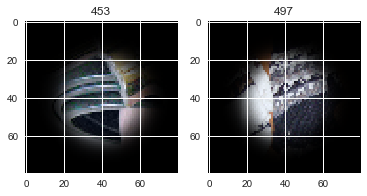

correlation:  -0.7045180199810587
means:  0.1561009408550674  ,  -0.2175506514205424


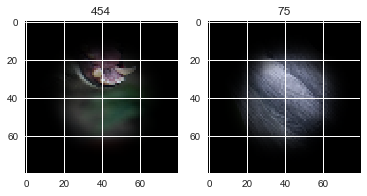

correlation:  -0.7955481131556583
means:  -0.1811911157195326  ,  -0.24169267877107722


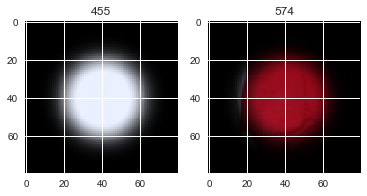

correlation:  -0.7421577017738535
means:  -0.3129408315121396  ,  0.6826087786561285


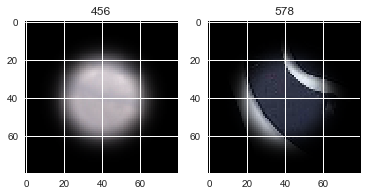

correlation:  -0.6730206938445261
means:  0.3959403921666279  ,  -0.09364482857978879


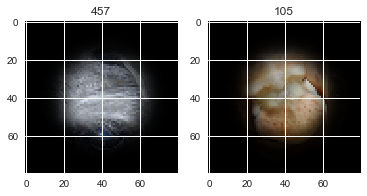

correlation:  -0.7967440268818267
means:  -0.42889682109315913  ,  -0.21996764686855205


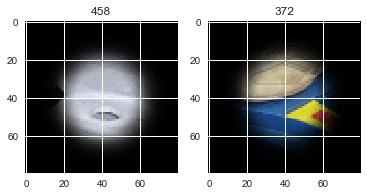

correlation:  -0.7921360340421502
means:  -0.35666178404311427  ,  0.15770907242137036


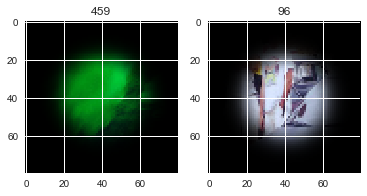

correlation:  -0.8096757716229338
means:  -0.28106204801000456  ,  0.00613800801382892


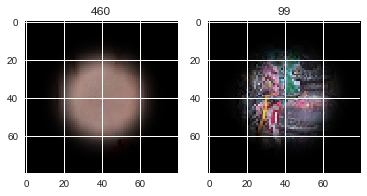

correlation:  -0.8367778624644808
means:  -0.24145858233195458  ,  -0.24861632641170728


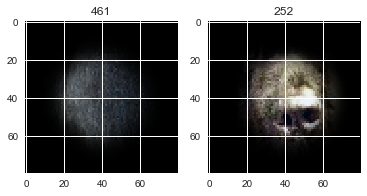

correlation:  -0.5883157803290555
means:  -0.13193672561266062  ,  0.13593330655445476


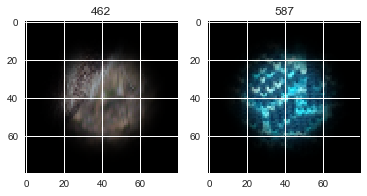

correlation:  -0.7466395981850437
means:  -0.012398701079188416  ,  -0.29616345293988244


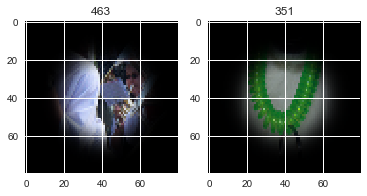

correlation:  -0.8050004336462199
means:  -0.3742027586608717  ,  -0.2293109657430742


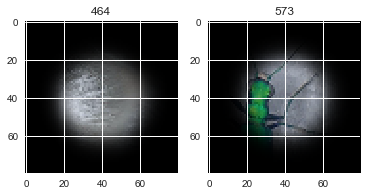

correlation:  -0.8025303327608159
means:  -0.21038957029846667  ,  0.6540418432165833


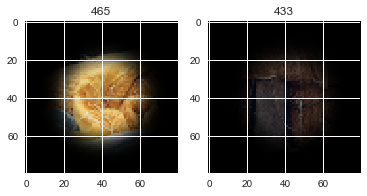

correlation:  -0.6770234647823381
means:  -0.053512432008689596  ,  0.14649775057844552


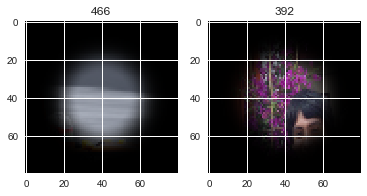

correlation:  -0.7670207707828727
means:  0.04415965587240464  ,  -0.2293109657430742


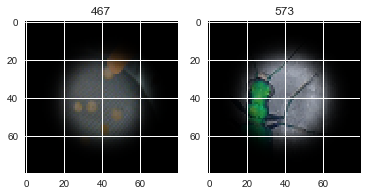

correlation:  -0.7300315271718713
means:  1.1085569928351282  ,  -0.08096792232843485


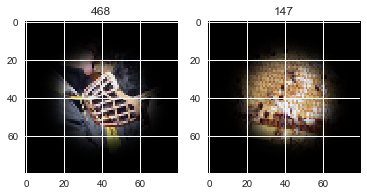

correlation:  -0.8102109339339526
means:  -0.22759543142738525  ,  0.021646044254758877


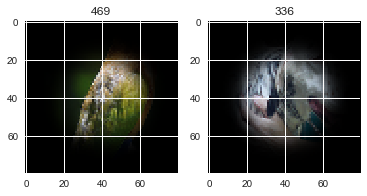

correlation:  -0.7933561732357689
means:  -0.20503389577306477  ,  -0.1189120308630097


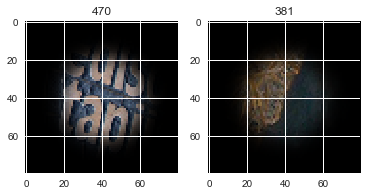

correlation:  -0.9037648196291274
means:  0.0691679125774749  ,  0.14449705057328888


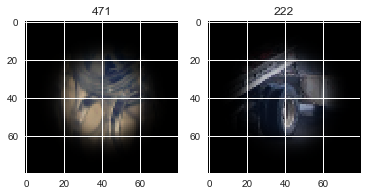

correlation:  -0.789765871229
means:  -0.05633345229576443  ,  -0.31194280837025057


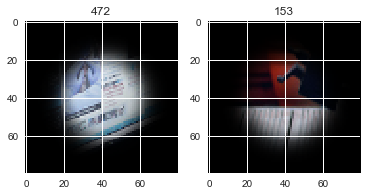

correlation:  -0.7587794475155486
means:  0.07196999315278316  ,  1.0757364901796718


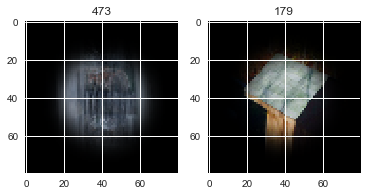

correlation:  -0.7811756869074363
means:  -0.42865314863116527  ,  -0.15417443486983748


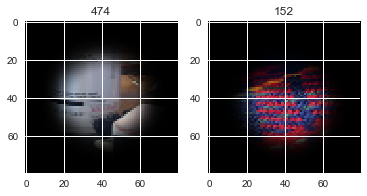

correlation:  -0.790945094582958
means:  0.36369794938547495  ,  0.6826087786561285


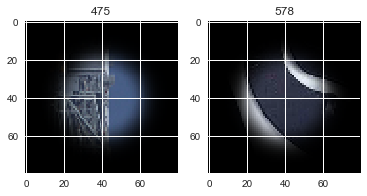

correlation:  -0.829574901398504
means:  -0.13374714588564407  ,  0.04747568251088071


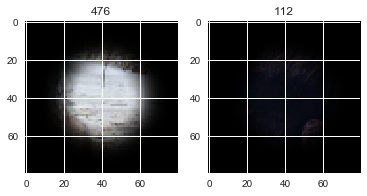

correlation:  -0.7818663454129015
means:  -0.7615651251553721  ,  0.273516530233975


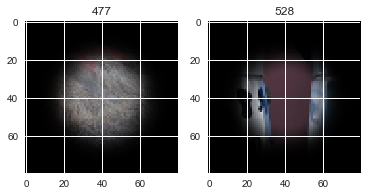

correlation:  -0.7917454580600264
means:  0.336204442026465  ,  -0.3833303677120933


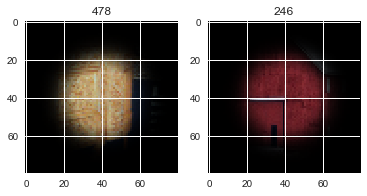

correlation:  -0.8518945484562858
means:  0.11660906857447878  ,  0.0691679125774749


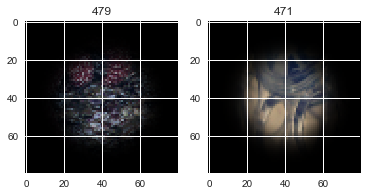

correlation:  -0.7999808650465327
means:  0.18503836416741715  ,  -0.4999931019352017


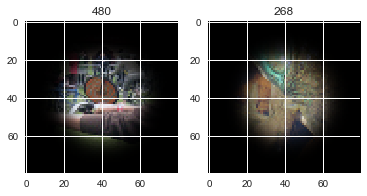

correlation:  -0.7572682517201877
means:  -0.13021780675628228  ,  0.4149953954940294


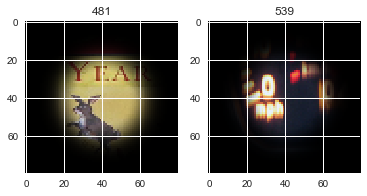

correlation:  -0.8234541553369726
means:  -0.27152480849162414  ,  -0.4763969259765958


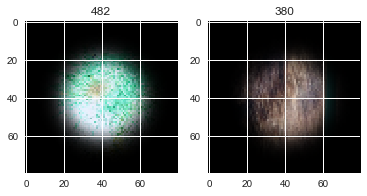

correlation:  -0.7582877894220631
means:  0.48762612286941337  ,  0.3075279464879927


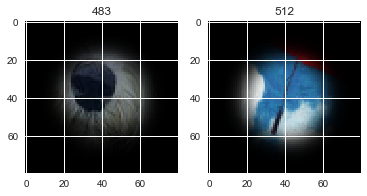

correlation:  -0.7450407919719035
means:  -0.6569202788435398  ,  -0.3833303677120933


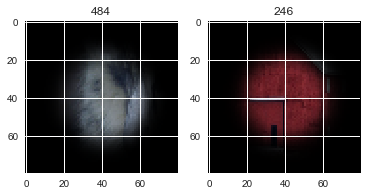

correlation:  -0.8560379741750663
means:  -0.3435376979258626  ,  -0.3405142643750854


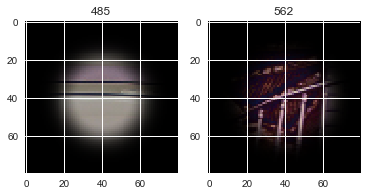

correlation:  -0.7437322723271361
means:  -0.35526438799061794  ,  0.2848176270883292


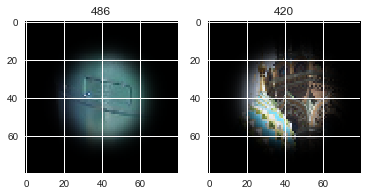

correlation:  -0.7794542908684707
means:  -0.4124277011718995  ,  0.5419970540058835


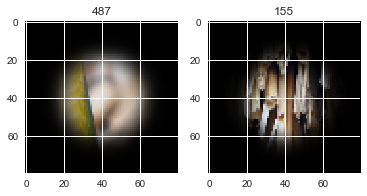

correlation:  -0.830063357674198
means:  -0.0473686557718054  ,  -0.3833303677120933


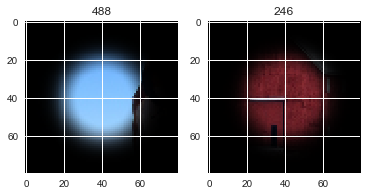

correlation:  -0.7949872301377623
means:  -0.20266878937433275  ,  0.30817815650290864


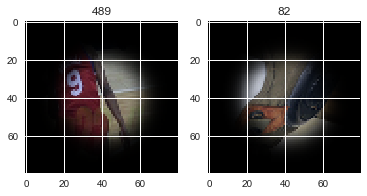

correlation:  -0.7477958000230122
means:  0.49885560234322585  ,  0.021646044254758877


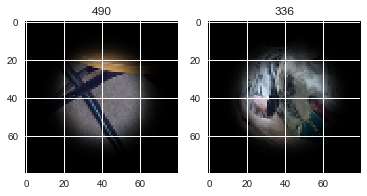

correlation:  -0.8932047585825573
means:  -0.43750632536954187  ,  -0.22319234384681802


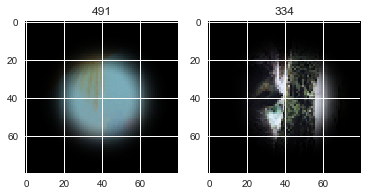

correlation:  -0.7429041213741818
means:  0.20051021523295762  ,  -1.4652639591358443


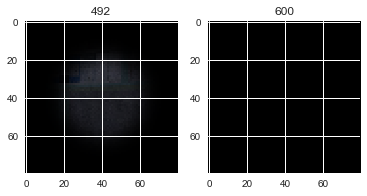

correlation:  -0.8504425811612097
means:  -0.18944044960470488  ,  -0.09492505230637956


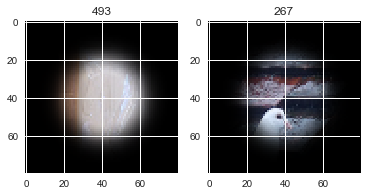

correlation:  -0.7956644739479146
means:  0.19819632024255282  ,  -0.20030575110295093


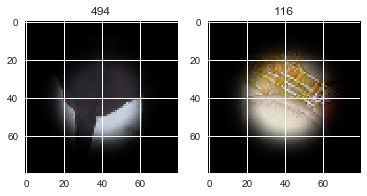

correlation:  -0.7029783969174436
means:  0.22369806996618324  ,  0.27139074270477337


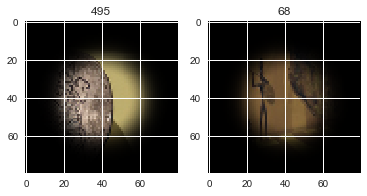

correlation:  -0.7751876592270237
means:  0.8959340457930629  ,  0.7476911102788383


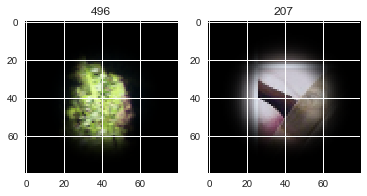

correlation:  -0.7681328921009832
means:  0.39782240225559434  ,  0.22920086589016303


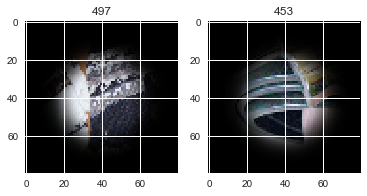

correlation:  -0.8184951576632893
means:  -0.17747756041662202  ,  0.24573370672026698


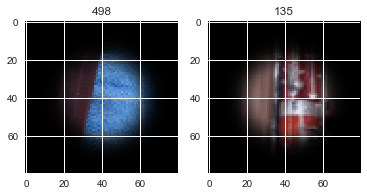

correlation:  -0.850481522305108
means:  -0.38198677094286176  ,  -0.36544244068374354


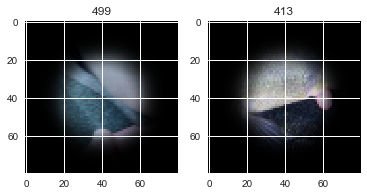

correlation:  -0.7782050853580283
means:  0.04822459664623588  ,  -1.4652639591358443


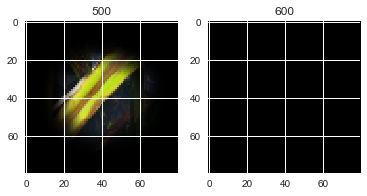

correlation:  -0.8218503171056473
means:  -0.30682689955682635  ,  -0.01292578751739587


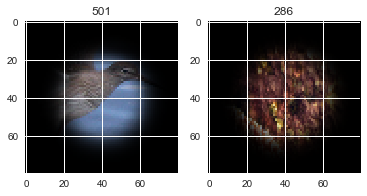

correlation:  -0.7730400292671616
means:  -0.18406062655178748  ,  0.1717991153349208


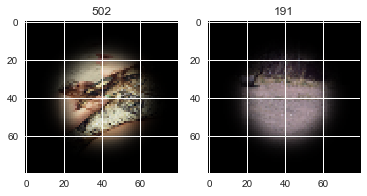

correlation:  -0.6847166932200652
means:  0.2125954258594059  ,  -0.1189120308630097


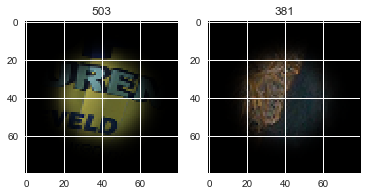

correlation:  -0.8105989172192716
means:  0.4886866504271384  ,  0.05958104628759657


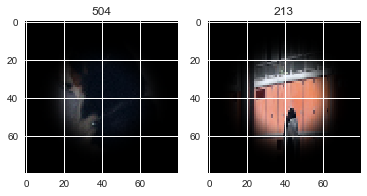

correlation:  -0.6771954218904906
means:  0.16771263073155968  ,  0.1660611955761043


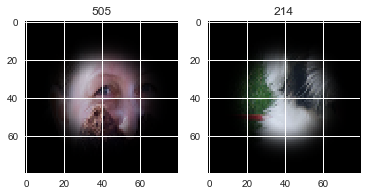

correlation:  -0.8344946390554804
means:  0.21418969143672958  ,  -1.4652639591358443


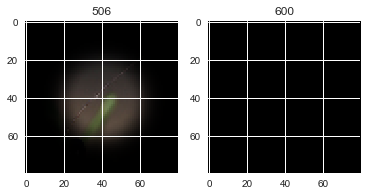

correlation:  -0.8181685639981439
means:  0.04727541757152543  ,  0.20573251735579817


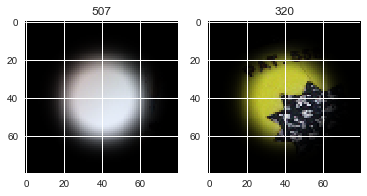

correlation:  -0.7256767148932182
means:  -0.007941477204459334  ,  -0.13745139668060616


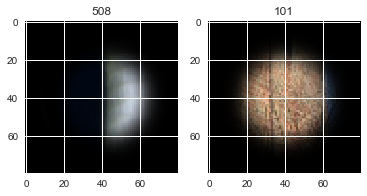

correlation:  -0.8112121595408635
means:  -0.10937591312392483  ,  -1.4652639591358443


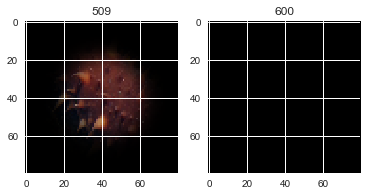

correlation:  -0.7963805242770593
means:  -0.08054134026742994  ,  0.46110788372828715


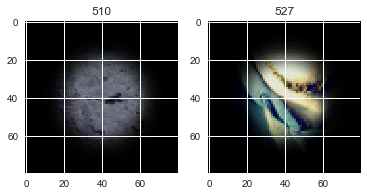

correlation:  -0.6946812130879471
means:  0.6077156419794822  ,  0.20573251735579817


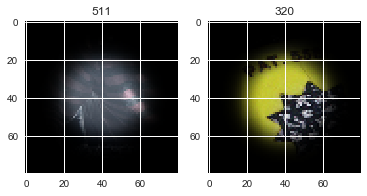

correlation:  -0.7582877894220631
means:  0.3075279464879927  ,  0.48762612286941337


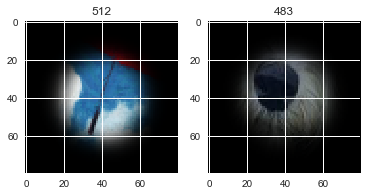

correlation:  -0.8927751561969204
means:  -0.3228741210175776  ,  -0.06094974842433727


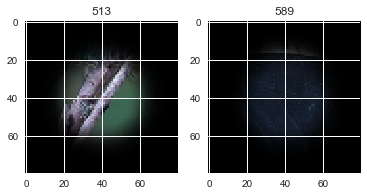

correlation:  -0.9830481390762826
means:  0.42778863624694474  ,  -1.4652639591358443


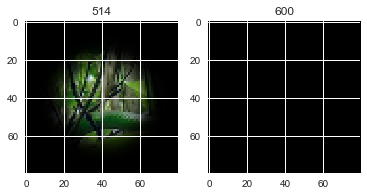

correlation:  -0.7733837975746659
means:  0.2891846240517956  ,  -0.1811911157195326


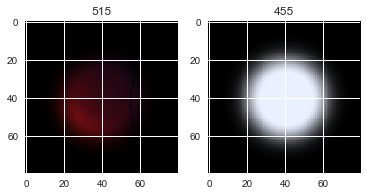

correlation:  -0.8506931942667548
means:  0.02511879506625989  ,  -0.24554805243311684


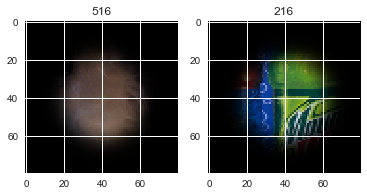

correlation:  -0.7781712789559765
means:  -0.16731013466440206  ,  0.19786491773828832


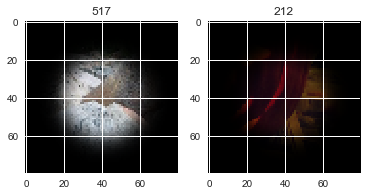

correlation:  -0.7042270557429051
means:  -0.16715259105148889  ,  0.5990266237852448


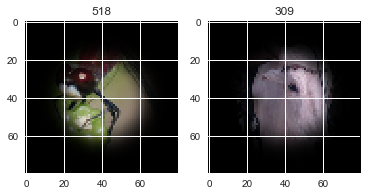

correlation:  -0.7477397797123962
means:  -0.5490275932655944  ,  0.1746692997602971


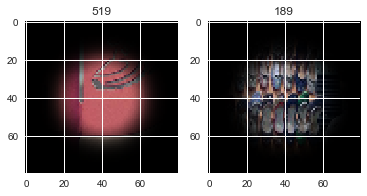

correlation:  -0.703522887404904
means:  0.1261108510223152  ,  0.5841379855603611


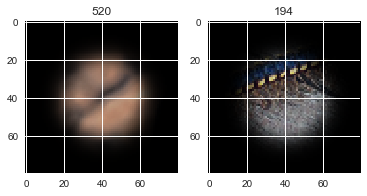

correlation:  -0.7477250042516674
means:  0.38117554879918925  ,  -0.20802465596677178


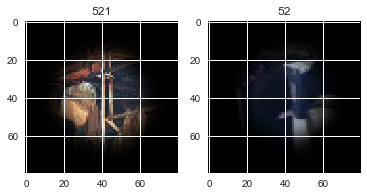

correlation:  -0.855072583506988
means:  -0.1288590907725604  ,  -1.4652639591358443


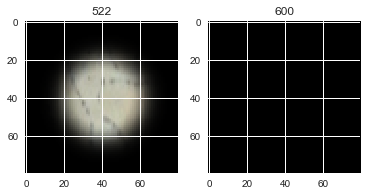

correlation:  -0.7815179370171323
means:  -0.2327951173965239  ,  0.16794577508533476


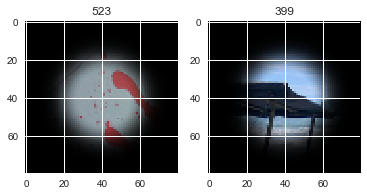

correlation:  -0.6898691415425172
means:  0.30385869269925814  ,  0.48378716442332975


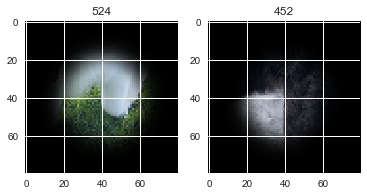

correlation:  -0.8004200512792292
means:  0.17542684795662541  ,  -0.6822192025815755


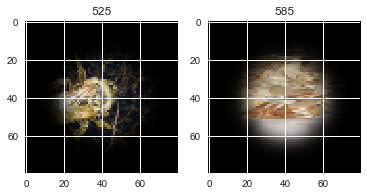

correlation:  -0.825909614735051
means:  -0.166928082857111  ,  -0.18944044960470488


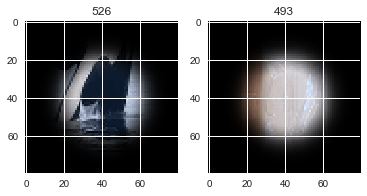

correlation:  -0.7983268922494183
means:  0.46110788372828715  ,  0.6541512737942416


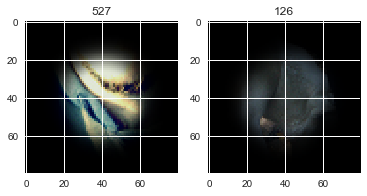

correlation:  -0.9005878499842335
means:  0.273516530233975  ,  -0.06823380520674732


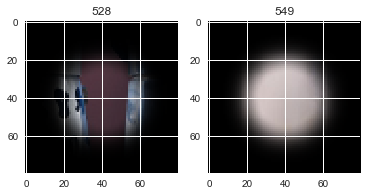

correlation:  -0.758266655357464
means:  0.2778397974831313  ,  0.3882724794840446


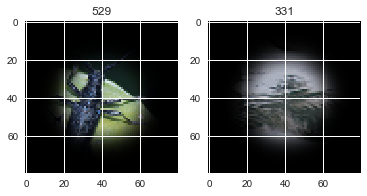

correlation:  -0.7180171690970939
means:  0.06939247971260841  ,  0.09806805870472789


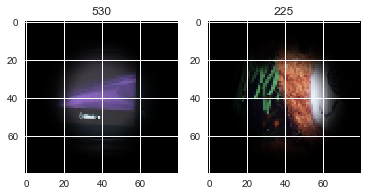

correlation:  -0.7856562544230205
means:  -0.2005603420937807  ,  0.17440602980345252


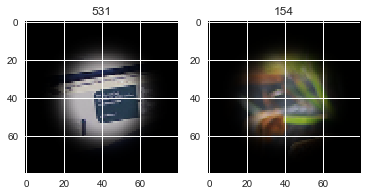

correlation:  -0.786000492643406
means:  -0.3719115692964388  ,  0.17440602980345252


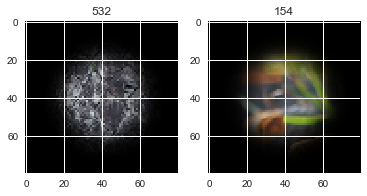

correlation:  -0.842259556555937
means:  -0.46529195416608665  ,  0.20573251735579817


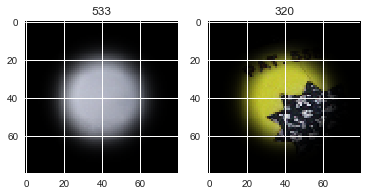

correlation:  -0.7698482818378286
means:  0.017229688540591558  ,  -0.14953376963315793


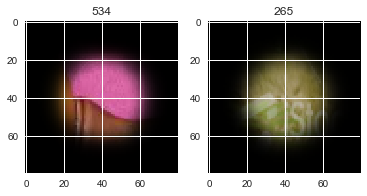

correlation:  -0.7874388310210323
means:  0.3780708759739081  ,  -0.09492505230637956


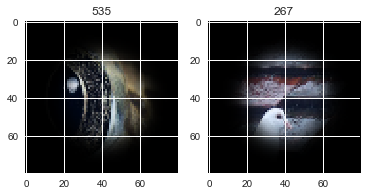

correlation:  -0.9035834162686913
means:  0.2821858789483245  ,  -0.20216226039263405


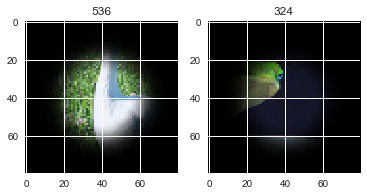

correlation:  -0.825420865054914
means:  0.024713037780595602  ,  -0.09359972294607792


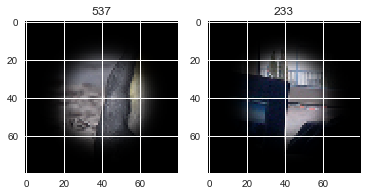

correlation:  -0.8153968451973275
means:  -0.3190890919583182  ,  0.22284639926486838


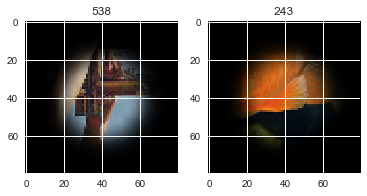

correlation:  -0.7757261266052098
means:  0.4149953954940294  ,  -0.33604937177111605


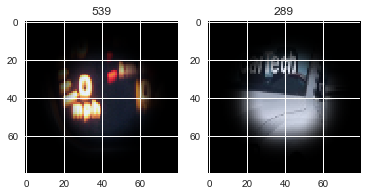

correlation:  -0.7924021662324612
means:  -0.04549143566265382  ,  -0.19046260442146898


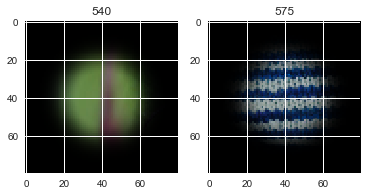

correlation:  -0.783015983958486
means:  -0.44727471958703635  ,  -0.4912209855496464


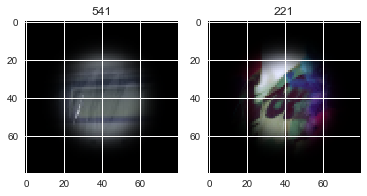

correlation:  -0.7692927108492592
means:  -0.2981930737981295  ,  0.1746692997602971


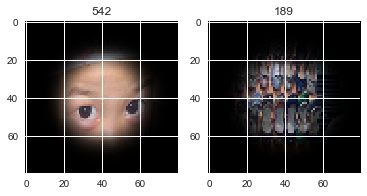

correlation:  -0.7010638590037334
means:  0.06715801183990967  ,  0.2532508654138547


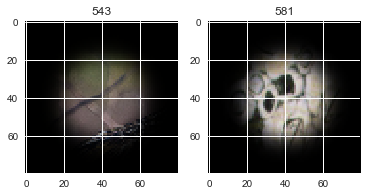

correlation:  -0.7375315338241656
means:  0.2119823745030726  ,  0.2848176270883292


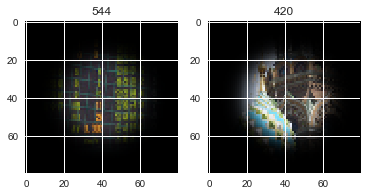

correlation:  -0.8150469483166699
means:  -0.23464854458363707  ,  0.4385446042627344


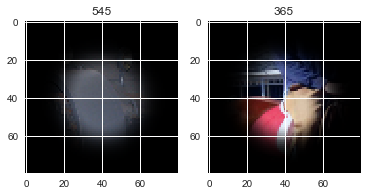

correlation:  -0.7061407608818129
means:  -0.3138981778484005  ,  -0.15557095683424763


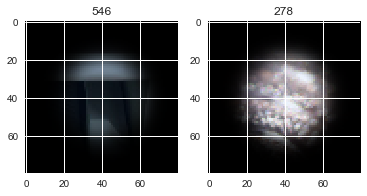

correlation:  -0.7804902256240581
means:  -0.45059812038959707  ,  -0.31180675203057046


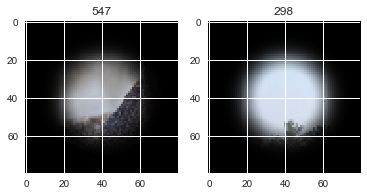

correlation:  -0.7322261451011483
means:  0.798014403869771  ,  -1.4652639591358443


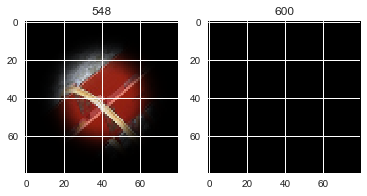

correlation:  -0.9005878499842335
means:  -0.06823380520674732  ,  0.273516530233975


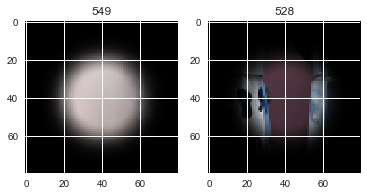

correlation:  -0.8974907355022173
means:  -0.163333911457193  ,  -0.20412305442947687


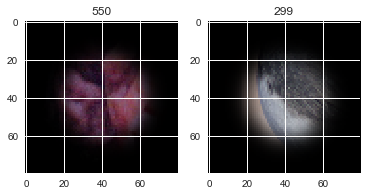

correlation:  -0.8370695226422902
means:  0.1867588732651693  ,  0.08754166882415361


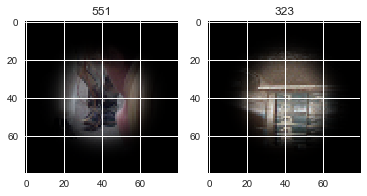

correlation:  -0.7722363654142841
means:  -0.19430133791028623  ,  -0.19046260442146898


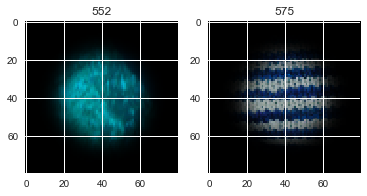

correlation:  -0.7757249188281108
means:  0.11718248029617512  ,  -0.10997078800813875


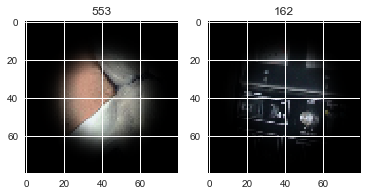

correlation:  -0.7875255702282349
means:  0.15019961310726462  ,  -0.23870946017719818


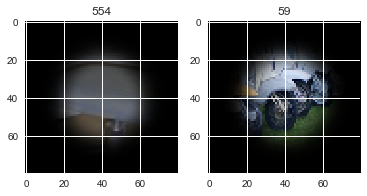

correlation:  -0.6236612847756349
means:  0.46052382135698006  ,  0.5990266237852448


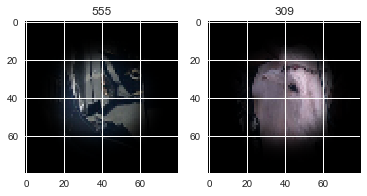

correlation:  -0.7714860890087752
means:  0.3742588478190374  ,  -0.36537828083037655


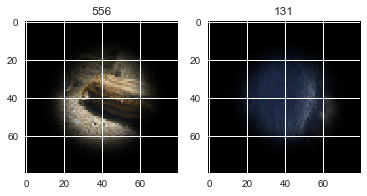

correlation:  -0.7085526050932457
means:  -0.16102899662925838  ,  0.15770907242137036


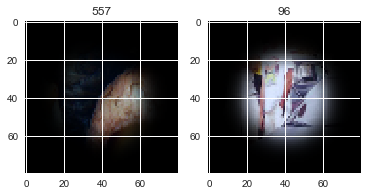

correlation:  -0.7904454487459707
means:  0.251644983441126  ,  0.16322478620586456


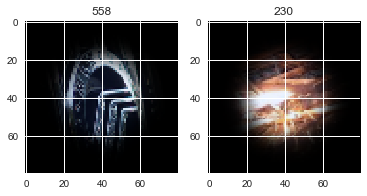

correlation:  -0.7814889892305958
means:  -0.40147097543611304  ,  -0.4645376429233485


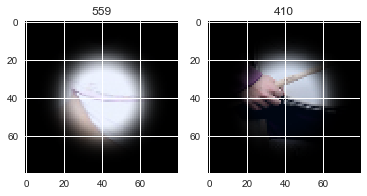

correlation:  -0.7696705927895825
means:  -0.11687010292077371  ,  -0.22950910522720813


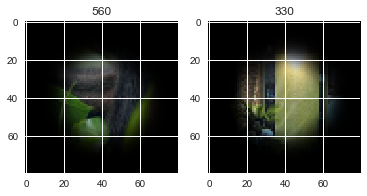

correlation:  -0.7615969100170039
means:  0.8912198764065405  ,  0.3729076701043097


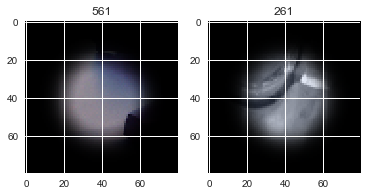

correlation:  -0.8865131786105632
means:  -0.3405142643750854  ,  -0.3487101215988061


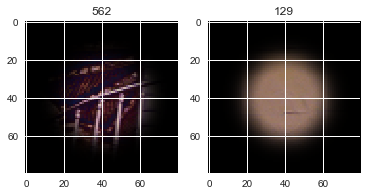

correlation:  -0.7932180130652524
means:  0.3137170361166692  ,  -1.4652639591358443


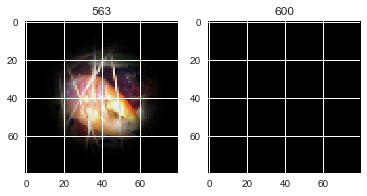

correlation:  -0.750853951922023
means:  -0.29996710742323707  ,  -0.04890416897988606


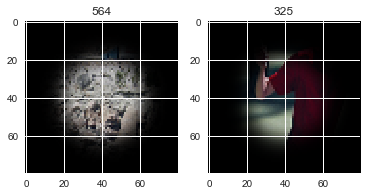

correlation:  -0.754194957112586
means:  -0.6488351720042389  ,  -0.0607473201501686


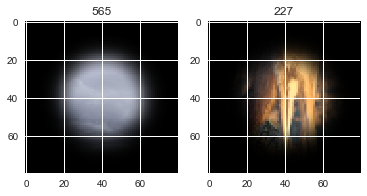

correlation:  -0.7443157694317637
means:  0.09123209610212885  ,  0.39782240225559434


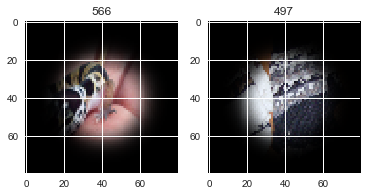

correlation:  -0.7875535450570463
means:  -0.020726156975098886  ,  -0.17671430346649306


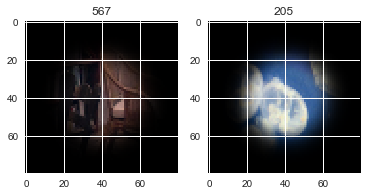

correlation:  -0.5896285353698698
means:  0.47350992390901414  ,  0.13637969107654185


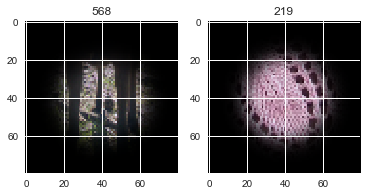

correlation:  -0.7869561434901594
means:  -0.15834300327490755  ,  -0.2265047681771886


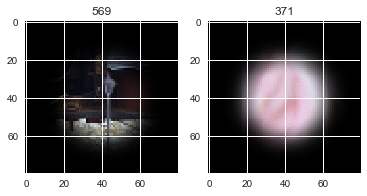

correlation:  -0.8276938322187359
means:  0.9903468847300657  ,  -0.13341370742542982


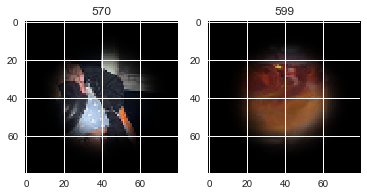

correlation:  -0.7951942225543478
means:  0.1749262463458826  ,  0.3729076701043097


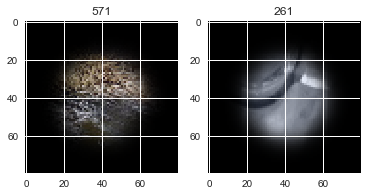

correlation:  -0.7970114212602522
means:  -0.017923520764866318  ,  -0.12207283775232089


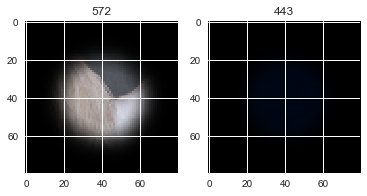

correlation:  -0.8050004336462199
means:  -0.2293109657430742  ,  -0.3742027586608717


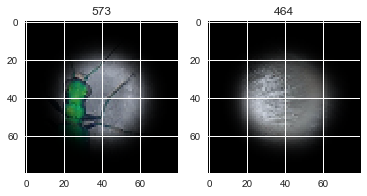

correlation:  -0.7955481131556583
means:  -0.24169267877107722  ,  -0.1811911157195326


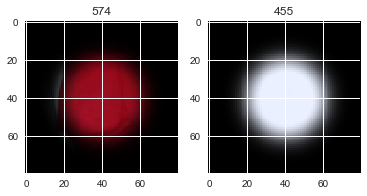

correlation:  -0.8714271575838319
means:  -0.19046260442146898  ,  -0.2905123846183401


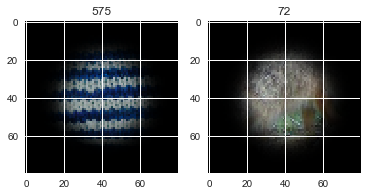

correlation:  -0.8419087414754935
means:  0.42453812450286  ,  0.9745456262467417


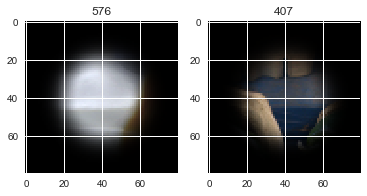

correlation:  -0.8336472043196189
means:  0.3181036971366125  ,  -0.11450134992049357


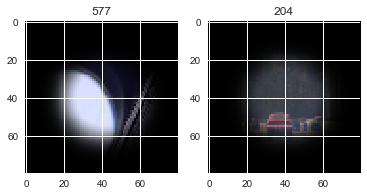

correlation:  -0.8251095237039201
means:  0.6826087786561285  ,  -0.4732293381018309


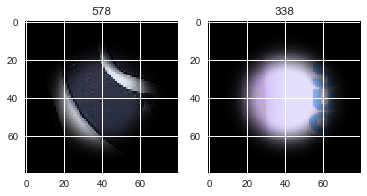

correlation:  -0.7864924227368477
means:  -0.1148928097323958  ,  -0.4128563184194697


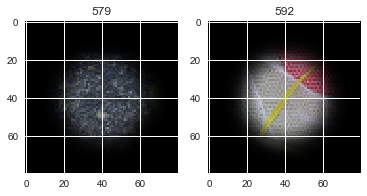

correlation:  -0.8238185676023769
means:  -0.5625802181765039  ,  0.0045489991908873074


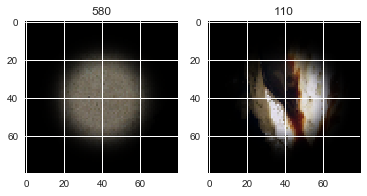

correlation:  -0.7051988005913642
means:  0.2532508654138547  ,  0.19786491773828832


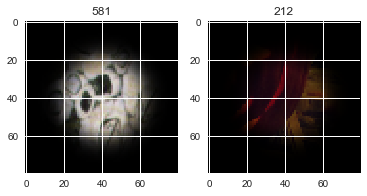

correlation:  -0.7513755800625385
means:  -0.20650664318926654  ,  -0.019161570332831553


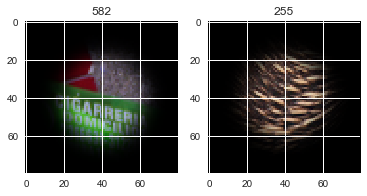

correlation:  -0.8794232899985179
means:  0.0447607037522935  ,  -0.23870946017719818


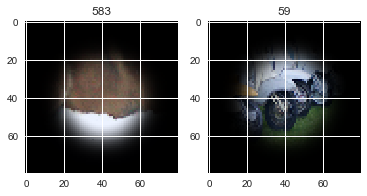

correlation:  -0.790149424239059
means:  -0.48297140908619035  ,  0.5419970540058835


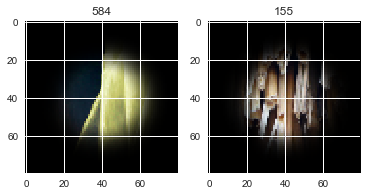

correlation:  -0.8458678031112769
means:  -0.6822192025815755  ,  -0.15149955474324608


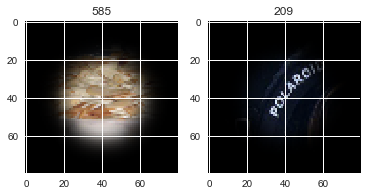

correlation:  -0.7674908095887714
means:  -0.001262896038482685  ,  -0.48688095256338815


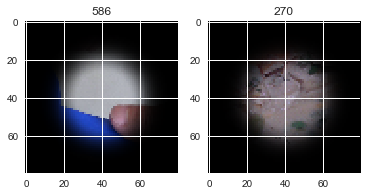

correlation:  -0.7615457597032818
means:  0.13593330655445476  ,  -0.09364482857978879


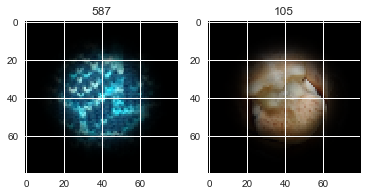

correlation:  -0.8275118146212639
means:  -0.11584481382573077  ,  0.03145066062417047


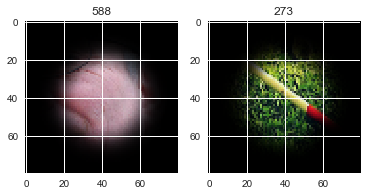

correlation:  -0.8927751561969204
means:  -0.06094974842433727  ,  -0.3228741210175776


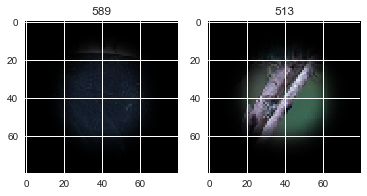

correlation:  -0.7706859727757753
means:  -0.07799501091751017  ,  -0.14953376963315793


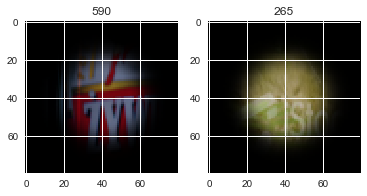

correlation:  -0.6676618612102955
means:  0.25922384554585337  ,  0.2798585618935452


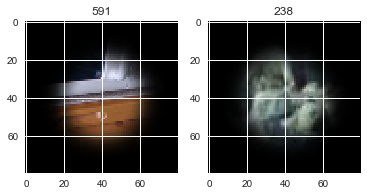

correlation:  -0.8947880845259497
means:  -0.4128563184194697  ,  0.04747568251088071


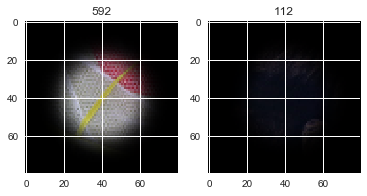

correlation:  -0.7427870630393926
means:  0.1392162748667736  ,  -0.30537901799686984


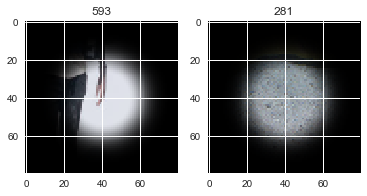

correlation:  -0.8209661744177795
means:  -0.9328859918299078  ,  0.22201016215001768


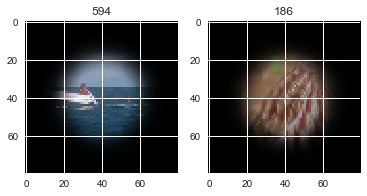

correlation:  -0.7537287044896605
means:  -0.05677662766849905  ,  -0.3260227659506527


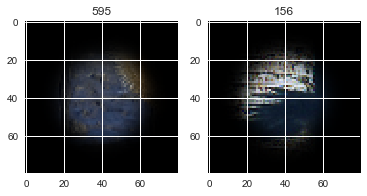

correlation:  -0.8609326490009347
means:  0.12708082282781605  ,  -0.6446014672923197


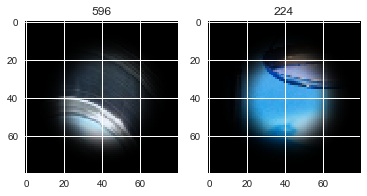

correlation:  -0.8353313422222742
means:  -0.0005628230205766769  ,  0.11660906857447878


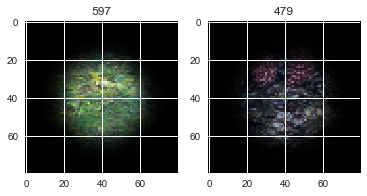

correlation:  -0.8383948183065605
means:  0.05135633855604887  ,  -0.24293214606215152


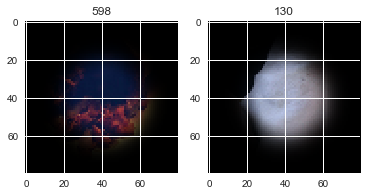

correlation:  -0.8276938322187359
means:  -0.13341370742542982  ,  0.9903468847300657


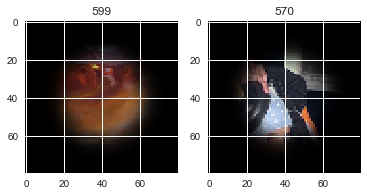

correlation:  -0.9996224900997146
means:  -1.4652639591358443  ,  -0.08096792232843485


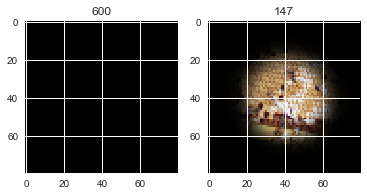

In [27]:
# and lowest correlation
min_corrs = corrs.idxmin()

for idx, idx2 in min_corrs.iteritems():
    print("correlation: ", corrs[idx][idx2])
    print("means: " , sorted_means[idx], " , ", sorted_means[idx2])
    plt.figure()
    plt.subplot(1,2,1)
    plt.imshow(stim[idx])
    plt.title(str(idx))
    
    plt.subplot(1,2,2)
    plt.imshow(stim[idx2])
    plt.title(str(idx2))
    plt.show()

### Checking Stimuli Properties

For each image, we can try to find the variance

Predictions: neurons may be reacting to the sharpness of the image: edge detection?

-- straight lines?
    